# Data Description 
In this competition you are predicting the probability that an online transaction is fraudulent, as denoted by the binary target `isFraud`.

The data is broken into two files `identity` and `transaction`, which are joined by `TransactionID`. Not all transactions have corresponding identity information.

### Categorical Features - Transaction

- `ProductCD`
- `card1` - `card6`
- `addr1`, `addr2`
- `P_emaildomain`
- `R_emaildomain`
- `M1` - `M9`

### Categorical Features - Identity

- `DeviceType`
- `DeviceInfo`
- `id_12` - `id_38`

The `TransactionDT` feature is a timedelta from a given reference datetime (not an actual timestamp).

You can read more about the data from [this post by the competition host](https://www.kaggle.com/competitions/ieee-fraud-detection/discussion/101203).




### Transaction Table 

- TransactionDT: timedelta from a given reference datetime (not an actual timestamp)
- TransactionAMT: transaction payment amount in USD
- ProductCD: product code, the product for each transaction
- card1 - card6: payment card information, such as card type, card category, issue bank, country, etc.
- addr: address
- dist: distance
- P_ and (R__) emaildomain: purchaser and recipient email domain
- C1-C14: counting, such as how many addresses are found to be associated with the payment card, etc. The actual meaning is masked.
- D1-D15: timedelta, such as days between previous transaction, etc.
- M1-M9: match, such as names on card and address, etc.
- Vxxx: Vesta engineered rich features, including ranking, counting, and other entity relations

--- 
##### Categorical Features:
- ProductCD
- card1 - card6
- addr1, addr2
- P_emaildomain
- R_emaildomain
- M1 - M9



 Identity Table
Variables in this table are identity information – network connection information (IP, ISP, Proxy, etc) and digital signature (UA/browser/os/version, etc) associated with transactions.
They're collected by Vesta’s fraud protection system and digital security partners.
(The field names are masked and pairwise dictionary will not be provided for privacy protection and contract agreement)

Categorical Features:
- DeviceType
- DeviceInfo
- id_12 - id_38

# 0. Import Library and Model

In [1]:
# Importing general libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

# Importing libraries for Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_auc_score, roc_curve, auc
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, OrdinalEncoder, LabelEncoder,MinMaxScaler,FunctionTransformer

# Models
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier, callback
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier,Pool
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import RocCurveDisplay

# Model 
from mrmr import mrmr_classif 

warnings.filterwarnings('ignore')
sns.set_palette("pastel") 


# 1. Load, Transform, Combine Data

In [2]:
train_transaction = pd.read_csv('datasets/train_transaction.csv')
train_identity = pd.read_csv('datasets/train_identity.csv')
test_transaction = pd.read_csv('datasets/test_transaction.csv')
test_identity = pd.read_csv('datasets/test_identity.csv')

sample_submission = pd.read_csv('datasets/sample_submission.csv')

In [3]:
df_train = pd.merge(train_transaction, train_identity, on='TransactionID', how='left')
df_test = pd.merge(test_transaction, test_identity, on='TransactionID', how='left') 

print(df_train.shape)
print(df_test.shape)


(590540, 434)
(506691, 433)


In [4]:
df_train.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M


In [170]:
df_test.head()

,TransactionID,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,...,id-31,id-32,id-33,id-34,id-35,id-36,id-37,id-38,DeviceType,DeviceInfo
0,3663549,18403224,31.95,W,10409,111.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3663550,18403263,49.00,W,4272,111.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3663551,18403310,171.00,W,4476,574.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3663552,18403310,284.95,W,10989,360.0,150.0,visa,166.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3663553,18403317,67.95,W,18018,452.0,150.0,mastercard,117.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [171]:
different_cols = []
for col in df_train.columns:
    if (col not in df_test.columns):
        different_cols.append(col)
print(different_cols)


['isFraud', 'id_01', 'id_02', 'id_03', 'id_04', 'id_05', 'id_06', 'id_07', 'id_08', 'id_09', 'id_10', 'id_11', 'id_12', 'id_13', 'id_14', 'id_15', 'id_16', 'id_17', 'id_18', 'id_19', 'id_20', 'id_21', 'id_22', 'id_23', 'id_24', 'id_25', 'id_26', 'id_27', 'id_28', 'id_29', 'id_30', 'id_31', 'id_32', 'id_33', 'id_34', 'id_35', 'id_36', 'id_37', 'id_38']


Comment : `id` columns in test set have different name with train set

In [5]:
df_test.rename(columns=lambda c: ('id_' + c[3:]) if c.startswith('id-') else c, inplace=True)
df_test.head()


,TransactionID,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,3663549,18403224,31.95,W,10409,111.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3663550,18403263,49.00,W,4272,111.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3663551,18403310,171.00,W,4476,574.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3663552,18403310,284.95,W,10989,360.0,150.0,visa,166.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3663553,18403317,67.95,W,18018,452.0,150.0,mastercard,117.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
sampled = df_test.sample(n=4, random_state=42)
sampled.drop(columns=["TransactionID"], inplace=True)
sampled.to_csv("sample_data.csv", index=False)

# 2. EDA

In [165]:
ID_COLS = ['TransactionID', 'TransactionDT']
TARGET = 'isFraud'

### Helper Function

In [173]:
def value_count_df(df, col):
    counts = df[col].value_counts(dropna= False)
    percent = df[col].value_counts(dropna= False, normalize= True) * 100

    return pd.DataFrame({col: counts.index, "count": counts.values, "percent": percent.values.round(2)})

def check_missing_values(df,cols = None):
    if cols is None:
        cols = df.columns
    missing = df[cols].isnull().sum()
    missing_percent = (df[cols].isnull().sum() / len(df)) * 100
    
    result = pd.DataFrame({
        'missing_count': missing,
        'missing_percent': missing_percent.round(2)
    })
    return result.sort_values('missing_percent', ascending=False)

def check_unique_values(df, col):
    unique_values = df[col].nunique()
    result = pd.DataFrame({
        'unique_values': unique_values
    })
    return result


def visualize_categorical_features(df, col):
    top_n = df_train[col].value_counts().index[:10] # Top 10 for high cardinality
    df_top = df_train[df_train[col].isin(top_n)]

    # Precompute counts (ordered) for reuse
    counts = df_top[col].value_counts().reindex(top_n, fill_value=0)

    # Build the 1x3 layout for this column
    fig, axs = plt.subplots(1, 3, figsize=(16, 6))

    # 1) PIE of top 10 distribution
    counts.plot(kind='pie', ax=axs[0], autopct='%.2f%%', ylabel='')
    axs[0].set_title(f'{col}: Top 10 Distribution (Pie)')

    # 2) BAR of top 10 distribution
    counts.plot(kind='bar', ax=axs[1])
    axs[1].set_title(f'{col}: Top 10 Distribution (Bar)')
    axs[1].set_xlabel(col)
    axs[1].set_ylabel('Count')

    # 3) Stacked bar: Fraud proportions within each of the top 10 categories
    # Normalize by row to get proportions; reindex to keep the same order as top_n
    ct = (
        pd.crosstab(df_top[col], df_top['isFraud'], normalize='index')
        .reindex(top_n)
        .fillna(0)
    )

    # Choose the two columns present in this order preference
    col_order = [c for c in [0, 1, False, True] if c in ct.columns][:2]
    ct = ct[col_order]

    # Convert to percentage for plotting/labels
    ct_pct = ct * 100.0

    ct_pct.plot(kind='bar', stacked=True, ax=axs[2])
    axs[2].set_title(f'{col}: Fraud Proportion (Top 10)')
    axs[2].set_xlabel(col)
    axs[2].set_ylabel('Percentage')
    # Legend labels
    legend_labels = ['Not Fraud', 'Fraud'] if len(col_order) == 2 else [str(c) for c in col_order]
    axs[2].legend(legend_labels, title='isFraud', loc='best')

    # Add percentage labels on each stacked segment
    for container in axs[2].containers:
        axs[2].bar_label(container, fmt="%.1f%%", label_type='center')


    plt.tight_layout()
    plt.show()

## 2.1 Overview 

In [174]:
missing_pct = (df_train.isnull().sum() / len(df_train)) * 100
missing_pct = missing_pct.sort_values(ascending=False)
print(f"\nColumns with >50% missing: {(missing_pct > 50).sum()}")
print(f"Columns with >90% missing: {(missing_pct > 90).sum()}")
print(missing_pct[missing_pct > 90])


Columns with >50% missing: 214
Columns with >90% missing: 12
id_24    99.196159
id_25    99.130965
id_07    99.127070
id_08    99.127070
id_21    99.126393
id_26    99.125715
id_27    99.124699
id_23    99.124699
id_22    99.124699
dist2    93.628374
D7       93.409930
id_18    92.360721
dtype: float64


['TransactionID', 'TransactionDT', 'TransactionAmt', 'card1', 'card2', 'card3', 'card5', 'addr1', 'addr2', 'dist1', 'dist2', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52', 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', 'V74', 'V75', 'V76', 'V77', 'V78', 'V79', 'V80', 'V81', 'V82', 'V83', 'V84', 'V85', 'V86', 'V87', 'V88', 'V89', 'V90', 'V91', 'V92', 'V93', 'V94', 'V95', 'V96', 'V97', 'V98', 'V99', 'V100'

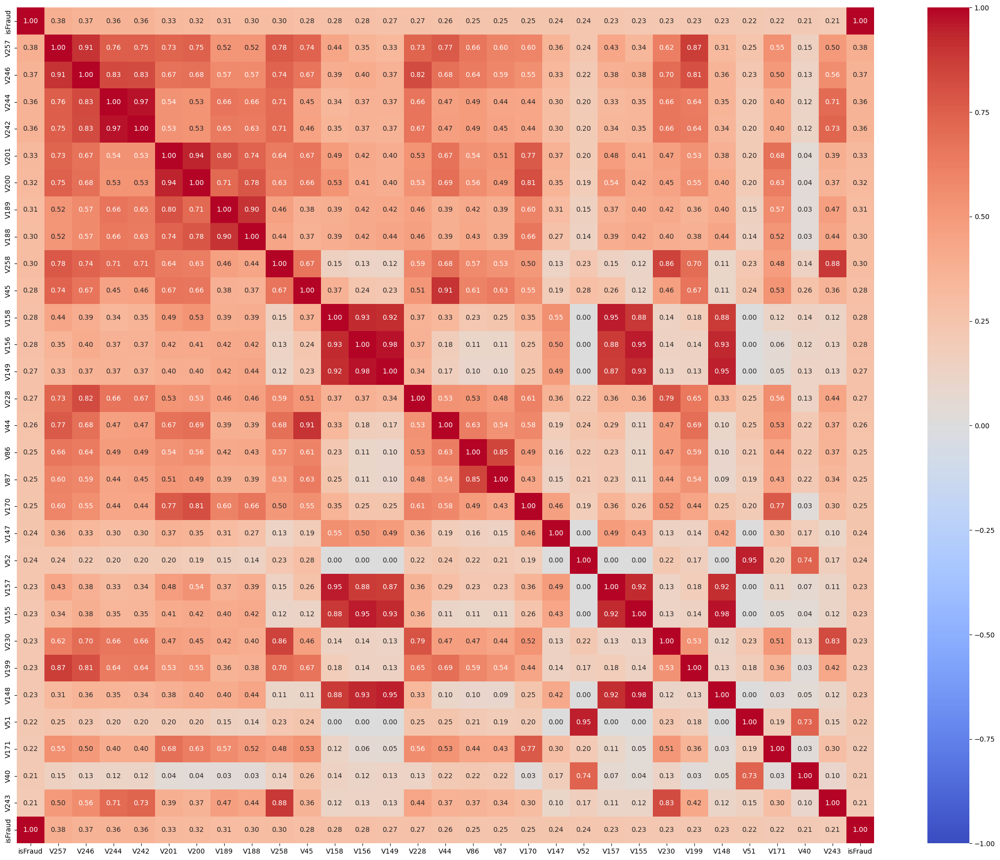

In [175]:
num_cols = [c for c in df_train.columns if df_train[c].dtype in ['float32','float64','int64','int32'] and c != 'isFraud']
print(num_cols)
print(len(num_cols))

# Correlation with isFraud
num_cols_top_30 = df_train[num_cols + ['isFraud']].corr()['isFraud'].abs().sort_values(ascending=False).head(30).index.tolist()
print(num_cols_top_30)

missing_percentages = df_train[num_cols_top_30].isnull().mean() * 100

# Create a DataFrame with missing percentages for the top 30 correlated features
missing_df = pd.DataFrame({
    'Feature': num_cols_top_30,
    'Missing_Percentage': [missing_percentages.get(col, 0) for col in num_cols_top_30]
}) 


# Top correlated plot
plt.figure(figsize=(28, 22))
sns.heatmap(df_train[num_cols_top_30+ ['isFraud']].corr().fillna(0).abs(), annot=True, cmap='coolwarm', vmin=-1, vmax=1, fmt='.2f')
plt.show()

In [176]:
missing_percentages = df_train[num_cols].isnull().mean() * 100

# Calculate correlations with isFraud, excluding self-correlation from the result
correlations = df_train[num_cols + ['isFraud']].corr().loc[num_cols, 'isFraud'].abs()

# Create a DataFrame with aligned lengths
feature_stats = pd.DataFrame({
    "Feature": num_cols,
    "Missing_Percentage": missing_percentages,
    "Correlation_with_isFraud": correlations
})

# Display the DataFrame to verify
print(feature_stats)

# Define thresholds
threshold_missing = 70
threshold_corr = 0.01

# Identify columns to drop: >70% missing and correlation <0.01
cols_to_drop = feature_stats[
    (feature_stats['Missing_Percentage'] > threshold_missing) & 
    (feature_stats['Correlation_with_isFraud'] < threshold_corr)
]['Feature'].tolist()

print(f"\nColumns to drop (>{threshold_missing}% missing and corr <{threshold_corr}):")
print(cols_to_drop)
print(f"Number of columns to drop: {len(cols_to_drop)}")

cols_to_drop_not_v = [col for col in cols_to_drop if col[0] != 'V']
print(cols_to_drop_not_v)

                       Feature  Missing_Percentage  Correlation_with_isFraud
TransactionID    TransactionID            0.000000                  0.014166
TransactionDT    TransactionDT            0.000000                  0.013103
TransactionAmt  TransactionAmt            0.000000                  0.011320
card1                    card1            0.000000                  0.013640
card2                    card2            1.512683                  0.003388
...                        ...                 ...                       ...
id_22                    id_22           99.124699                  0.118409
id_24                    id_24           99.196159                  0.001905
id_25                    id_25           99.130965                  0.034045
id_26                    id_26           99.125715                  0.099587
id_32                    id_32           86.861855                  0.069702

[402 rows x 3 columns]

Columns to drop (>70% missing and corr <0.01):
['D1

In [177]:
cat_cols = ['ProductCD', 'card1', 'card2', 'card3', 'card4', 'card5', 'card6', 'addr1', 'addr2', 'P_emaildomain', 'R_emaildomain', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'DeviceType', 'DeviceInfo', 'id_12', 'id_13', 'id_14', 'id_15', 'id_16', 'id_17', 'id_18', 'id_19', 'id_20', 'id_21', 'id_22', 'id_23', 'id_24', 'id_25', 'id_26', 'id_27', 'id_28', 'id_29', 'id_30', 'id_31', 'id_32', 'id_33', 'id_34', 'id_35', 'id_36', 'id_37', 'id_38']
print("Categorical Columns:", cat_cols)
print(len(cat_cols))

missing_cat = df_train[cat_cols].isnull().sum()
print("\nMissing Values in Categorical Columns:")
print(missing_cat[missing_cat > 0])

Categorical Columns: ['ProductCD', 'card1', 'card2', 'card3', 'card4', 'card5', 'card6', 'addr1', 'addr2', 'P_emaildomain', 'R_emaildomain', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'DeviceType', 'DeviceInfo', 'id_12', 'id_13', 'id_14', 'id_15', 'id_16', 'id_17', 'id_18', 'id_19', 'id_20', 'id_21', 'id_22', 'id_23', 'id_24', 'id_25', 'id_26', 'id_27', 'id_28', 'id_29', 'id_30', 'id_31', 'id_32', 'id_33', 'id_34', 'id_35', 'id_36', 'id_37', 'id_38']
49

Missing Values in Categorical Columns:
card2              8933
card3              1565
card4              1577
card5              4259
card6              1571
addr1             65706
addr2             65706
P_emaildomain     94456
R_emaildomain    453249
M1               271100
M2               271100
M3               271100
M4               281444
M5               350482
M6               169360
M7               346265
M8               346252
M9               346252
DeviceType       449730
DeviceInfo       471874
id_12      

## 2.2 Target (isFraud)

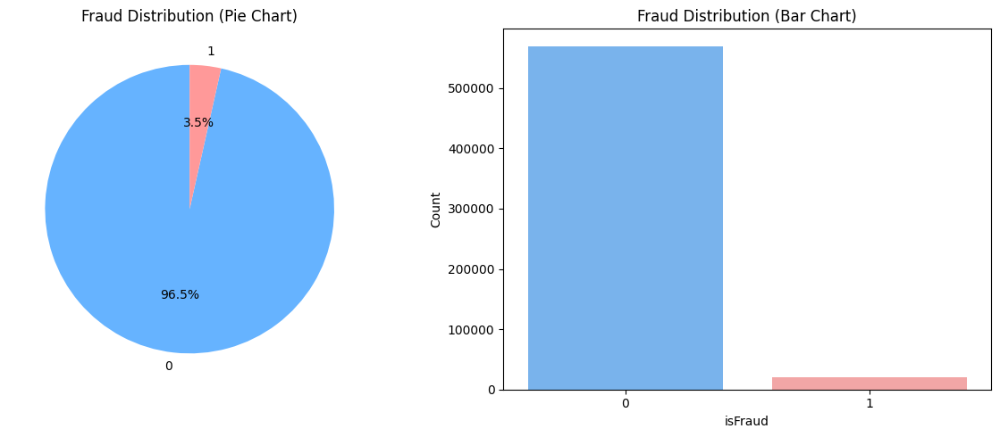

In [178]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Pie chart
df_train['isFraud'].value_counts().plot.pie(
    ax=axes[0],
    autopct='%1.1f%%',
    startangle=90,
    colors=['#66b3ff', '#ff9999']
)
axes[0].set_title('Fraud Distribution (Pie Chart)')
axes[0].set_ylabel('')

# Bar chart
sns.countplot(x='isFraud', data=df_train, palette=['#66b3ff', '#ff9999'], ax=axes[1])
axes[1].set_title('Fraud Distribution (Bar Chart)')
axes[1].set_xlabel('isFraud')
axes[1].set_ylabel('Count')

plt.tight_layout()
plt.show()

3.5% is fraud -> Highly Imbalanced

## 2.3 Univariate Analysis

### 2.3.1 Categorical Features

- `ProductCD`
- `card1` - `card6`
- `addr1`, `addr2`
- `P_emaildomain`
- `R_emaildomain`
- `M1` - `M9`
- `DeviceType`
- `DeviceInfo`
- `id_12` - `id_38`

#### 2.3.1.1 ProductCD

ProductCD --------------------------------


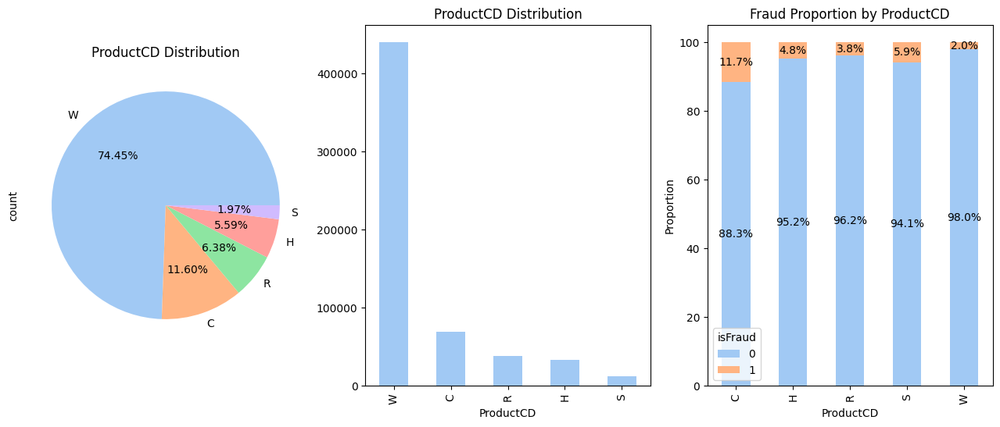

In [205]:
# ProductCD 
print("ProductCD --------------------------------")
fig, axs = plt.subplots(1, 3, figsize=(16,6))
# Pie chart
df_train['ProductCD'].value_counts(dropna=False).plot(
    kind='pie',
    ax=axs[0],
    autopct='%.2f%%',
)
axs[0].set_title('ProductCD Distribution')

# Bar chart
df_train['ProductCD'].value_counts(dropna=False).plot(
    kind='bar',
    ax=axs[1],
)
axs[1].set_title('ProductCD Distribution')

# Fraud Proportion vs ProductCD
crosstab = pd.crosstab(df_train['ProductCD'], df_train['isFraud'], normalize='index') * 100
crosstab.plot(kind='bar', stacked=True, ax=axs[2])
axs[2].set_title('Fraud Proportion by ProductCD')
axs[2].set_ylabel('Proportion')

for container in axs[2].containers:
    axs[2].bar_label(container, fmt="%.1f%%", label_type='center')

plt.show()


- Even though `W` accounts for the highest percentage (~75%), only 2% of it is `Fraud`.
- 11.7% of `isFraud` cases are associated with `C` (the highest percentage).
- `S` accounts for the lowest percentage overall, but has 5.9% `isFraud`, the second highest.

#### 2.1.2 Card 1-6

In [182]:
card_cols = ['card1', 'card2', 'card3', 'card4', 'card5', 'card6']

In [206]:
df_train[card_cols].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Data columns (total 6 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   card1   590540 non-null  int64  
 1   card2   581607 non-null  float64
 2   card3   588975 non-null  float64
 3   card4   588963 non-null  object 
 4   card5   586281 non-null  float64
 5   card6   588969 non-null  object 
dtypes: float64(3), int64(1), object(2)
memory usage: 27.0+ MB


In [207]:
check_missing_values(df_train, card_cols)

,missing_count,missing_percent
card2,8933,1.51
card5,4259,0.72
card3,1565,0.27
card4,1577,0.27
card6,1571,0.27
card1,0,0.00


In [208]:
check_unique_values(df_train, card_cols)

,unique_values
card1,13553
card2,500
card3,114
card4,4
card5,119
card6,4


- `card1`, `card2`, `card3`, `card5` are numeric but treated as categorical features (high unique values)
- Even `card1` doesnt have any NaN values but it has the most unique values with ~13.5k
- `card2` have the most missing values

card1--------------------------------


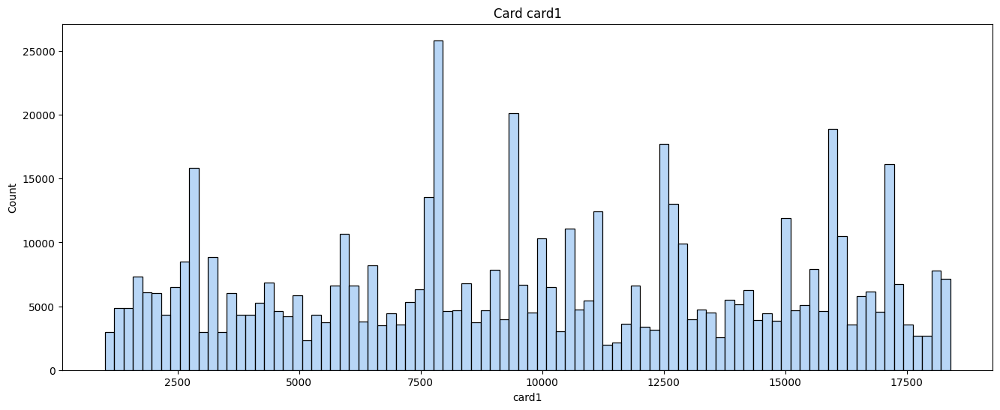

card2--------------------------------


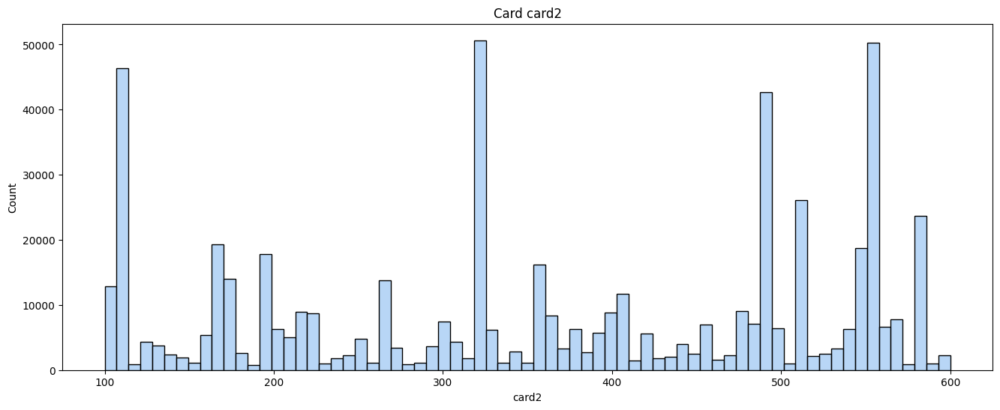

card3--------------------------------


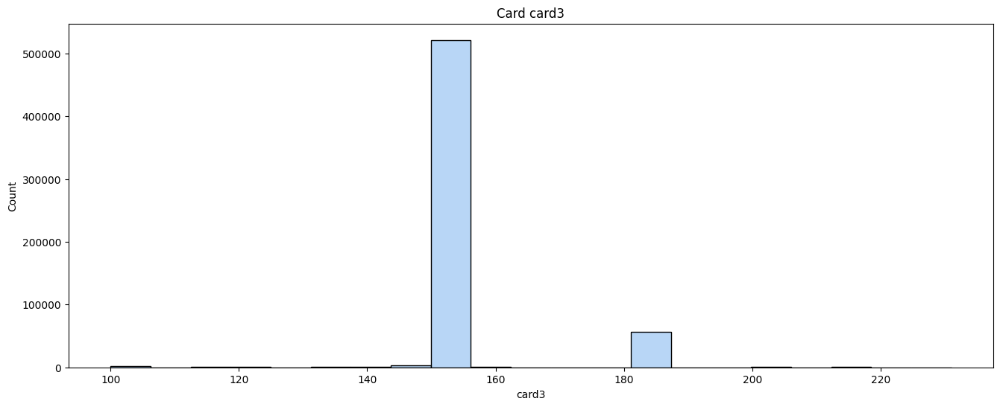

card4--------------------------------


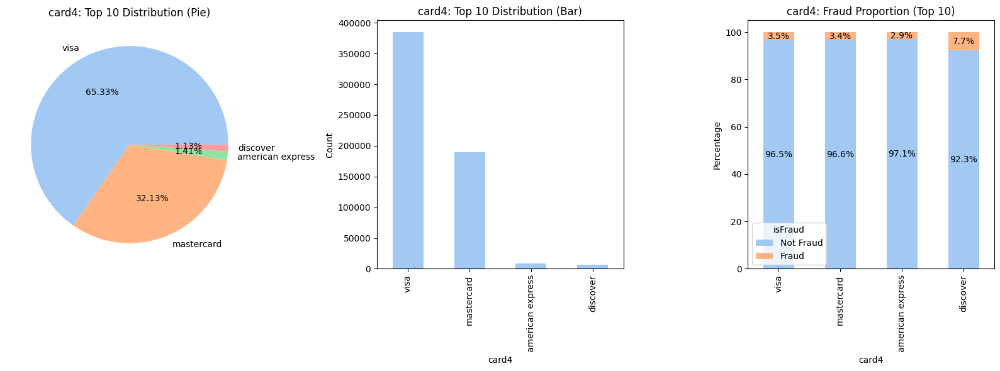

card5--------------------------------


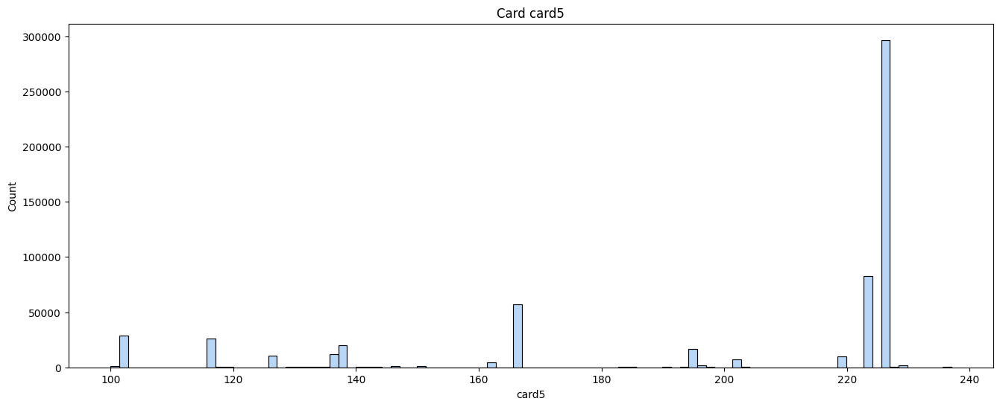

card6--------------------------------


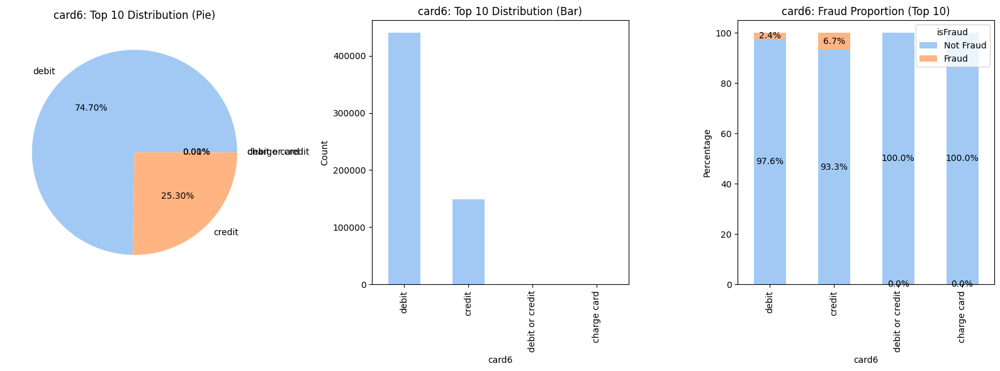

In [209]:
for col in card_cols:
    print(col + "--------------------------------")
    if df_train[col].dtypes in ['int64','float64']:
        fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(16,6))
        sns.histplot(df_train[col])
        axes.title.set_text(f'Card {col}')
        plt.show()
    else:
        visualize_categorical_features(df_train, col)
        

Comment: 
- In `card4`, `visa` dominated with 65% and `mastercard` with 32%
- In `card6`, `debit` 74% and `credit` 25% 

Insights:
- `card4`: `discover` has ~7.7% isFraud vs `american express` has ~2.9%
- `card6`: `credit` has ~6.7% isFraud vs `debit` has ~2.4%

-> `debit` cards are more safer


<Axes: >

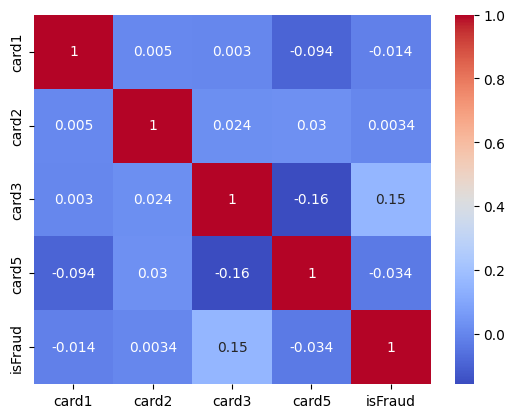

In [210]:
card_cols_numeric = [c for c in card_cols if df_train[c].dtypes in ['int64','float64']]

sns.heatmap(df_train[card_cols_numeric + ['isFraud']].corr(), annot=True, cmap='coolwarm')

- `card1`, `card2`, `card5` has correlations with `isFraud` close to 0 -> Don't need to help predict 
- `card3` has the highest positive correlation (0.15) with fraud, but not enough.
- All numerical cards is not correlated with each others -> Dont lead to **Multicollinearity**

#### 2.1.3 Addr1,Addr2

In [211]:
addr_cols = ['addr1', 'addr2']

check_missing_values(df_train, addr_cols)


,missing_count,missing_percent
addr1,65706,11.13
addr2,65706,11.13


In [212]:
check_unique_values(df_train, addr_cols)

,unique_values
addr1,332
addr2,74


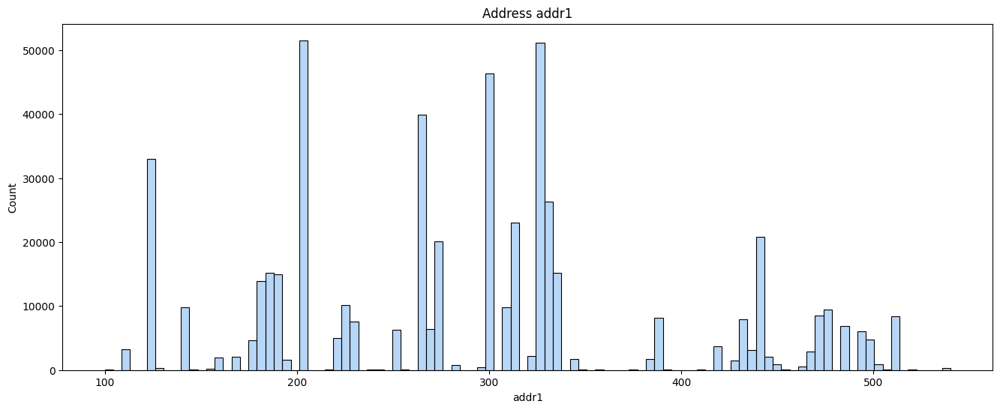

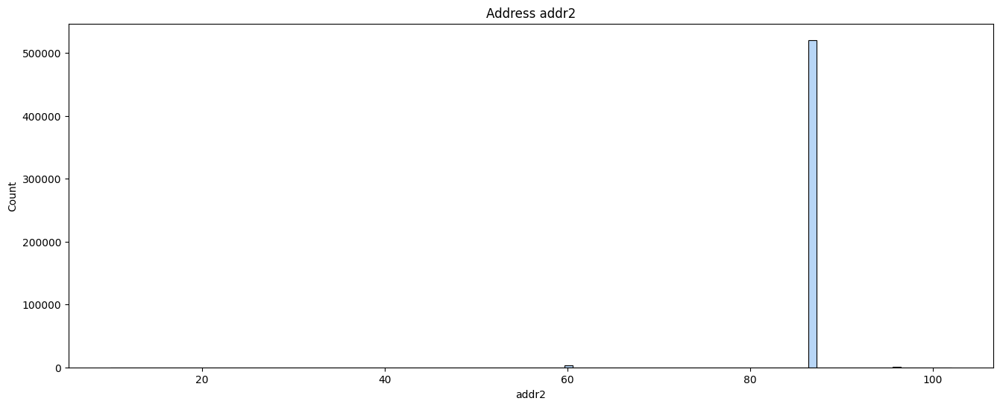

In [213]:
for col in addr_cols:
    if df_train[col].dtypes in ['int64','float64']:
        fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(16,6))
        sns.histplot(df_train[col],bins = 100)
        axes.title.set_text(f'Address {col}')
        plt.show()

Comment: 
- `addr2` almost all `87` with 99% while `addr1` top like `299`, `325`,...


#### 2.1.4 P_email_domain and R_email_domain

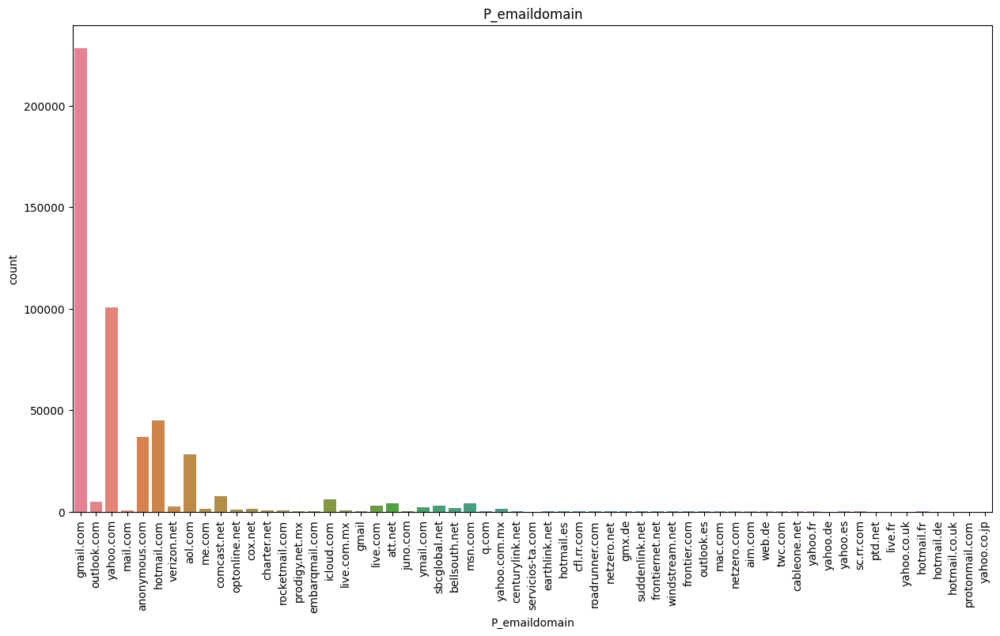

In [214]:
# P_emaildomain
fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(15,8))
sns.countplot(data=df_train, x='P_emaildomain',hue='P_emaildomain', ax=axes)
axes.title.set_text('P_emaildomain')
axes.legend([],[], frameon=False) 
axes.set_xticklabels(axes.get_xticklabels(),rotation=90)
plt.show()

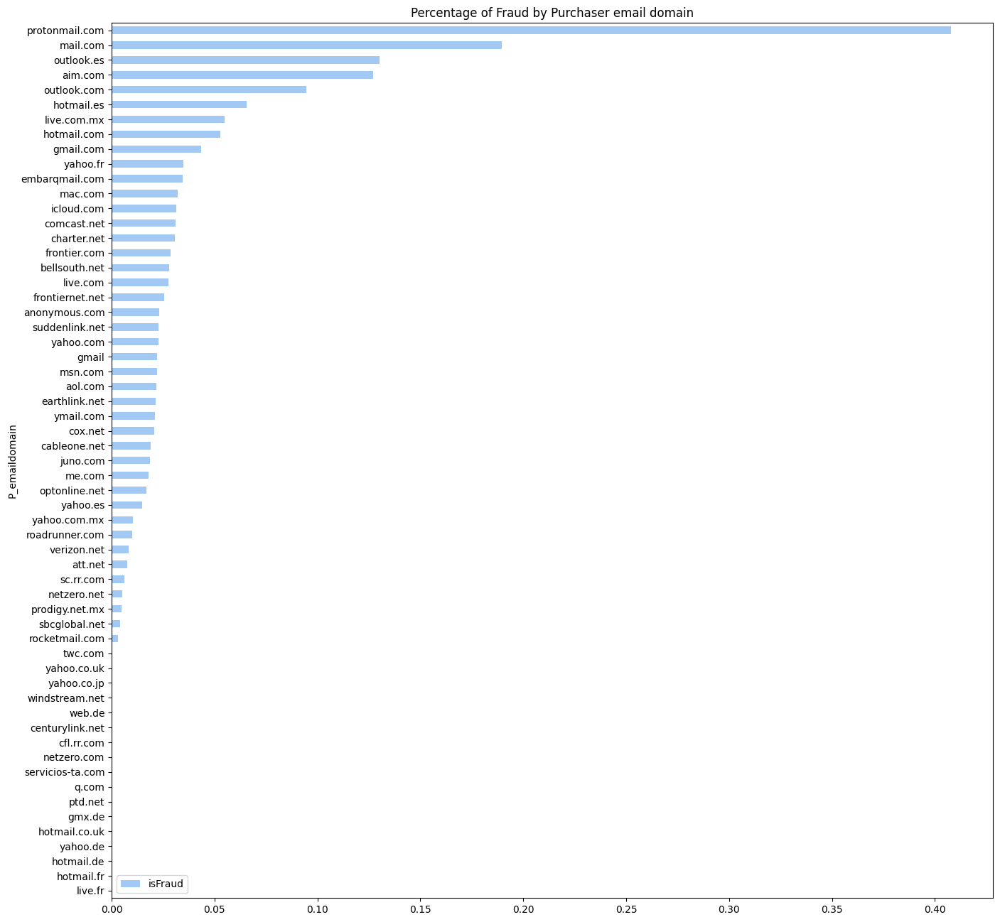

In [215]:
df_train[['P_emaildomain','isFraud']].groupby(by=['P_emaildomain'])  \
    .mean() \
    .sort_values(by=['isFraud']).plot(kind='barh',
            figsize=(16, 16),
            title='Percentage of Fraud by Purchaser email domain') 
plt.show()

- In p email domains most mails are from `gmail.com`
- Among those More fraud transaction comes from domain `protonmail.com` which is more than 40%.

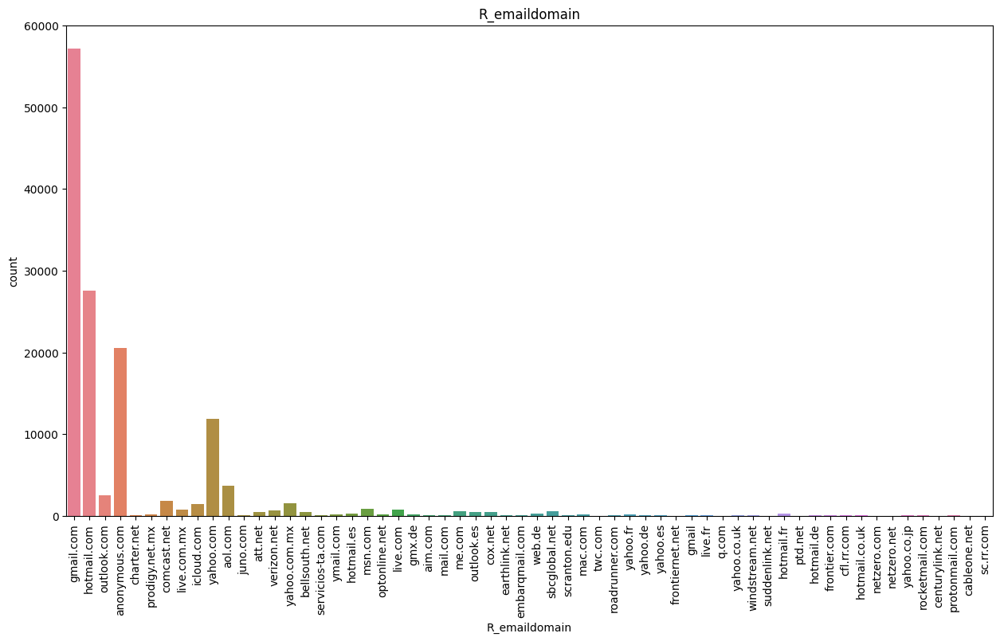

In [216]:
fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(15,8))
sns.countplot(data=df_train, x='R_emaildomain',hue='R_emaildomain', ax=axes)
axes.title.set_text('R_emaildomain')
axes.legend([],[], frameon=False) 
axes.set_xticklabels(axes.get_xticklabels(),rotation=90)
plt.show()

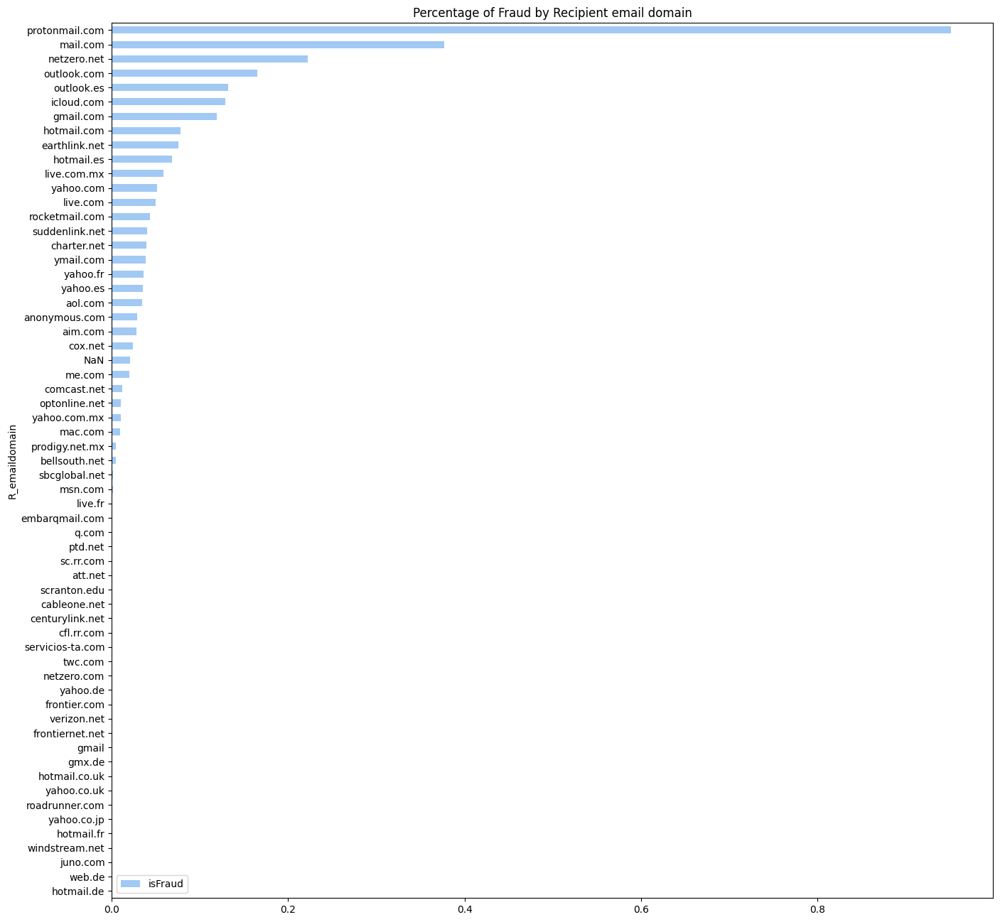

In [197]:
df_train[['R_emaildomain','isFraud']].groupby(by=['R_emaildomain'])  \
    .mean() \
    .sort_values(by=['isFraud']).plot(kind='barh',
            figsize=(16, 16),
            title='Percentage of Fraud by Recipient email domain') 
plt.show()

- In recipent email domains most mails are from `gmail.com`
- Among those More fraud transaction comes from domain `protonmail.com` which is more than 90% which is a serious issue.
- Some email come from the same domain or company like `yahoo.com` , `yahoo.de`, `yahoo.fr` -> We can group it together in **Feature Engineering**

#### 2.1.5 M1-M9

In [217]:
m_cols = [m for m in df_train.columns if m[0] == 'M']

In [218]:
check_missing_values(df_train,m_cols)

,missing_count,missing_percent
M5,350482,59.35
M7,346265,58.64
M8,346252,58.63
M9,346252,58.63
M4,281444,47.66
M1,271100,45.91
M2,271100,45.91
M3,271100,45.91
M6,169360,28.68


In [219]:
check_unique_values(df_train, m_cols)

,unique_values
M1,2
M2,2
M3,2
M4,3
M5,2
M6,2
M7,2
M8,2
M9,2


M1--------------------------------


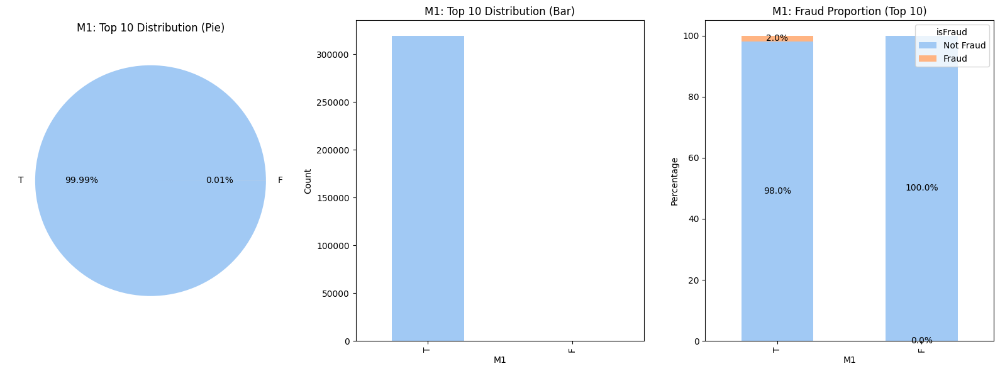

M2--------------------------------


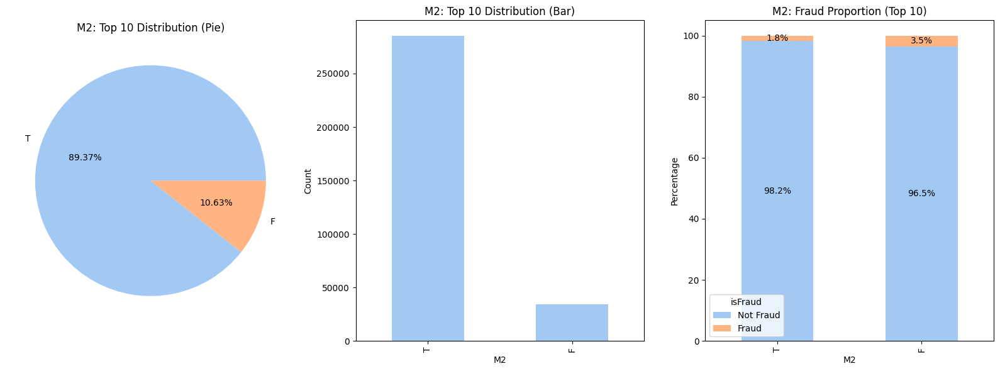

M3--------------------------------


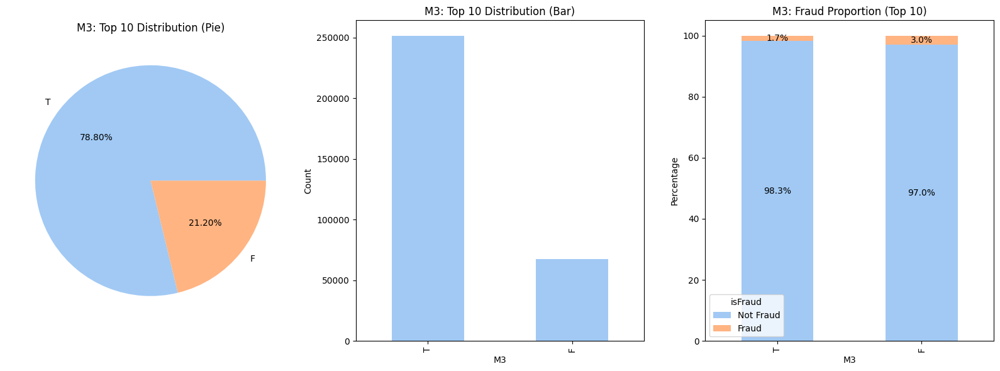

M4--------------------------------


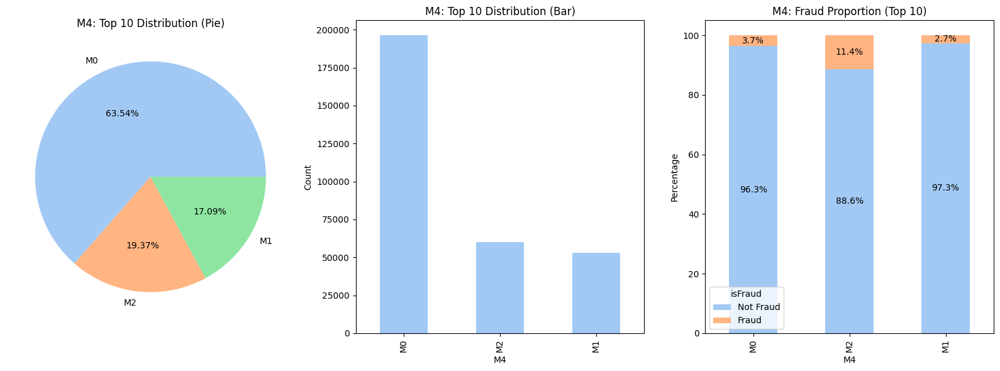

M5--------------------------------


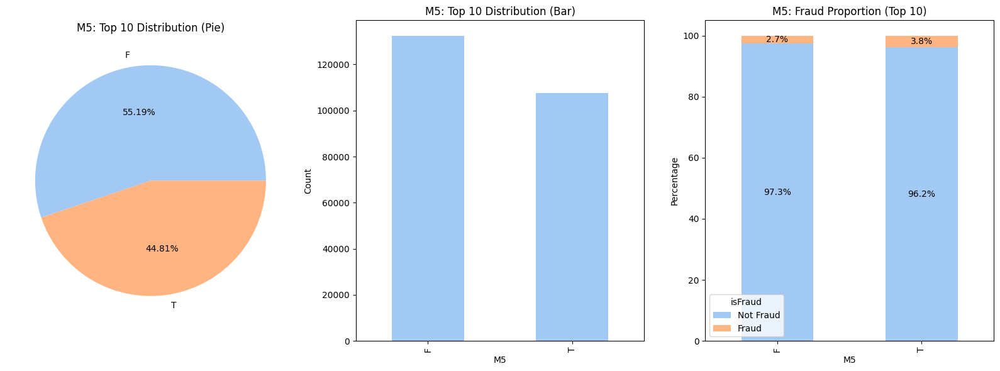

M6--------------------------------


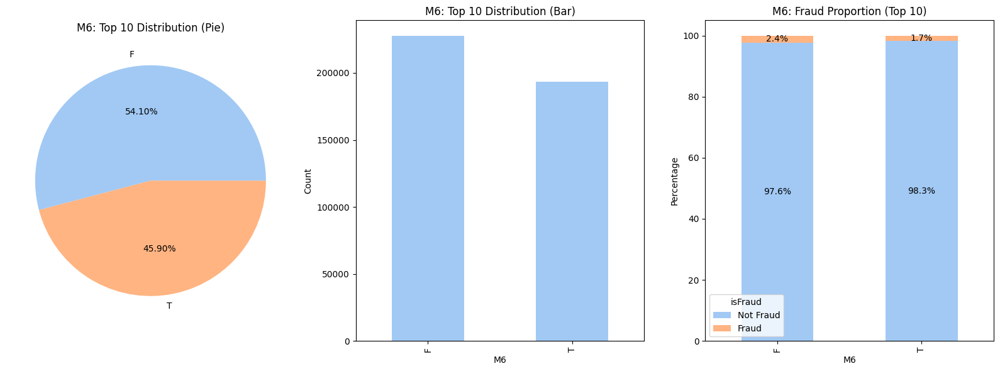

M7--------------------------------


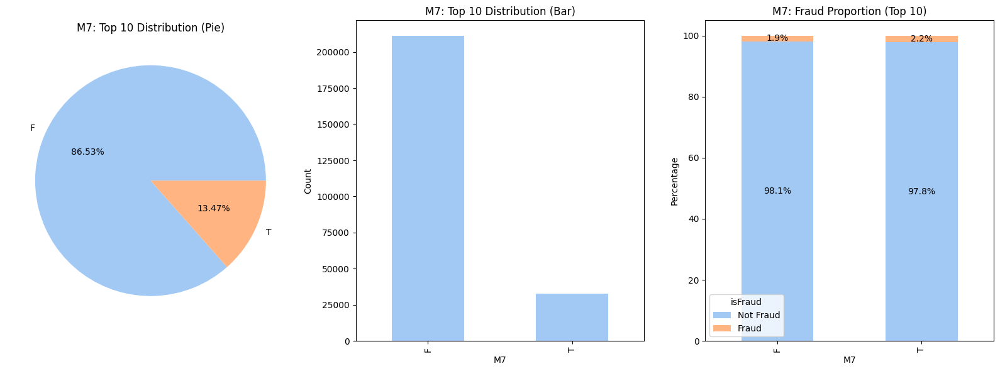

M8--------------------------------


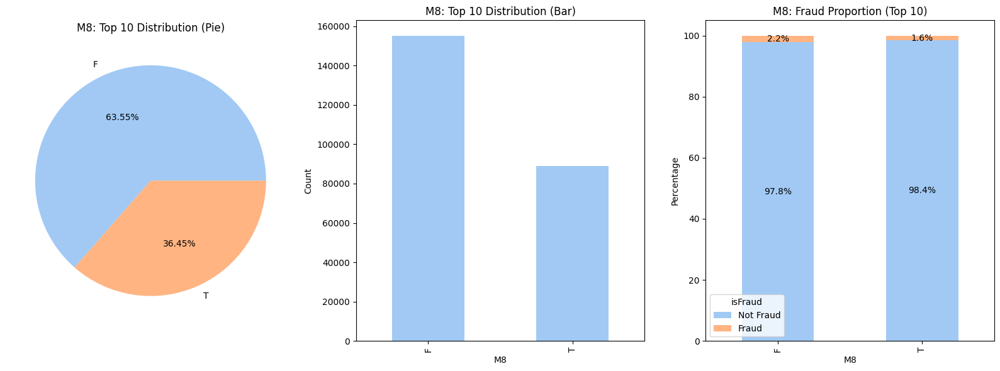

M9--------------------------------


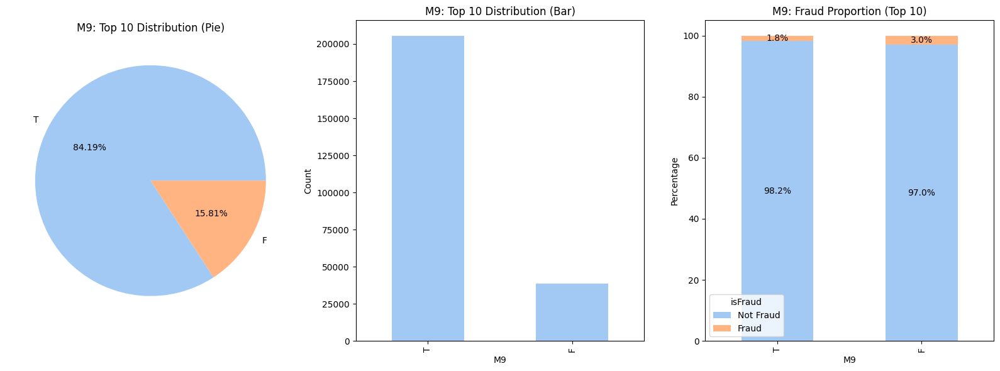

In [220]:
for col in m_cols:
    print(col + "--------------------------------")
    visualize_categorical_features(df_train, col)

Comment:
- `M1` 

#### 2.1.6 DeviceInfo, DeviceType

In [221]:
device_cols = ['DeviceInfo','DeviceType']

In [222]:
check_missing_values(df_train, device_cols)

,missing_count,missing_percent
DeviceInfo,471874,79.91
DeviceType,449730,76.16


In [223]:
check_unique_values(df_train, device_cols)

,unique_values
DeviceInfo,1786
DeviceType,2


DeviceInfo--------------------------------


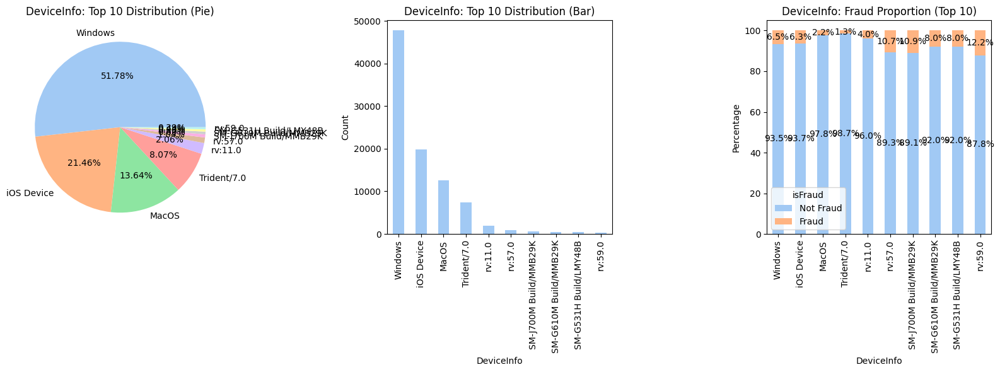

DeviceType--------------------------------


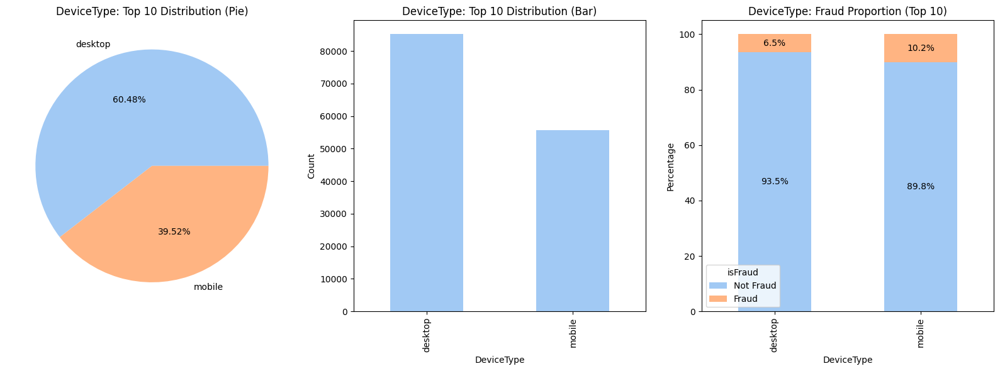

In [224]:

for col in device_cols:
    print(col + "--------------------------------")
    visualize_categorical_features(df_train, col)


Comment :
- We can see that fraud transaction are mostly made on mobile transactions which is roughly about 10% while only 6.2% fraud in desktop trasactions.

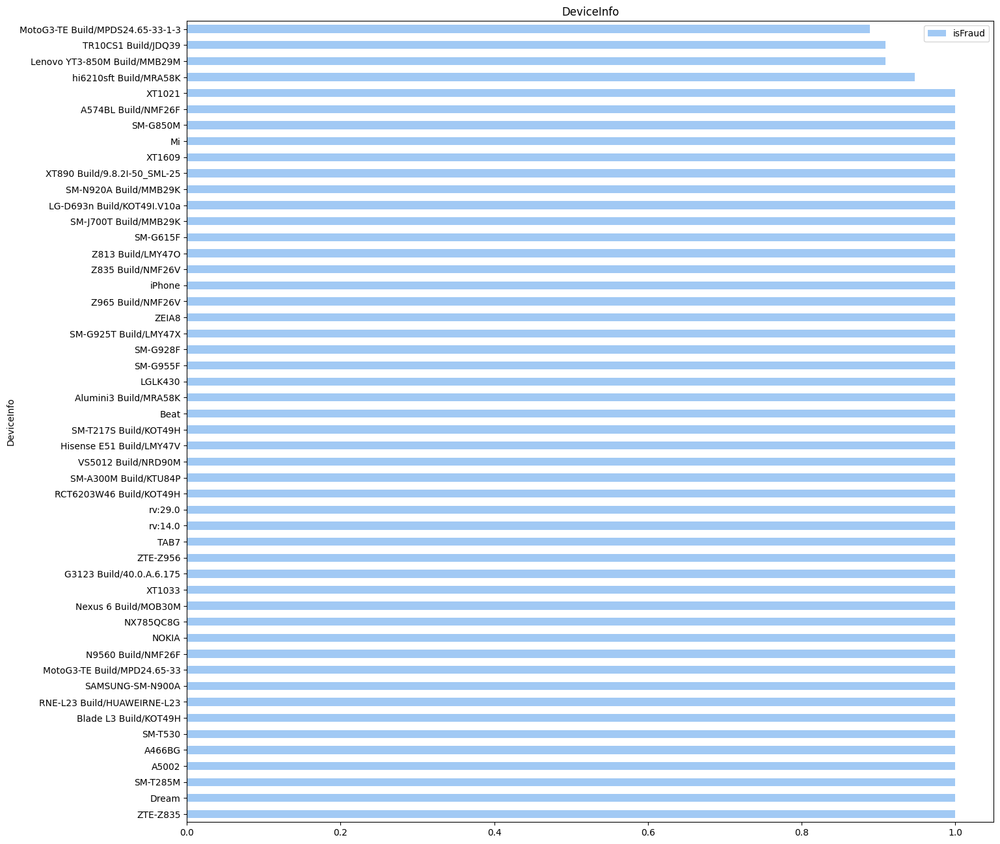

In [225]:
device_info = df_train[['DeviceInfo','isFraud']].groupby(by=['DeviceInfo']).mean().sort_values(by='isFraud',ascending=False)
device_info.head(50).plot(kind='barh', figsize=(16, 16), title='DeviceInfo')
plt.show()

In [226]:
print(device_info[device_info['isFraud'] > 0.9].shape)
device_info[device_info['isFraud'] > 0.9]

(49, 1)


,isFraud
DeviceInfo,
ZTE-Z835,1.000000
Dream,1.000000
SM-T285M,1.000000
A5002,1.000000
A466BG,1.000000
SM-T530,1.000000
Blade L3 Build/KOT49H,1.000000
RNE-L23 Build/HUAWEIRNE-L23,1.000000
SAMSUNG-SM-N900A,1.000000


#### 2.1.7 Id 12-38

In [227]:
id_cols = ['id_'+str(i) for i in range(12,39)]
df_train[id_cols].head(5)

,id_12,id_13,id_14,id_15,id_16,id_17,id_18,id_19,id_20,id_21,...,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NotFound,NaN,-480.0,New,NotFound,166.0,NaN,542.0,144.0,NaN,...,NotFound,Android 7.0,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T


In [228]:
check_missing_values(df_train,id_cols)

,missing_count,missing_percent
id_24,585793,99.20
id_25,585408,99.13
id_21,585381,99.13
id_26,585377,99.13
id_27,585371,99.12
id_22,585371,99.12
id_23,585371,99.12
id_18,545427,92.36
id_33,517251,87.59
id_30,512975,86.87


In [229]:
check_unique_values(df_train,id_cols)

,unique_values
id_12,2
id_13,54
id_14,25
id_15,3
id_16,2
id_17,104
id_18,18
id_19,522
id_20,394
id_21,490


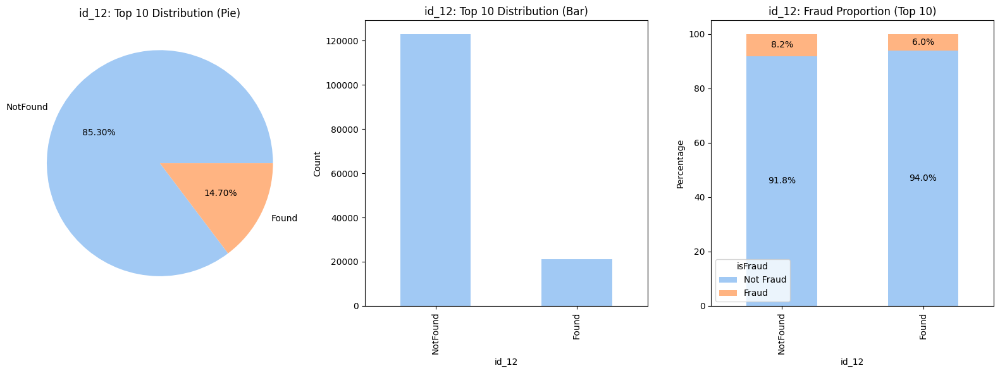

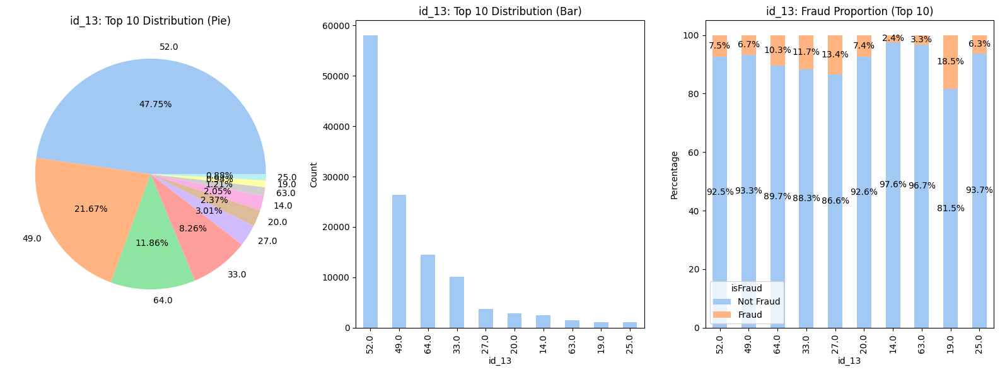

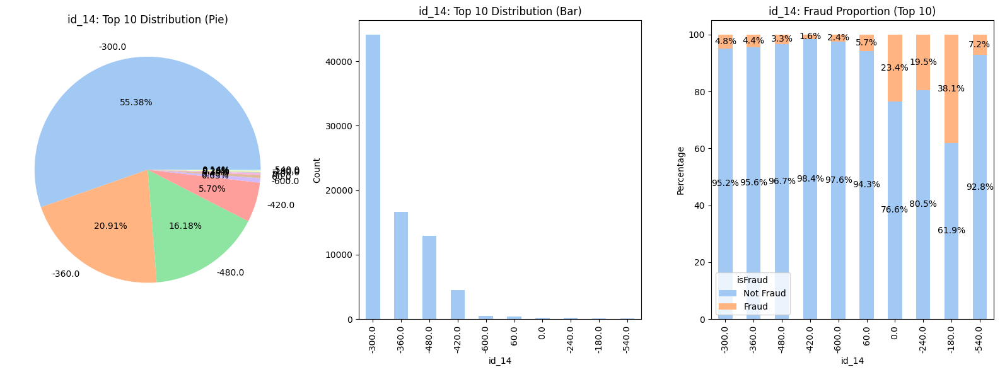

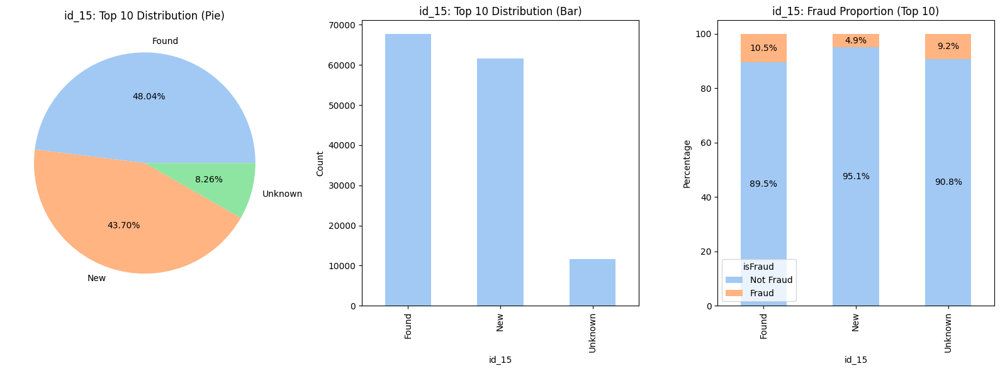

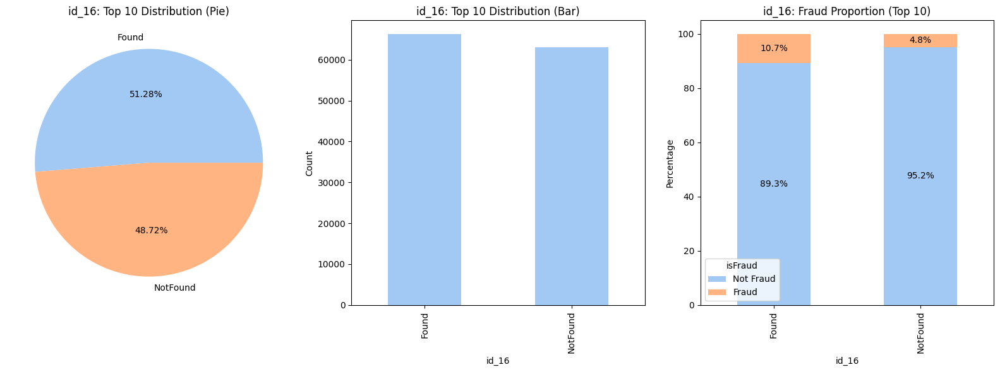

...

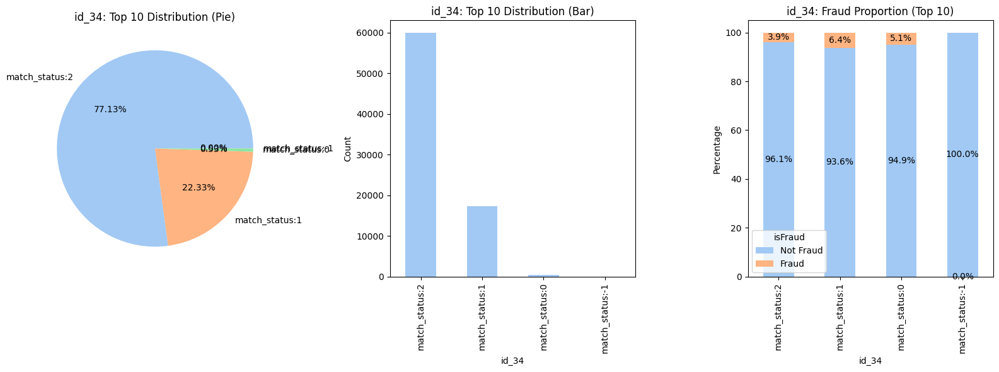

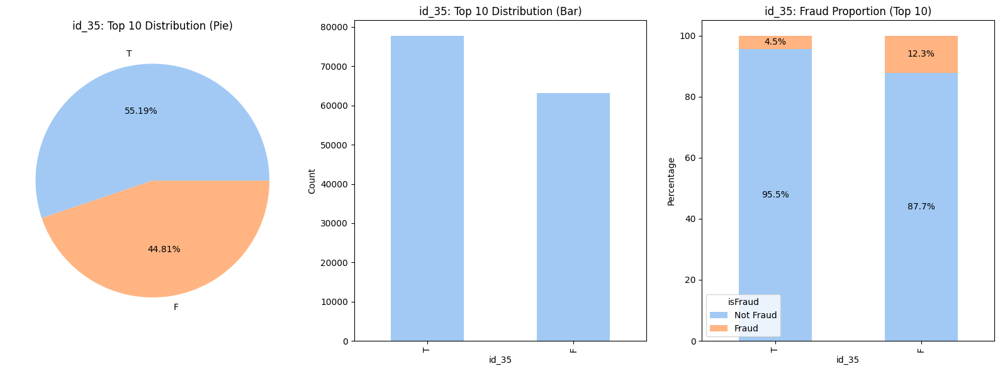

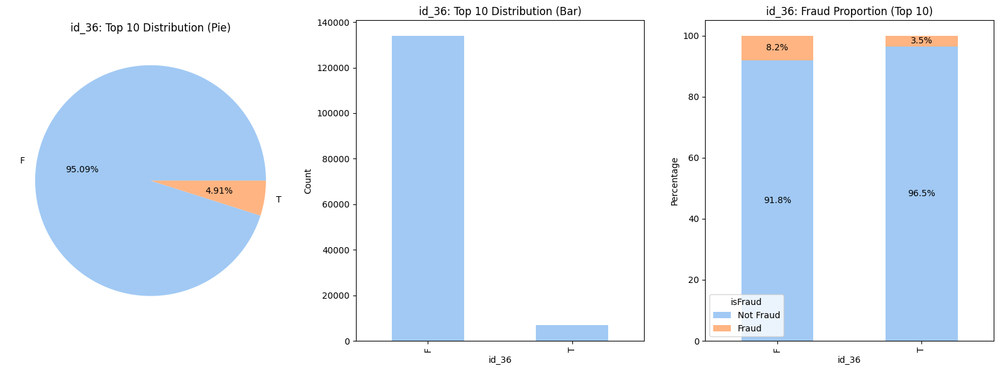

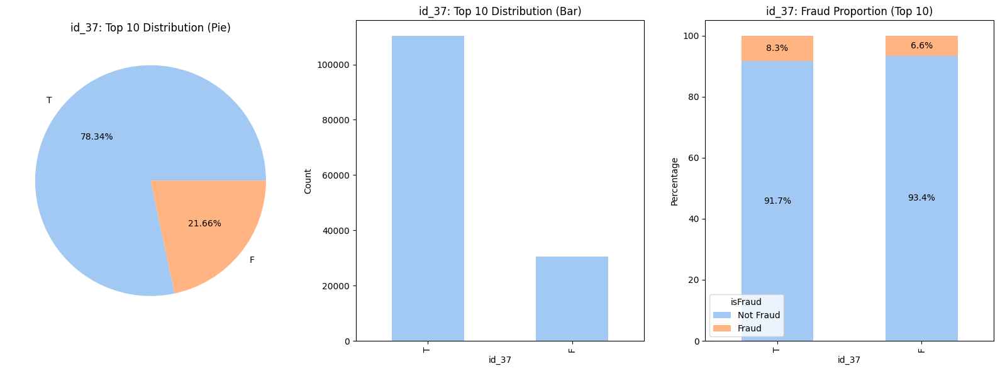

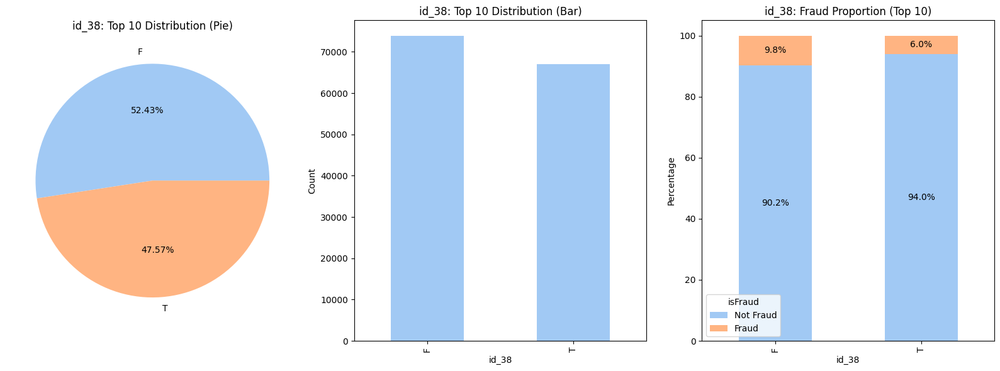

In [230]:
for col in id_cols:
    visualize_categorical_features(df_train, col)

Comment :
- **id_12 (Found/NotFound)**: `NotFound` has `85%` with `8.2%` fraud, compared to `Found` (`15%`) with `6.0%` fraud.  
- **id_23 (IP_PROXY)**: `TRANSPARENT` is the largest category (`67.5%`), but `ANONYMOUS` has the highest fraud proportion.  
- **id_30 (OS_VERSION)**: `Windows10` dominates (`~38%`), while older versions show higher fraud rates.  
- **id_31 (BROWSERS)**: `chrome63.0` is the most common, but `chrome generic` has the highest fraud (`16.8%`).  
- **id_33 (Screen Resolution)**: `1920x1080` is the most common, while `2208x1242` shows the highest fraud.  
- **id_35 & id_37 (T/F)**: `T` is more common overall. However, in `id_35`, `F` has higher fraud (`12.3%`), while in `id_37`, `T` has higher fraud (`8.3%`).  
- **id_36 & id_38 (T/F)**: `F` dominates (`95%` in `id_36`) with `8.2%` fraud, while `id_38` has `9.8%` fraud for `F`.  


### 2.2 Numerical Features

#### 2.2.1 TransactionDT
- This is actually a timedelta from a given reference datetime (not an actual timestamp).

In [231]:
df_train['TransactionDT'].describe()

count    5.905400e+05
mean     7.372311e+06
std      4.617224e+06
min      8.640000e+04
25%      3.027058e+06
50%      7.306528e+06
75%      1.124662e+07
max      1.581113e+07
Name: TransactionDT, dtype: float64

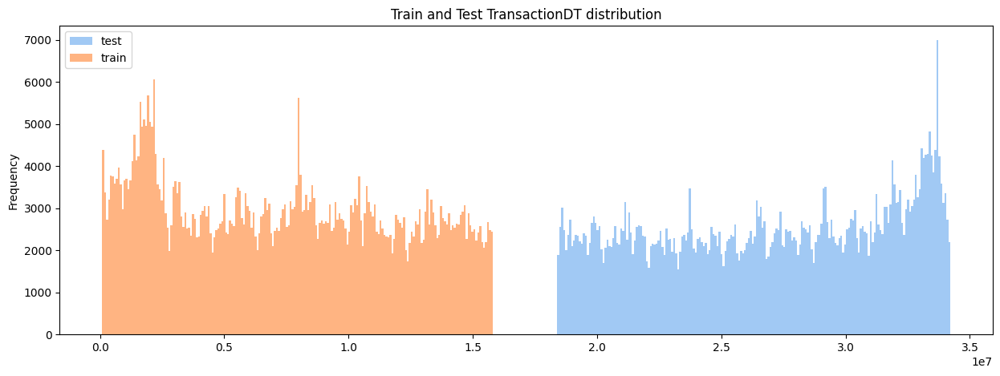

In train data Minimum transaction amount is 86400 and maximum amount  is 15811131
In test data Minimum transaction amount is 18403224 and maximum amount  is 34214345


In [236]:
df_test['TransactionDT'].plot(kind='hist', figsize=(15, 5), label='test', bins=200, title='Train and Test TransactionDT distribution')
df_train['TransactionDT'].plot(kind='hist', label='train', bins=200)
plt.legend()
plt.show()

print(f'In train data Minimum transaction amount is {df_train["TransactionDT"].min()} and maximum amount  is {df_train["TransactionDT"].max()}')
print(f'In test data Minimum transaction amount is {df_test["TransactionDT"].min()} and maximum amount  is {df_test["TransactionDT"].max()}')

* Train span: 15811131 − 86400 = 15,724,731s ≈ 181d 23h 58m 51s (≈ 182 days).
* Test span: 34214345 − 18403224 = 15,811,121s ≈ 182d 23h 58m 41s (≈ 183 days).
* Gap (train→test): 18403224 − 15811131 = 2,592,093s ≈ 30 days 1m 33s.

#### 2.2.2 Transaction Amt

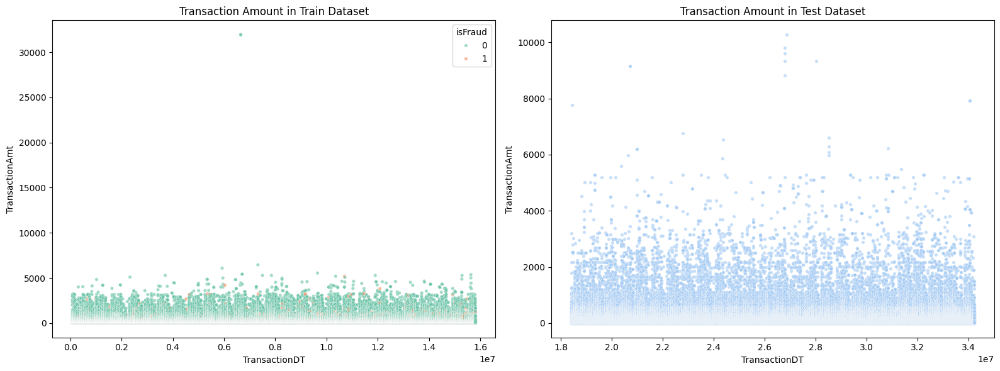

In train data Minimum transaction amount is 0.251 and maximum amount  is 31937.391


In [237]:
fig, axes = plt.subplots(1, 2, figsize=(16,6))

sns.scatterplot(
    data=df_train,
    x="TransactionDT", y="TransactionAmt",
    hue="isFraud", s=15, alpha=0.6, ax=axes[0], 
    palette = 'Set2'
)
axes[0].set_title("Transaction Amount in Train Dataset")

sns.scatterplot(
    data=df_test,
    x="TransactionDT", y="TransactionAmt",
    s=15, alpha=0.6, ax=axes[1],
    palette = 'Set2'  # no fraud labels in test
)
axes[1].set_title("Transaction Amount in Test Dataset")

plt.tight_layout()
plt.show()

print(f'In train data Minimum transaction amount is {df_train["TransactionAmt"].min()} and maximum amount  is {df_train["TransactionAmt"].max()}')

- There is one point in train data where transaction amount > 30000, which is considered as **outliers** . It may cause **overfitting problems** in many complex models like RandomForest,...

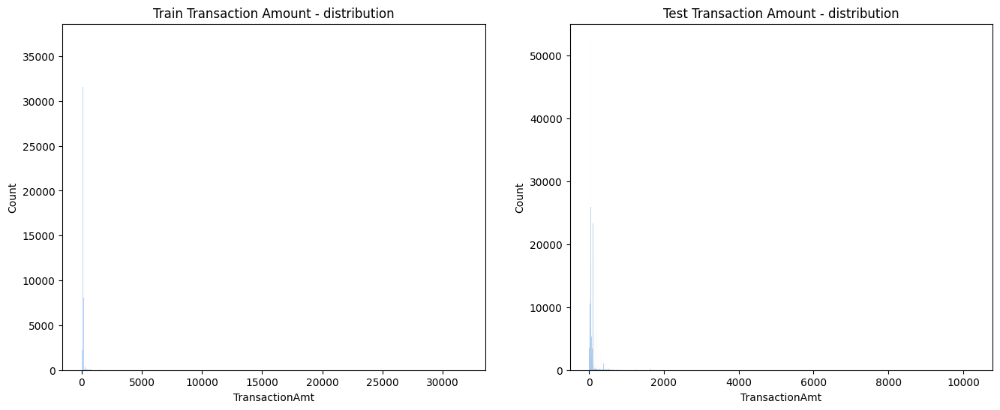

In train data Minimum transaction amount is 0.251 and maximum amount  is 31937.391


In [234]:
fig, axes = plt.subplots(1, 2, figsize=(16,6))
sns.histplot(df_train['TransactionAmt'],ax=axes[0])
sns.histplot(df_test['TransactionAmt'],ax=axes[1])
axes[0].title.set_text('Train Transaction Amount - distribution')
axes[1].title.set_text('Test Transaction Amount - distribution')
plt.show()

print(f'In train data Minimum transaction amount is {df_train["TransactionAmt"].min()} and maximum amount  is {df_train["TransactionAmt"].max()}')

#### 2.2.3 D1-D15

In [238]:
d_cols = [col for col in df_train.columns if col[0] == 'D' and len(col) <=3]
df_train[d_cols].head()

,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15
0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0
1,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0
2,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,315.0,NaN,NaN,NaN,315.0
3,112.0,112.0,0.0,94.0,0.0,NaN,NaN,NaN,NaN,84.0,NaN,NaN,NaN,NaN,111.0
4,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [239]:
check_missing_values(df_train,d_cols)

,missing_count,missing_percent
D7,551623,93.41
D13,528588,89.51
D14,528353,89.47
D12,525823,89.04
D6,517353,87.61
D8,515614,87.31
D9,515614,87.31
D5,309841,52.47
D2,280797,47.55
D11,279287,47.29


Comment : 
* Almost all D cols have a high percentage of missing values while D1 have the lowest one

In [ ]:
for col in d_cols:
    plt.figure(figsize=(15,5))
    plt.scatter(df_train['TransactionDT'],df_train[col])
    plt.title(f'Original {col}')
    plt.xlabel('Time')
    plt.ylabel(f'{col}')
    plt.show()

#### 2.2.4 C1-C14

In [240]:
c_cols = [c for c in df_train if c[0] == 'C']
df_train[c_cols].head()

,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14
0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0
1,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0
2,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0
3,2.0,5.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,1.0,0.0,25.0,1.0
4,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0


In [241]:
sample_df = pd.concat([df_train.loc[df_train['isFraud'] == 0].sample(500),
                       df_train.loc[df_train['isFraud'] == 1].sample(500)])

<Figure size 1400x1400 with 0 Axes>

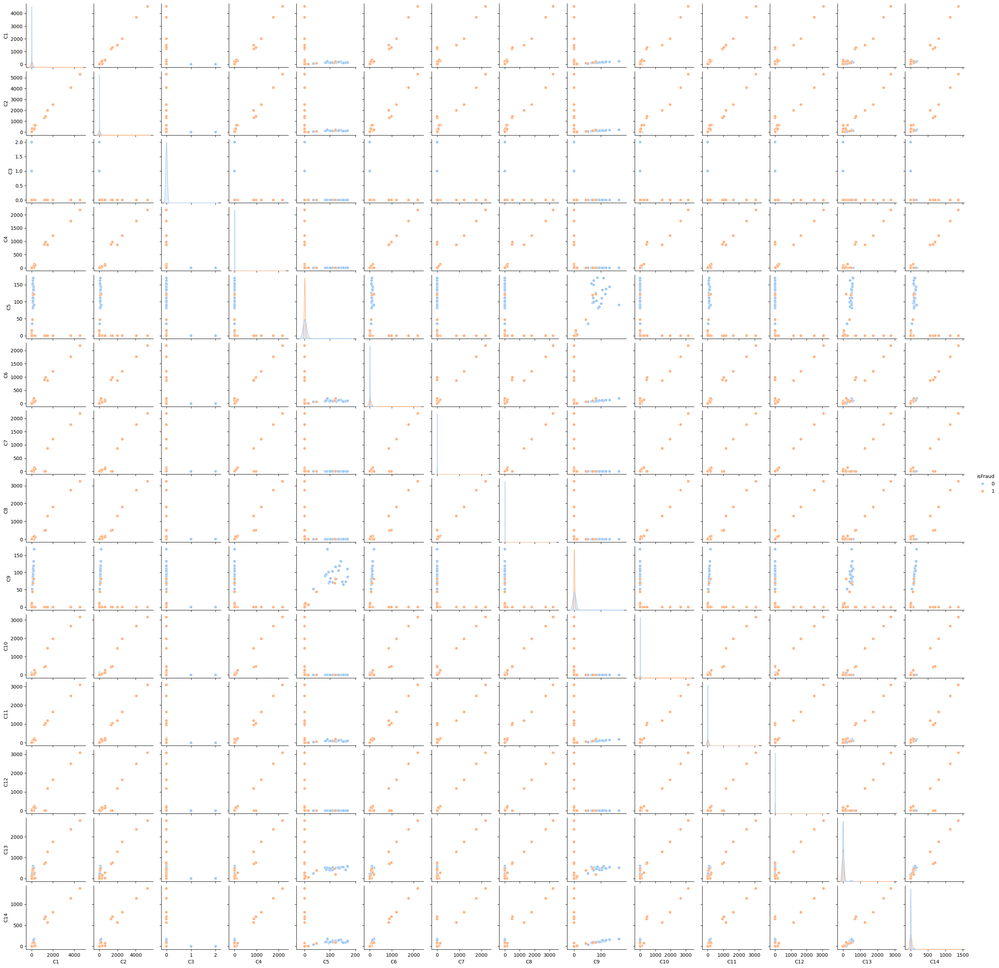

In [242]:
plt.figure(figsize=(14,14))
sns.pairplot(sample_df, 
             hue='isFraud',
            vars=c_cols,height=2)
plt.show()

#### 2.2.5 V1-V399

In [243]:
v_cols = [c for c in df_train if c[0] == 'V']
df_train[v_cols].head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [244]:
df_train[v_cols].describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,...,82351.000000,82351.000000,82351.000000,82351.000000,82351.000000,82351.00000,82351.000000,82351.000000,82351.000000,82351.000000
mean,0.999945,1.045204,1.078075,0.846456,0.876991,1.045686,1.072870,1.027704,1.041529,0.463915,...,0.775874,721.741883,1375.783644,1014.622782,9.807015,59.16455,28.530903,55.352422,151.160542,100.700882
std,0.007390,0.240133,0.320890,0.440053,0.475902,0.239385,0.304779,0.186069,0.226339,0.521522,...,4.727971,6217.223583,11169.275702,7955.735482,243.861391,387.62948,274.576920,668.486833,1095.034387,814.946722
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,25.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
max,1.000000,8.000000,9.000000,6.000000,6.000000,9.000000,9.000000,8.000000,8.000000,4.000000,...,55.000000,160000.000000,160000.000000,160000.000000,55125.000000,55125.00000,55125.000000,104060.000000,104060.000000,104060.000000


In [245]:
check_missing_values(df_train,v_cols) 

,missing_count,missing_percent
V142,508595,86.12
V153,508595,86.12
V165,508589,86.12
V164,508589,86.12
V163,508595,86.12
...,...,...
V307,12,0.00
V308,12,0.00
V309,12,0.00
V310,12,0.00


#### 2.2.6 id_1 - id_11

id_01 --------------------------------


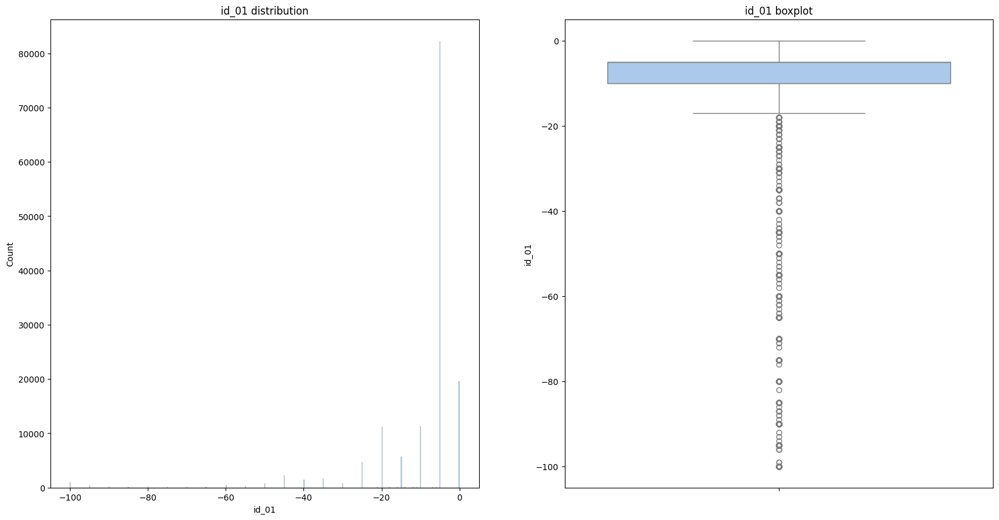

Median id_01 is -5.0
Mean id_01 is -10.170501896237338
Min Value id_01 is -100.0
Max Value id_01 is 0.0
--------------------------------
id_02 --------------------------------


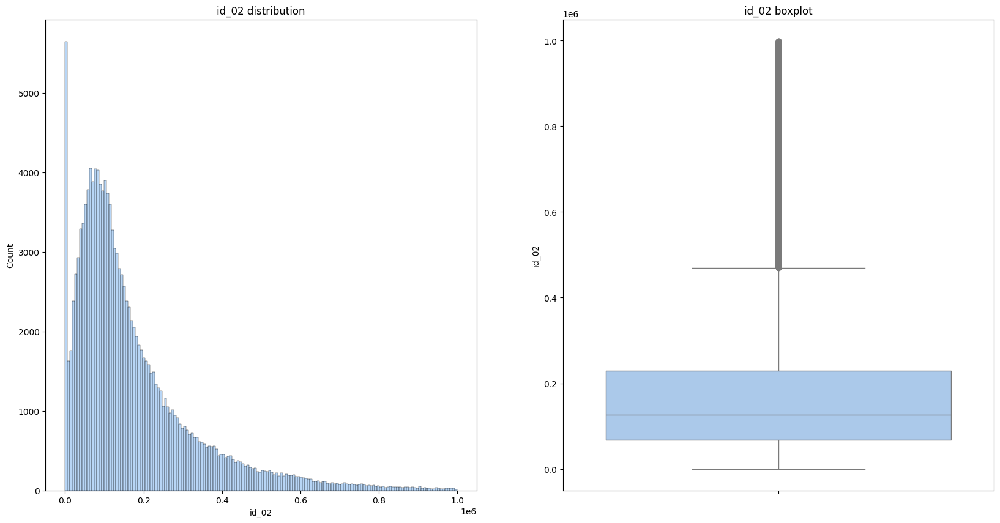

Median id_02 is 125800.5
Mean id_02 is 174716.58470810382
Min Value id_02 is 1.0
Max Value id_02 is 999595.0
--------------------------------
id_03 --------------------------------


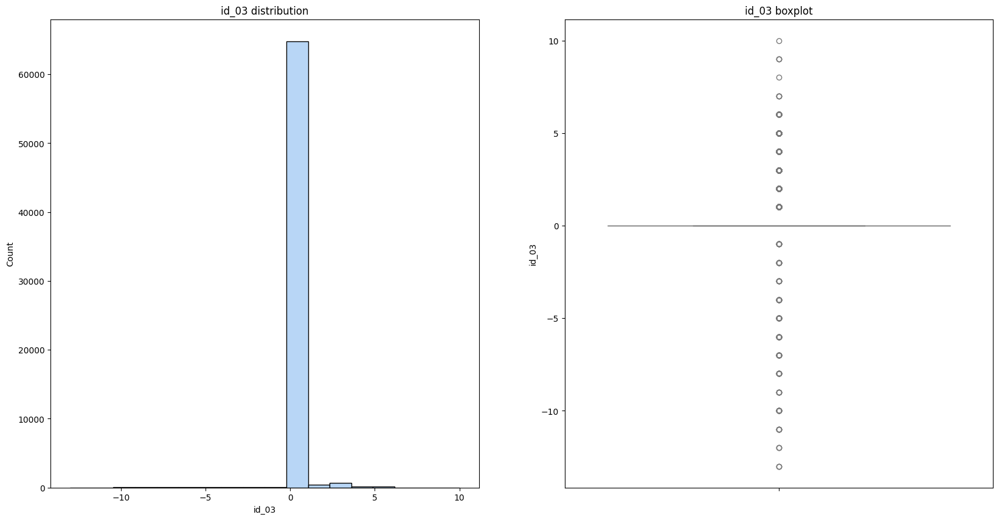

Median id_03 is 0.0
Mean id_03 is 0.06018937337916893
Min Value id_03 is -13.0
Max Value id_03 is 10.0
--------------------------------
id_04 --------------------------------


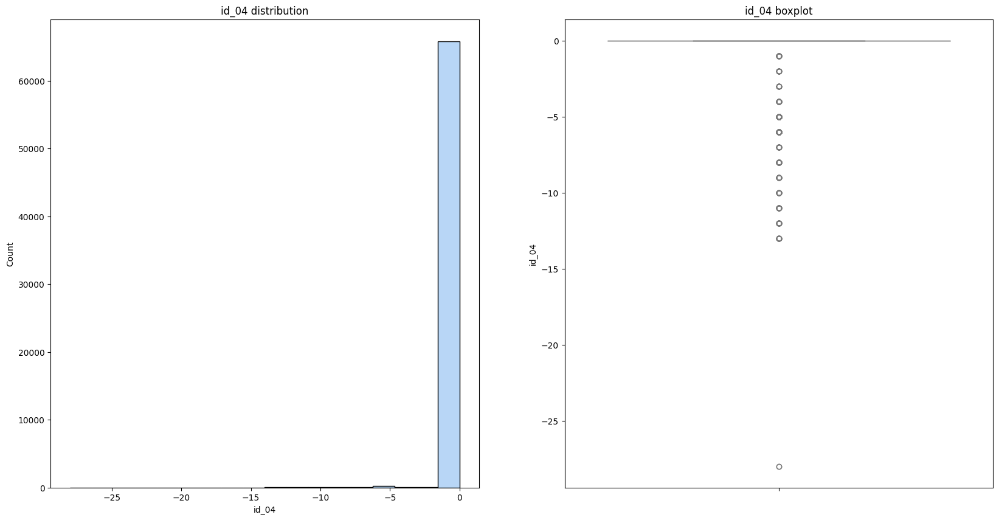

Median id_04 is 0.0
Mean id_04 is -0.058937941016826485
Min Value id_04 is -28.0
Max Value id_04 is 0.0
--------------------------------
id_05 --------------------------------


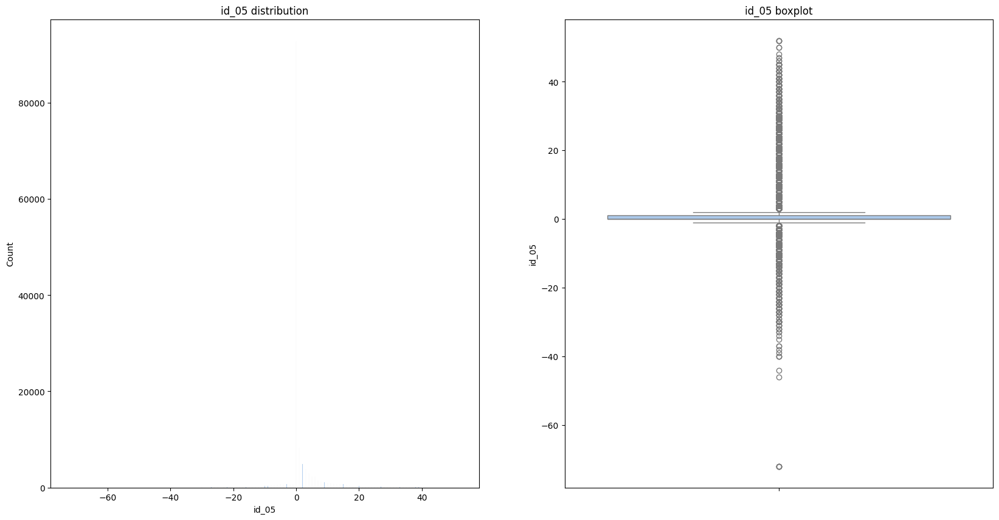

Median id_05 is 0.0
Mean id_05 is 1.6155847002520731
Min Value id_05 is -72.0
Max Value id_05 is 52.0
--------------------------------
id_06 --------------------------------


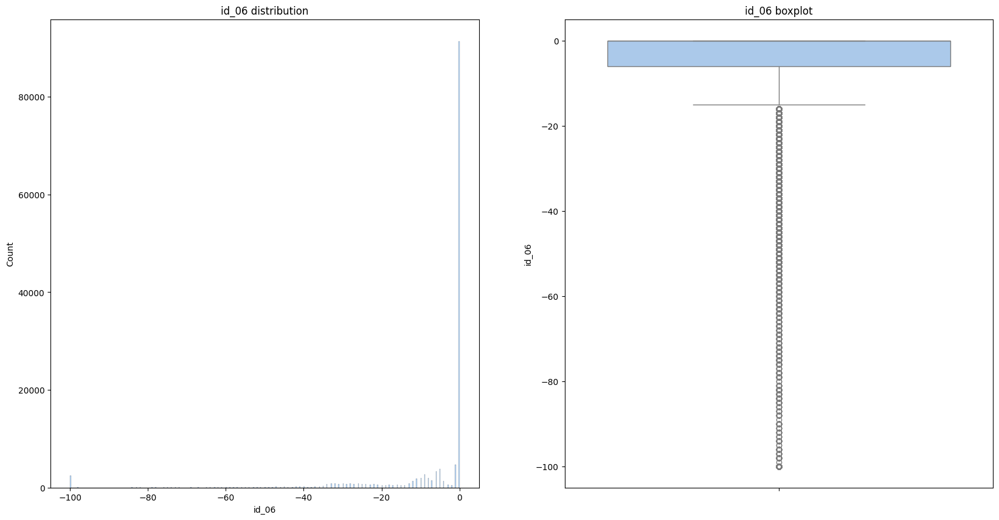

Median id_06 is 0.0
Mean id_06 is -6.698710408066343
Min Value id_06 is -100.0
Max Value id_06 is 0.0
--------------------------------
id_07 --------------------------------


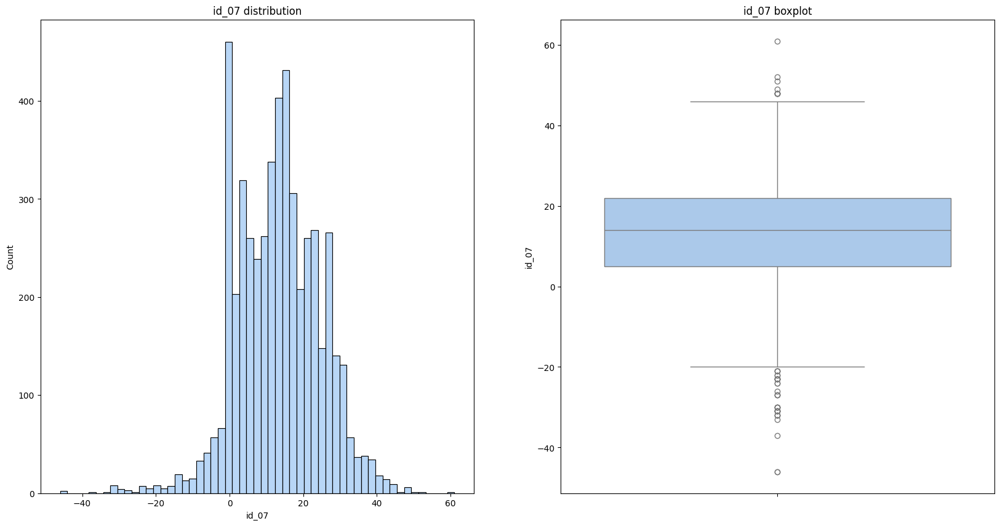

Median id_07 is 14.0
Mean id_07 is 13.285354025218234
Min Value id_07 is -46.0
Max Value id_07 is 61.0
--------------------------------
id_08 --------------------------------


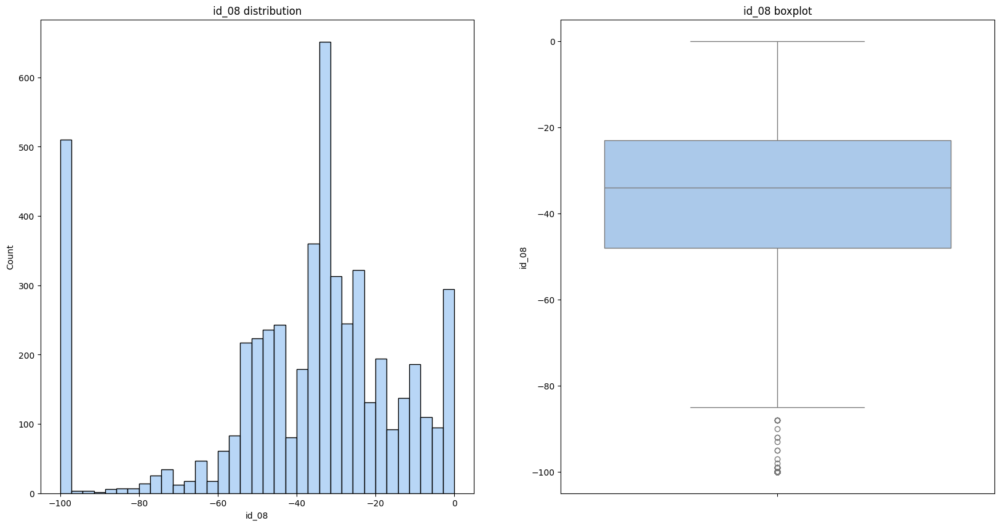

Median id_08 is -34.0
Mean id_08 is -38.6003879728419
Min Value id_08 is -100.0
Max Value id_08 is 0.0
--------------------------------
id_09 --------------------------------


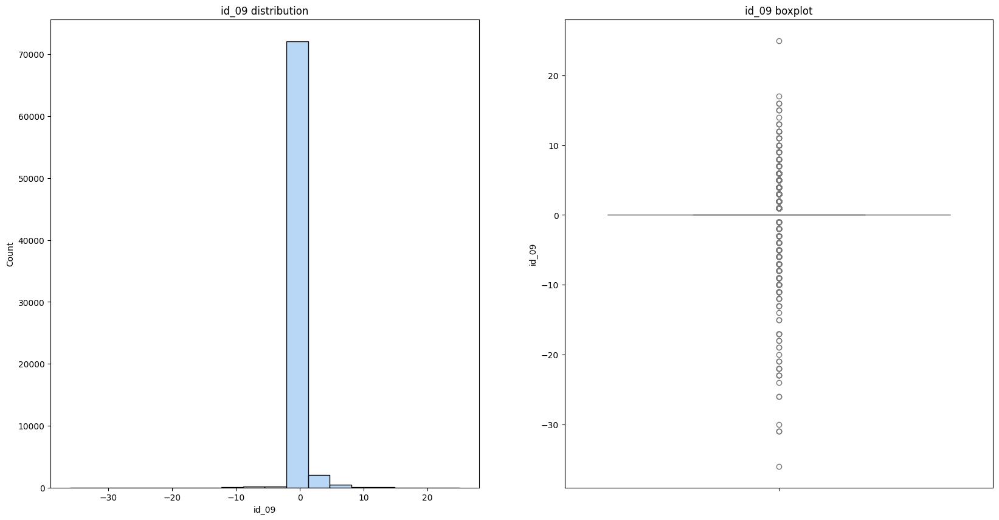

Median id_09 is 0.0
Mean id_09 is 0.09102314283426315
Min Value id_09 is -36.0
Max Value id_09 is 25.0
--------------------------------
id_10 --------------------------------


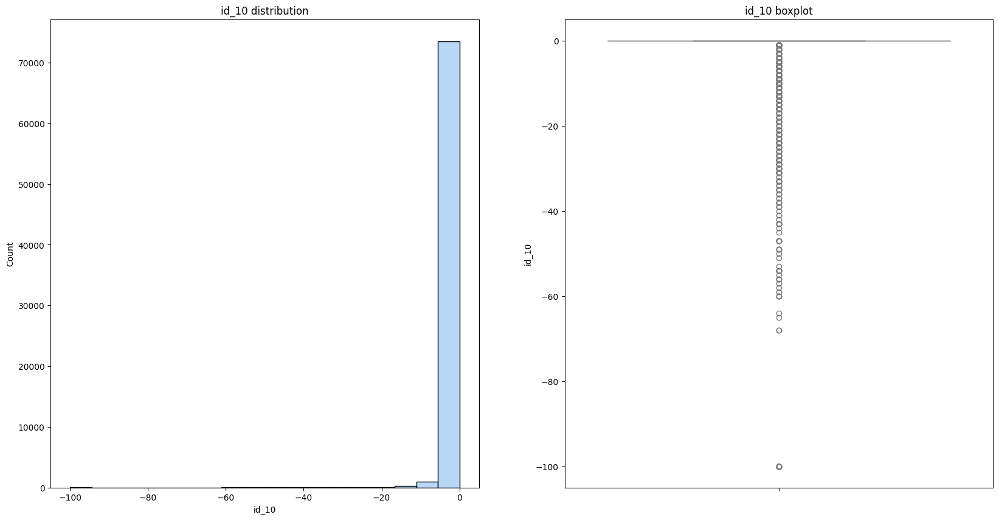

Median id_10 is 0.0
Mean id_10 is -0.3011237754584523
Min Value id_10 is -100.0
Max Value id_10 is 0.0
--------------------------------
id_11 --------------------------------


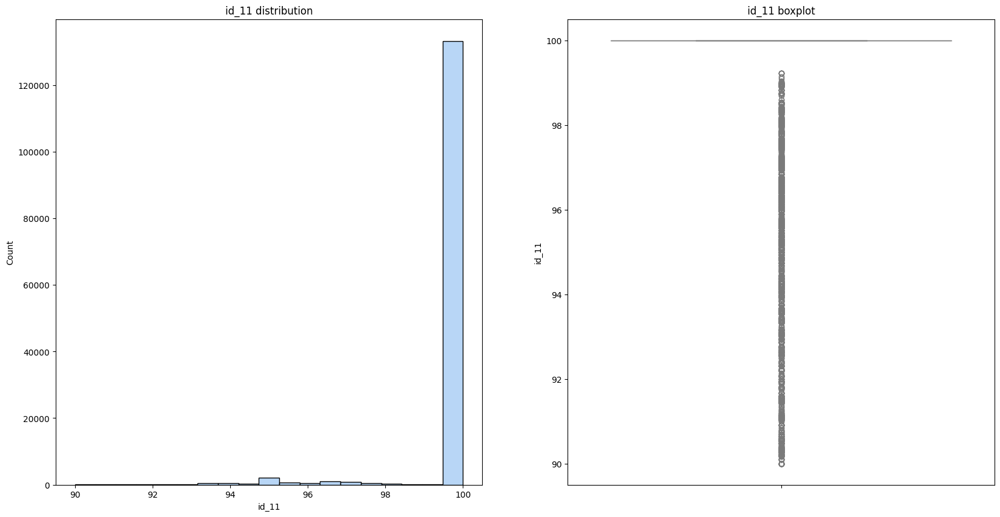

Median id_11 is 100.0
Mean id_11 is 99.74532471343878
Min Value id_11 is 90.0
Max Value id_11 is 100.0
--------------------------------


In [246]:
id_numeric_cols = ['id_01', 'id_02', 'id_03', 'id_04', 'id_05', 'id_06', 'id_07', 'id_08', 'id_09', 'id_10','id_11']
for col in id_numeric_cols:
    print(col + " --------------------------------")
    fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(20,10))
    sns.histplot(df_train[col],ax=axes[0])
    sns.boxplot(df_train[col],ax=axes[1])
    axes[0].title.set_text(f'{col} distribution')
    axes[1].title.set_text(f'{col} boxplot')
    plt.show()
    print(f'Median {col} is {df_train[col].median()}')
    print(f'Mean {col} is {df_train[col].mean()}')
    print(f"Min Value {col} is {df_train[col].min()}")
    print(f"Max Value {col} is {df_train[col].max()}")
    print("--------------------------------")


## 2.4. Multivariate Analysis

#### 2.4.1 ProductCD vs TransactionAmt

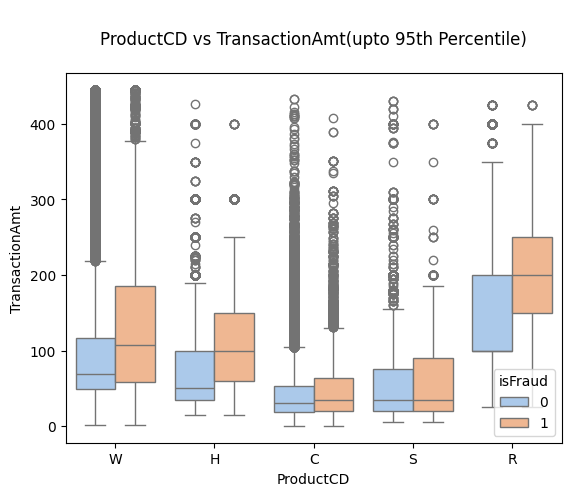

In [247]:
sns.boxplot(x='ProductCD', y='TransactionAmt', data=df_train[df_train['TransactionAmt']<=np.percentile(df_train['TransactionAmt'], 95)], hue='isFraud')
plt.title('\nProductCD vs TransactionAmt(upto 95th Percentile)\n')
plt.show()

- Comment : 
    * The amount spent in highest for ProductCD "R" and is lowest for ProductCD "S" and "C".
    * For ProductCD "W", "H" and "R" if the TransactionAmt is high then that transaction is often a fraudulent transaction.

#### 2.4.2 TransactionDT vs TransactionAmt

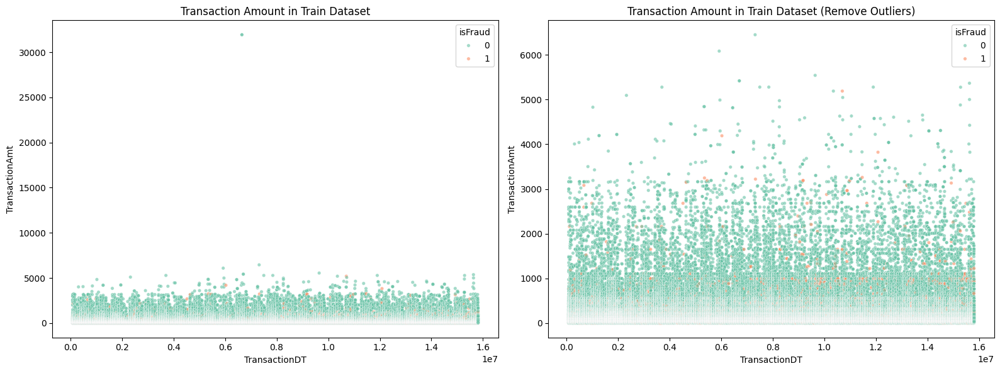

In train data Minimum transaction amount is 0.251 and maximum amount  is 31937.391


In [248]:
fig, axes = plt.subplots(1, 2, figsize=(16,6))

sns.scatterplot(
    data=df_train,
    x="TransactionDT", y="TransactionAmt",
    hue="isFraud", s=15, alpha=0.6, ax=axes[0], 
    palette = 'Set2'
)
axes[0].set_title("Transaction Amount in Train Dataset")

sns.scatterplot(
    data=df_train[df_train['TransactionAmt']< 30000],
    x="TransactionDT", y="TransactionAmt",
    hue="isFraud", s=15, alpha=0.6, ax=axes[1],
    palette = 'Set2'  # no fraud labels in test
)
axes[1].set_title("Transaction Amount in Train Dataset (Remove Outliers)")

plt.tight_layout()
plt.show()

print(f'In train data Minimum transaction amount is {df_train["TransactionAmt"].min()} and maximum amount  is {df_train["TransactionAmt"].max()}')

#### 2.4.2 card1-card6 vs TransactionAmt

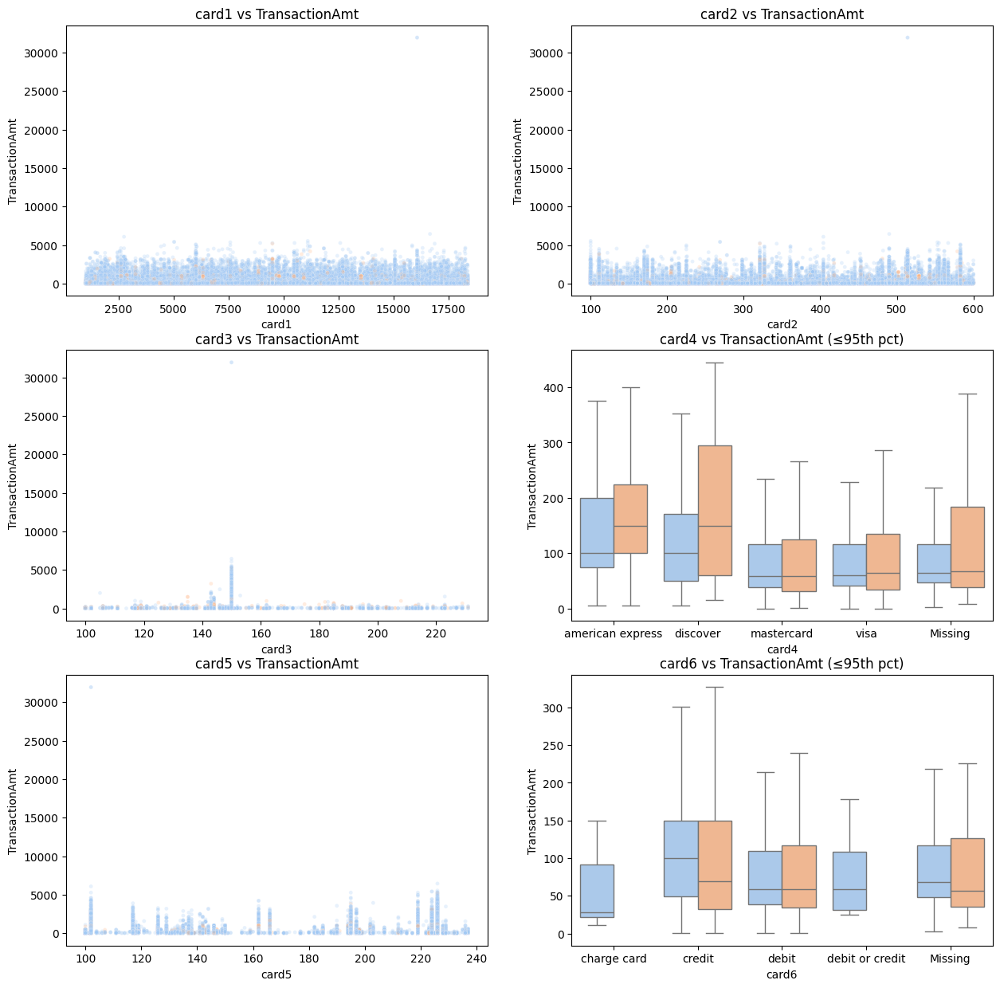

In [249]:
fig, axes = plt.subplots(3, 2, figsize=(15, 15))
axes = axes.ravel()

amt95 = np.nanpercentile(df_train['TransactionAmt'], 95)

for i, col in enumerate(card_cols):
    ax = axes[i]

    if col in ['card4', 'card6']:
        # Categorical: boxplot. Show Missing explicitly to keep counts consistent.
        tmp = df_train.copy()
        tmp[col] = tmp[col].astype('category')
        if 'Missing' not in tmp[col].cat.categories:
            tmp[col] = tmp[col].cat.add_categories('Missing')
        tmp[col] = tmp[col].fillna('Missing')

        sns.boxplot(
            data=tmp[tmp['TransactionAmt'] <= amt95],
            x=col, y='TransactionAmt', hue='isFraud',
            showfliers=False, ax=ax
        )
        ax.set_title(f'{col} vs TransactionAmt (≤95th pct)')
        ax.set_xlabel(col)
        ax.set_ylabel('TransactionAmt')
    else:
        # Numeric: scatterplot
        sns.scatterplot(
            data=df_train,
            x=col, y='TransactionAmt', hue='isFraud',
            alpha=0.25, s=12, ax=ax
        )
        ax.set_title(f'{col} vs TransactionAmt')
        ax.set_xlabel(col)
        ax.set_ylabel('TransactionAmt')

    # Optional: reduce legend clutter on each subplot
    if ax.get_legend() is not None:
        ax.get_legend().remove()

#### 2.4.3 P_email vs Transaction Amt

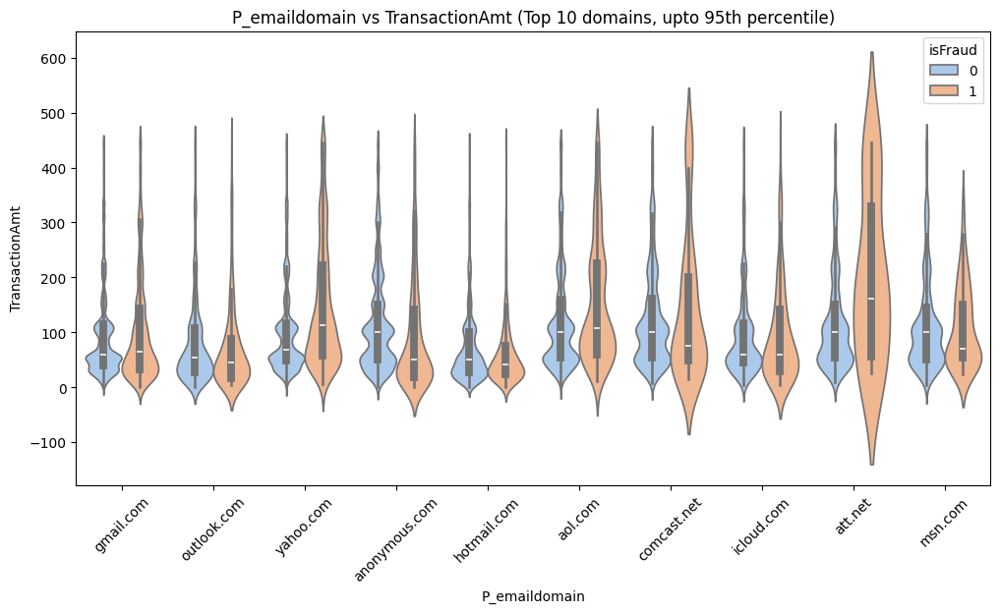

In [35]:
top_domains = df_train['P_emaildomain'].value_counts().index[:10]
df_top = df_train[df_train['P_emaildomain'].isin(top_domains)]

plt.figure(figsize=(12,6))
sns.violinplot(x='P_emaildomain', y='TransactionAmt',
               data=df_top[df_top['TransactionAmt'] <= np.percentile(df_train['TransactionAmt'], 95)],
               hue='isFraud', scale='width')
plt.xticks(rotation=45)
plt.title("P_emaildomain vs TransactionAmt (Top 10 domains, upto 95th percentile)")
plt.show()

##### 2.4.4 D vs TransactionDT

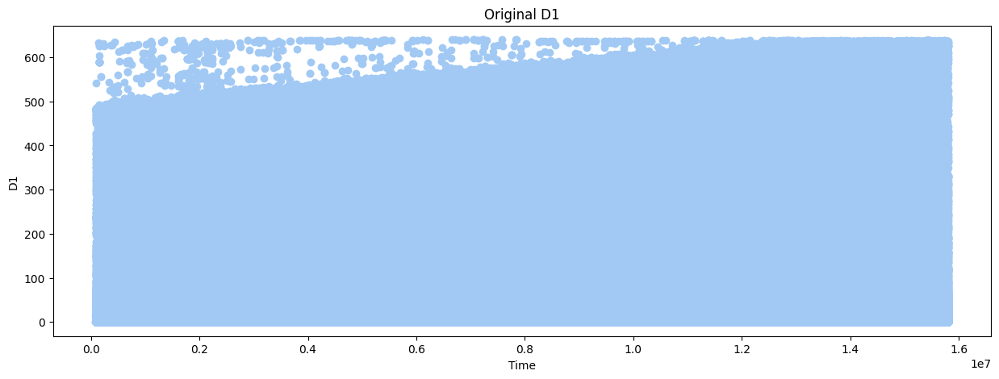

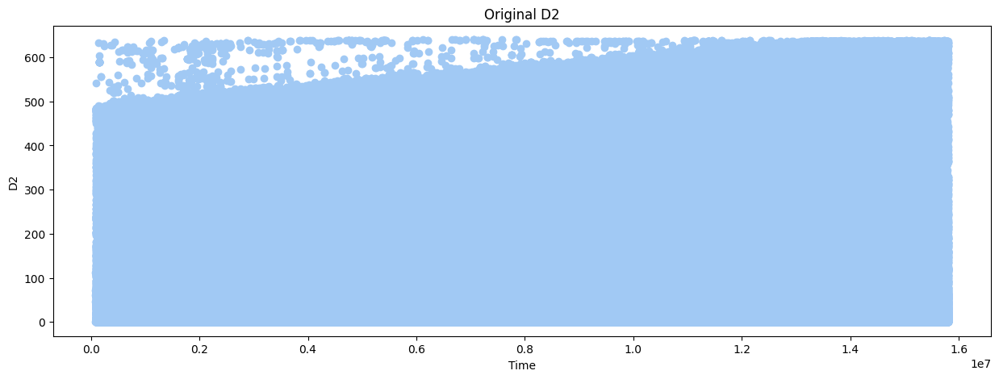

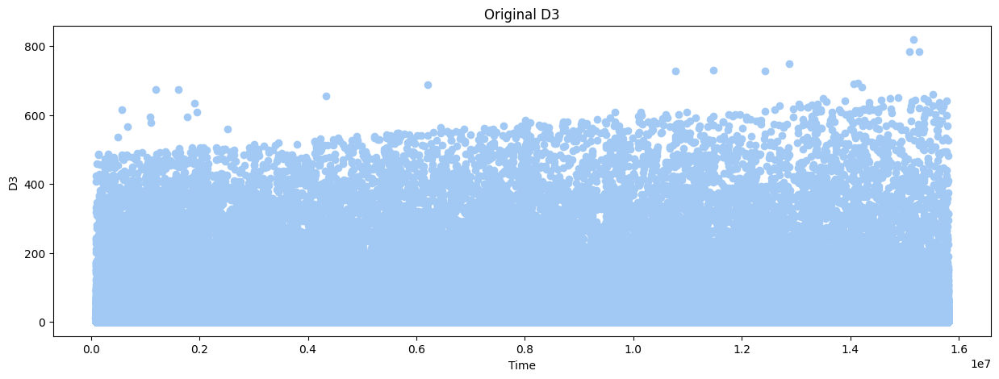

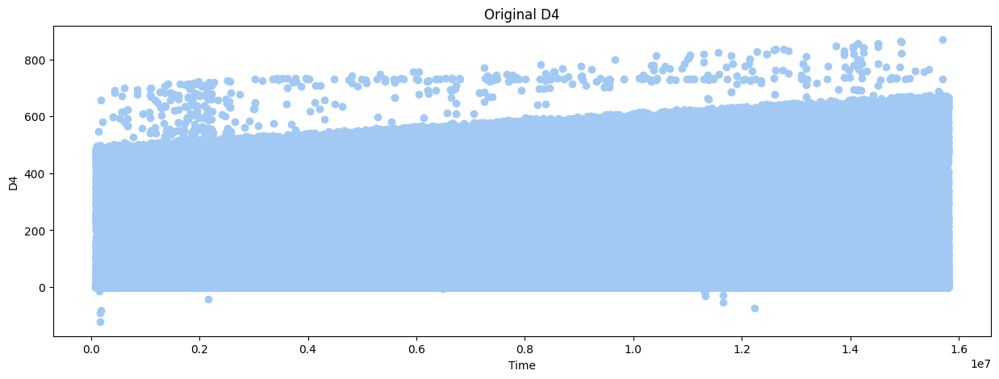

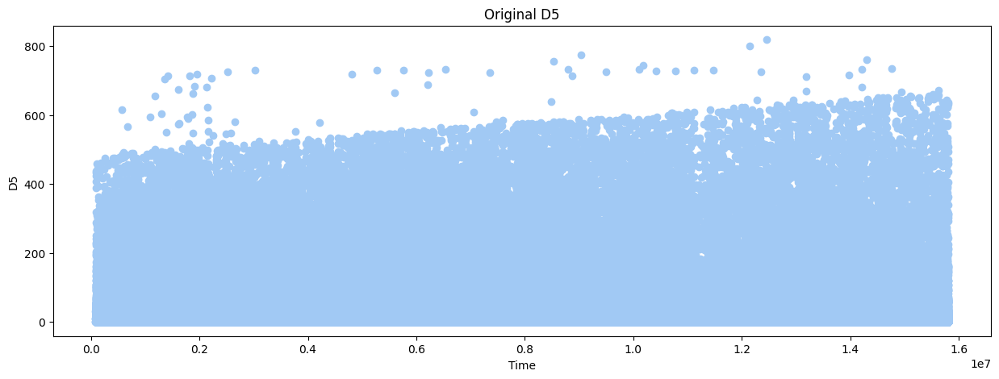

...

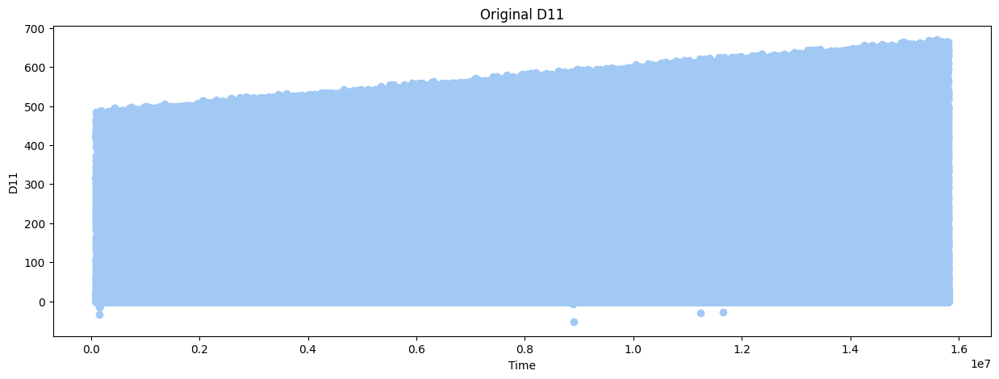

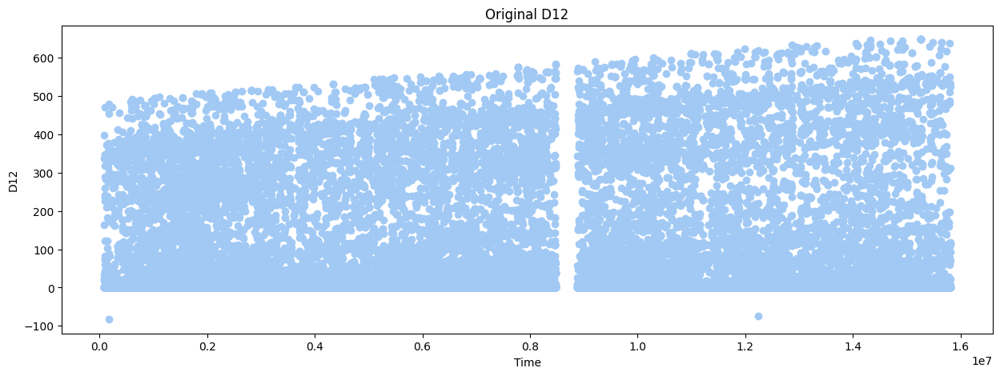

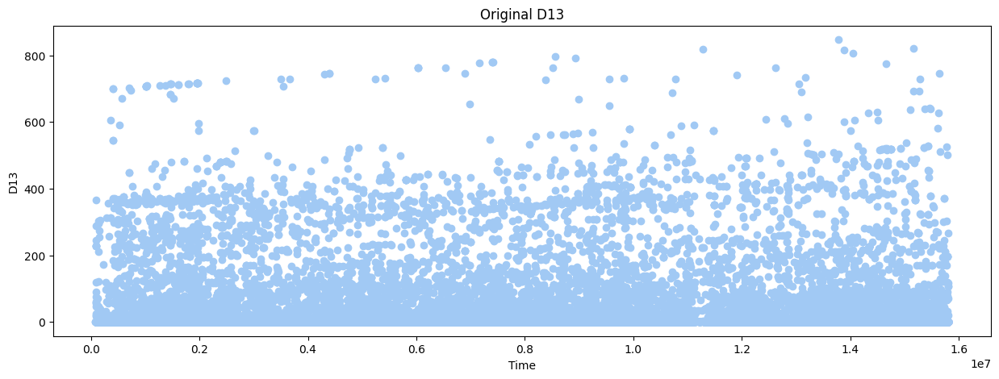

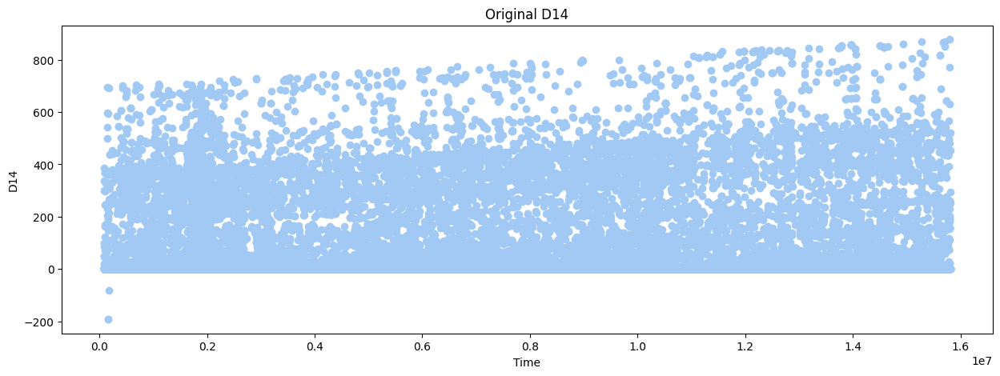

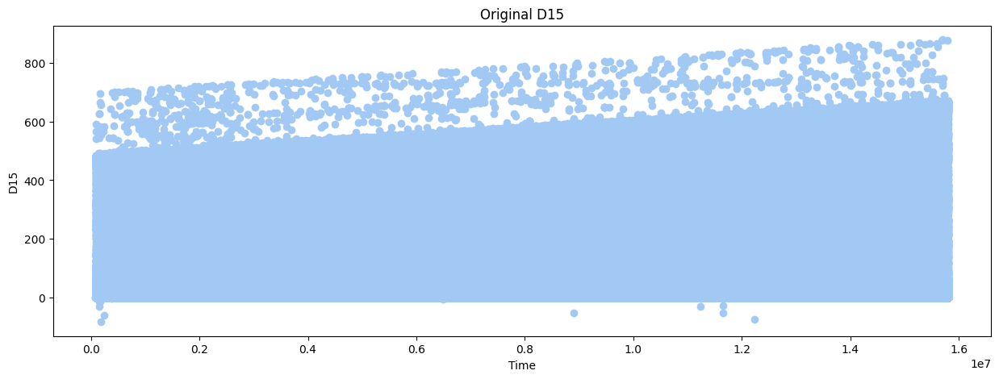

In [251]:
d_cols = [col for col in df_train.columns if col[0] == 'D' and len(col) <= 3]
for col in d_cols:
    plt.figure(figsize=(15,5))
    plt.scatter(df_train['TransactionDT'],df_train[col])
    plt.title(f'Original {col}')
    plt.xlabel('Time')
    plt.ylabel(f'{col}')
    plt.show()

#### 2.5 Correlation Analysis with Numerical Variables

##### 2.5.1 id_columns

Correlation with isFraud:
isFraud    1.000000
id_01      0.120099
id_07      0.084768
id_04      0.059701
id_08      0.057489
id_02      0.049398
id_03      0.041457
id_09      0.029431
id_06      0.027139
id_10      0.011043
id_05      0.007978
id_11      0.007914
Name: isFraud, dtype: float64


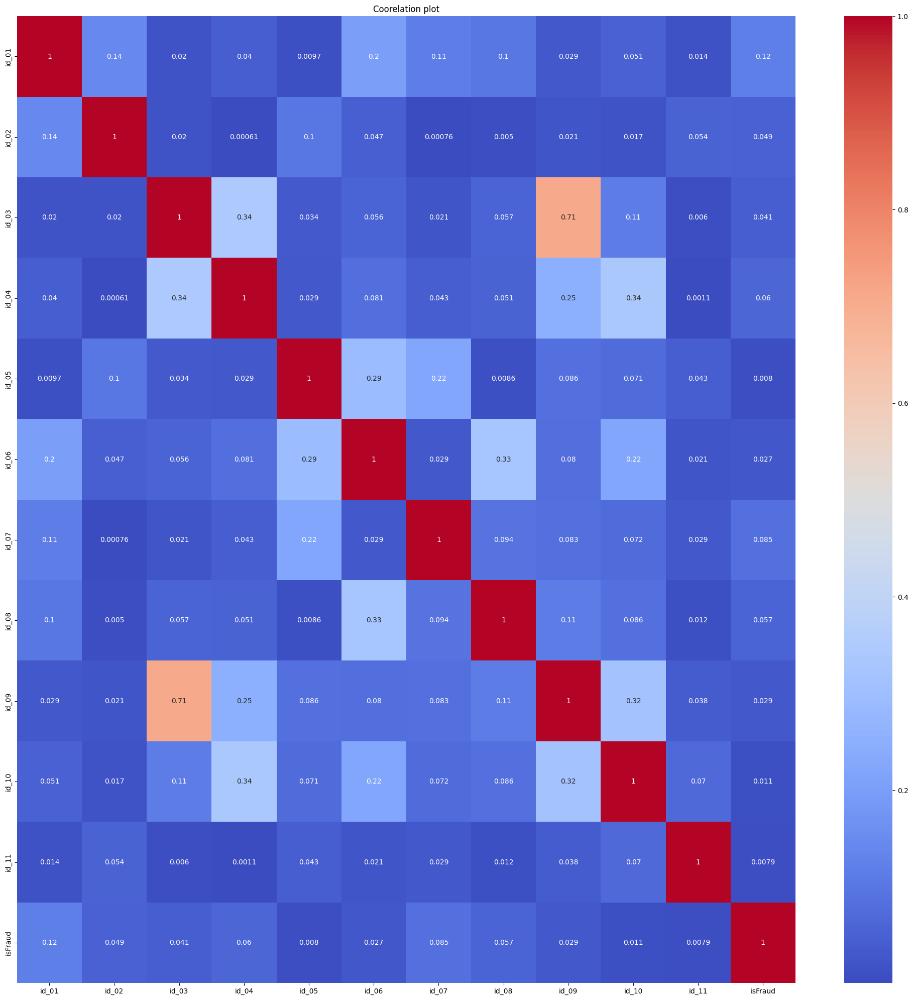

In [252]:
id_numeric_cols = ['id_01', 'id_02', 'id_03', 'id_04', 'id_05', 'id_06', 'id_07', 'id_08', 'id_09', 'id_10','id_11']

corrs = df_train[id_numeric_cols + ['isFraud']].corr()['isFraud'].abs().sort_values(ascending=False)
print("Correlation with isFraud:")
print(corrs)

fig,axes = plt.subplots(1,1,figsize=(25,25))
df_corr = df_train[id_numeric_cols + ['isFraud']].corr().fillna(0).abs()
sns.heatmap(df_corr,annot=True, cmap='coolwarm')
axes.title.set_text('Coorelation plot')
plt.show()

* We can see that there is not much of a strong coorelation between id columns. Only `id_09` coorelated with `id_03` with 0.71 (Highest)
* None of all numerical id cols can identify `isFraud`

##### 2.5.2 M1-M9

Correlation with isFraud:
isFraud    1.000000
M4         0.119941
M3         0.038697
M2         0.037091
M9         0.032055
M5         0.031802
M6         0.023282
M8         0.019067
M7         0.006831
M1         0.001259
Name: isFraud, dtype: float64


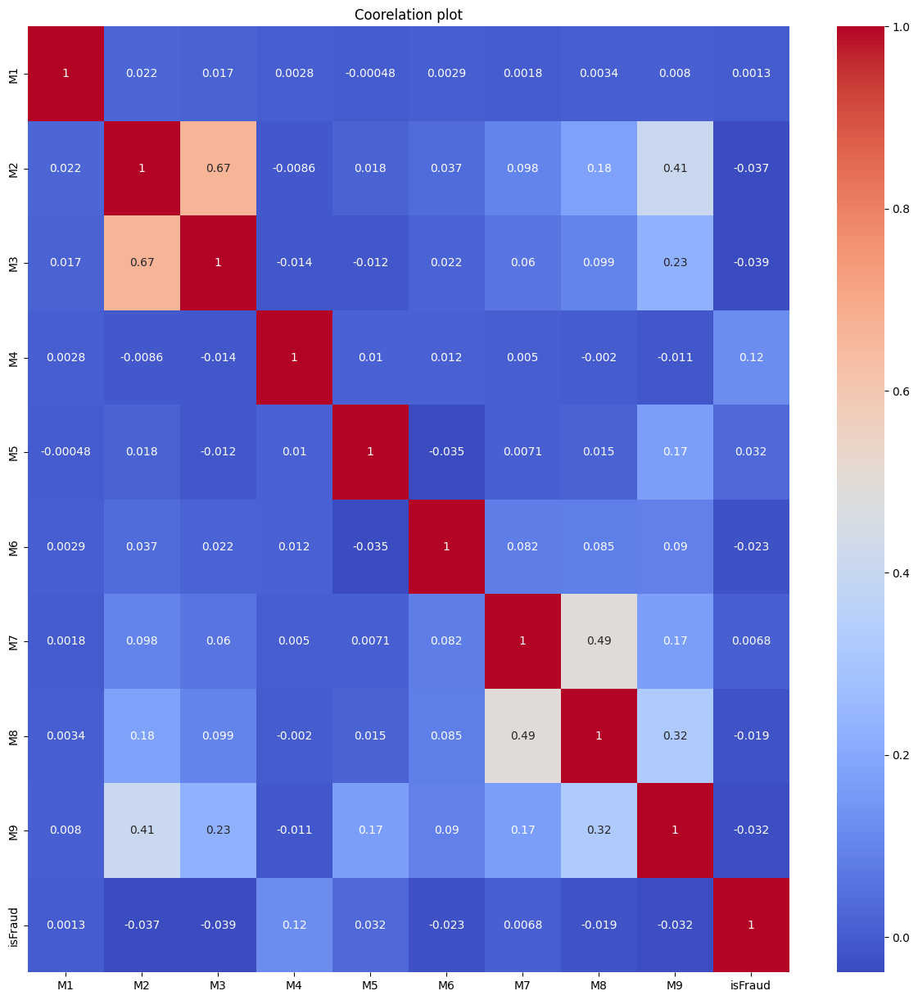

In [253]:
m_cols = [col for col in df_train.columns if col[0] == 'M']

mp = {'F':0,'T':1,'M0':0,'M1':1,'M2':2}
df_m_cols = df_train[m_cols].copy()
for c in m_cols: df_m_cols[c] = df_m_cols[c].map(mp)

df_m_cols['isFraud'] = df_train['isFraud']

corrs = df_m_cols[m_cols + ['isFraud']].corr()['isFraud'].abs().sort_values(ascending=False)
print("Correlation with isFraud:")
print(corrs)

fig,axes = plt.subplots(1,1,figsize=(15,15))
df_corr = df_m_cols.corr()
sns.heatmap(df_corr,annot=True,cmap='coolwarm')
axes.title.set_text('Coorelation plot')
plt.show()

* We can see that there is not much of a strong coorelation between M columns. Only `M2` coorelated with `M3` with 0.67 (Highest)
* No one can identify `isFraud`

##### 2.5.3 D1-D15

Correlation with isFraud:
isFraud    1.000000
D8         0.142636
D7         0.127199
D2         0.083583
D15        0.077519
D10        0.072002
D4         0.067216
D1         0.067193
D5         0.064638
D13        0.059430
D6         0.057236
D3         0.046271
D11        0.045094
D9         0.044253
D12        0.028864
D14        0.008663
Name: isFraud, dtype: float64


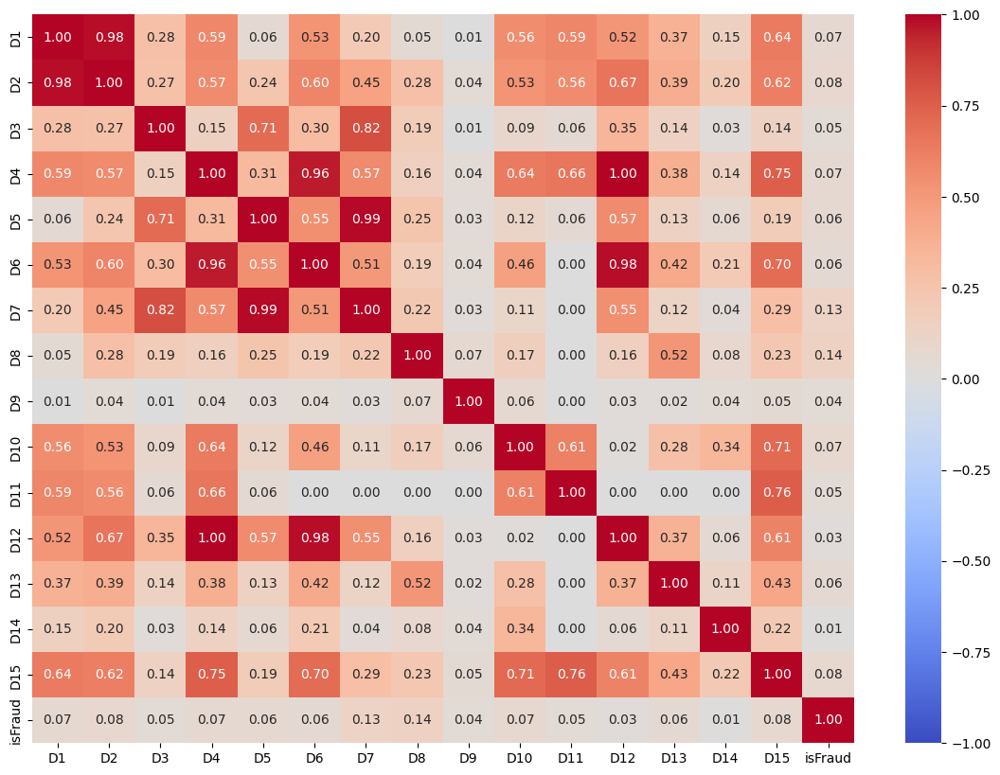

In [254]:
# Correlation with isFraud
corrs = df_train[d_cols + ['isFraud']].corr()['isFraud'].abs().sort_values(ascending=False)
print("Correlation with isFraud:")
print(corrs)

# Top correlated plot  
plt.figure(figsize=(14, 10))
sns.heatmap(df_train[d_cols+ ['isFraud']].corr().fillna(0).abs(), annot=True, cmap='coolwarm', vmin=-1, vmax=1, fmt='.2f')
plt.show()

Comment :
- All correlations with `isFraud` are weak (Range from 0.01 -> 0.14)
- None of any individual D1-D15 features strongly predict `isFraud`
- `D8` have the highest correlations with 0.14 
* Multicollinearity :
    - `D1` and `D2` (0.98)
    - `D5` and `D7` (0.99)
    - `D6` and `D12` (0.98)
    - `D11` and `D12` (0.98)

-> Have to use **Feature Selection** to not affect to linear models like (logistic regression)

# 3. Feature Enginnering

### 3.1 Reduced V-cols based on their NaN values

In [6]:
v_cols = [col for col in df_train.columns if col[0] == 'V']

nan_dict_v = {}
for col in v_cols:
    cnt= df_train[col].isna().sum()
    try:
        nan_dict_v[cnt].append(col)
    except:
        nan_dict_v[cnt] = [col]
    
nan_summary = []
for nan_count, cols in nan_dict_v.items():
        nan_summary.append({"Column": cols, "NaN_Count": nan_count})

nan_df = pd.DataFrame(nan_summary)
nan_df

,Column,NaN_Count
0,"[V1, V2, V3, V4, V5, V6, V7, V8, V9, V10, V11]",279287
1,"[V12, V13, V14, V15, V16, V17, V18, V19, V20, ...",76073
2,"[V35, V36, V37, V38, V39, V40, V41, V42, V43, ...",168969
3,"[V53, V54, V55, V56, V57, V58, V59, V60, V61, ...",77096
4,"[V75, V76, V77, V78, V79, V80, V81, V82, V83, ...",89164
5,"[V95, V96, V97, V98, V99, V100, V101, V102, V1...",314
6,"[V138, V139, V140, V141, V142, V146, V147, V14...",508595
7,"[V143, V144, V145, V150, V151, V152, V159, V16...",508589
8,"[V167, V168, V172, V173, V176, V177, V178, V17...",450909
9,"[V169, V170, V171, V174, V175, V180, V184, V18...",450721


In [7]:
def coorelation_analysis(cols,title='Coorelation Analysis',size=(12,12)):
    cols = sorted(cols)
    fig,axes = plt.subplots(1,1,figsize=size)
    df_corr = df_train[cols].corr()
    sns.heatmap(df_corr,annot=True,cmap='RdBu_r')
    axes.title.set_text(title)
    plt.show()

In [8]:
def reduce_cols(grps):
    '''
    determining column that have more unique values among a group of atttributes
    '''
    use = []
    for col in grps:
        max_unique = 0
        max_index = 0
        for i,c in enumerate(col):
            n = df_train[c].nunique()
            if n > max_unique:
                max_unique = n
                max_index = i
        use.append(col[max_index])
    return use

['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11']


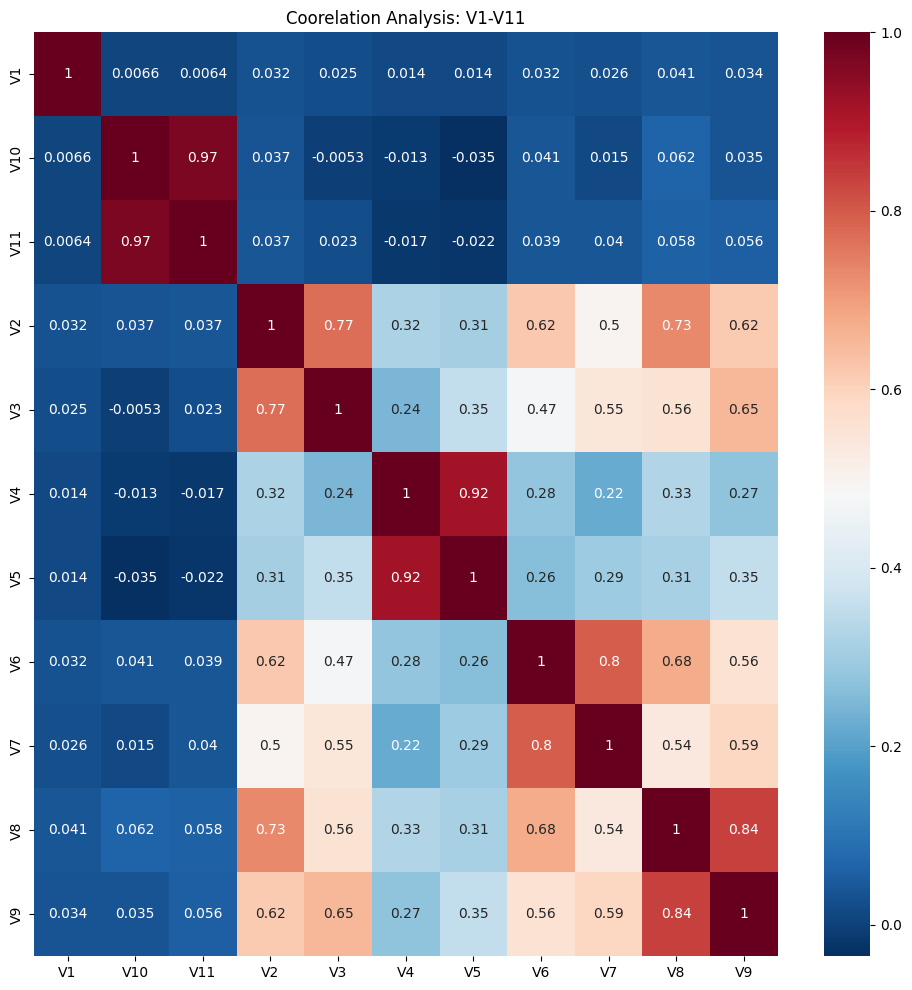

In [9]:
group1 = nan_df.iloc[0]['Column']
print(group1)
coorelation_analysis(group1,title='Coorelation Analysis: V1-V11',size=(12,12))

In [10]:
pairs = [['V1'],['V2','V3'],['V4','V5'],['V6','V7'],['V8','V9'],['V10','V11']]
group1_after_reduce = reduce_cols(pairs) 
group1_after_reduce

['V1', 'V3', 'V4', 'V6', 'V8', 'V11']

['V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34']


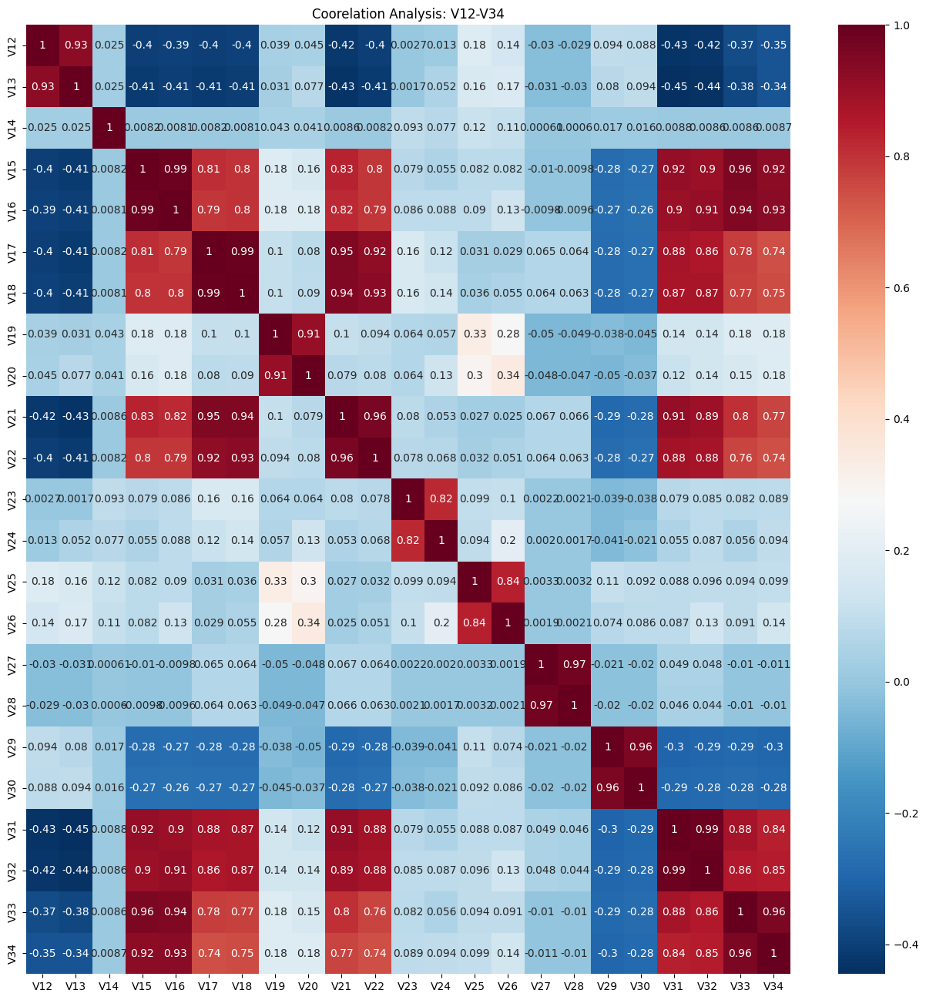

In [11]:
group2 = nan_df.iloc[1]['Column']
print(group2)
coorelation_analysis(group2,title='Coorelation Analysis: V12-V34',size=(16,16))

In [12]:
pairs = [['V12','V13'],['V14'],['V15','V16','V17','V18','V21','V22','V31','V32','V33','V34'],['V19','V20'],
         ['V23','V24'],['V25','V26'],['V27','V28'],['V29','V30']]

group2_after_reduce = reduce_cols(pairs)
group2_after_reduce

['V13', 'V14', 'V17', 'V20', 'V23', 'V26', 'V27', 'V30']

['V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52']


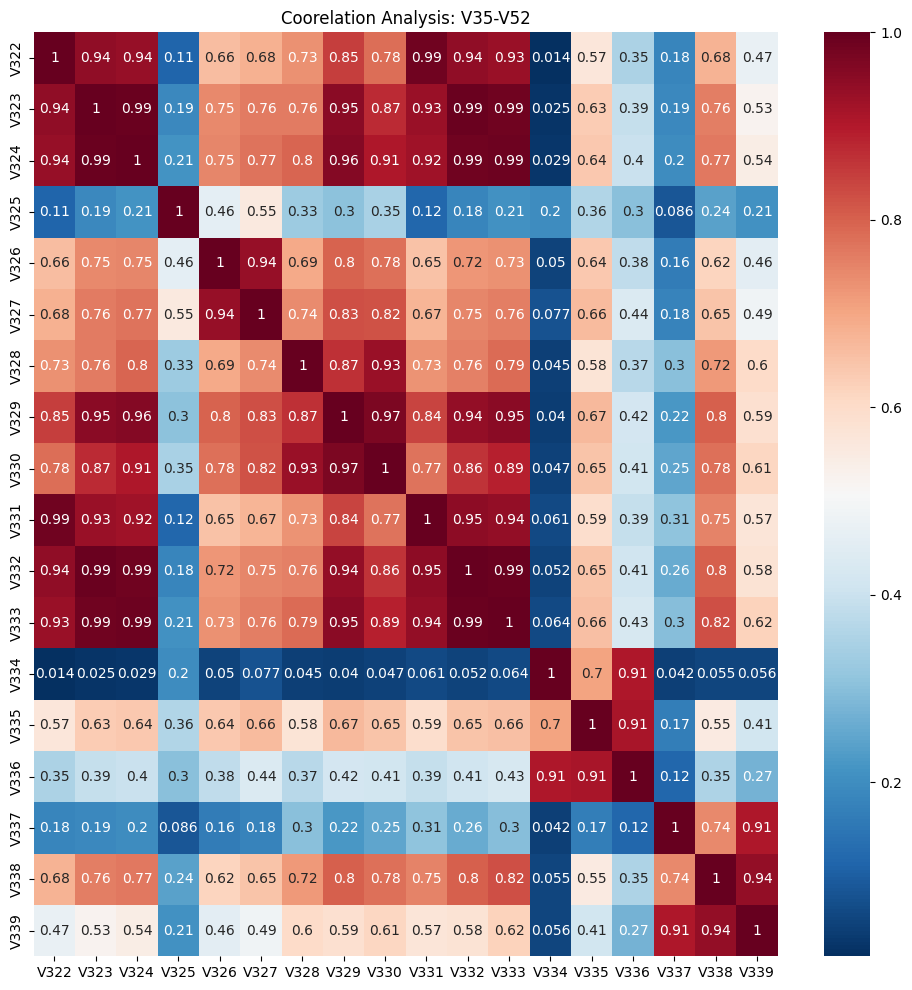

In [13]:
group3 = nan_df.iloc[2]['Column']
print(group3)
coorelation_analysis(cols,title='Coorelation Analysis: V35-V52',size=(12,12))

In [14]:
pairs = [['V35','V36'],['V37','V38'],['V39','V40','V42','V43','V50','V51','V52'],['V41'],
         ['V44','V45'],['V46','V47'],['V48','V49']]

group3_after_reduce = reduce_cols(pairs)
group3_after_reduce

['V36', 'V37', 'V40', 'V41', 'V44', 'V47', 'V48']

['V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', 'V74']


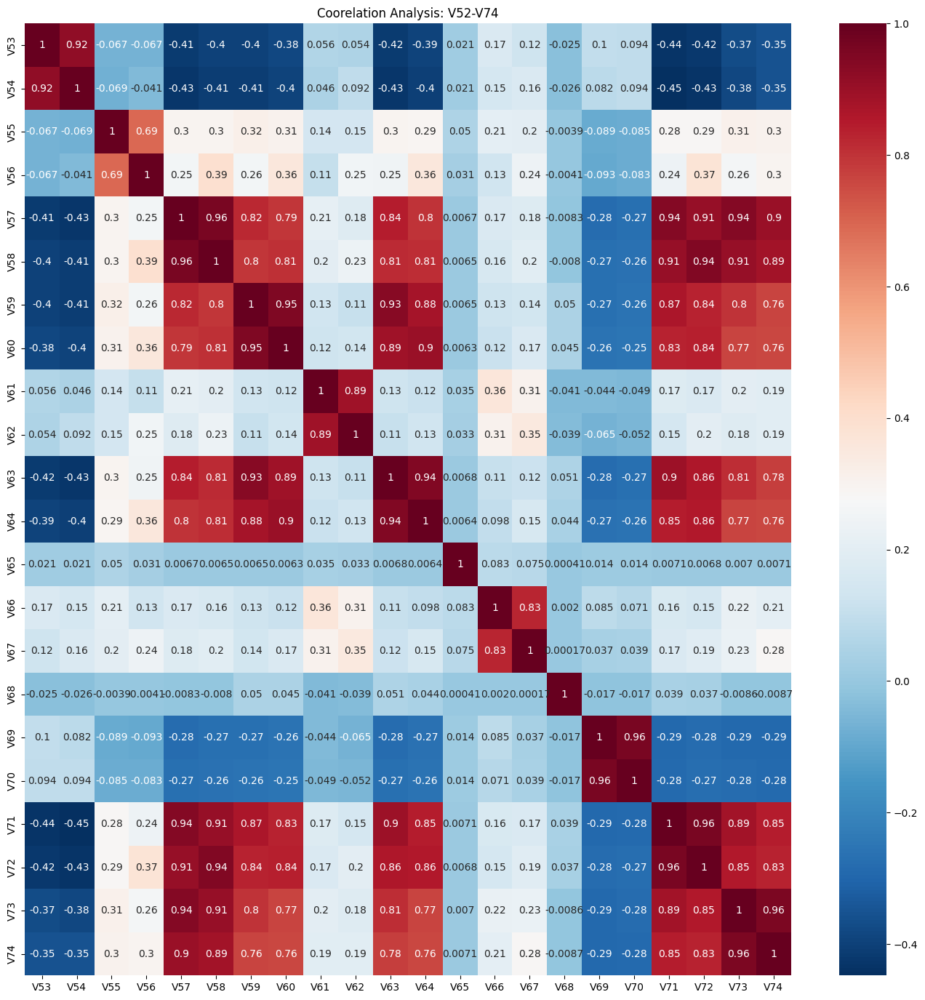

In [15]:
group4 = nan_df.iloc[3]['Column']
print(group4)
coorelation_analysis(group4,title='Coorelation Analysis: V52-V74',size=(17,17))

In [16]:
pairs = [['V53','V54'],['V55'],['V56'],['V57', 'V58', 'V59', 'V60', 'V63', 'V64', 'V71', 'V72', 'V73', 'V74'],['V61','V62'],
['V65'],['V66','V67'],['V68'],['V69','V70']]

group4_after_reduce = reduce_cols(pairs)
group4_after_reduce

['V54', 'V55', 'V56', 'V59', 'V62', 'V65', 'V67', 'V68', 'V70']

['V75', 'V76', 'V77', 'V78', 'V79', 'V80', 'V81', 'V82', 'V83', 'V84', 'V85', 'V86', 'V87', 'V88', 'V89', 'V90', 'V91', 'V92', 'V93', 'V94']


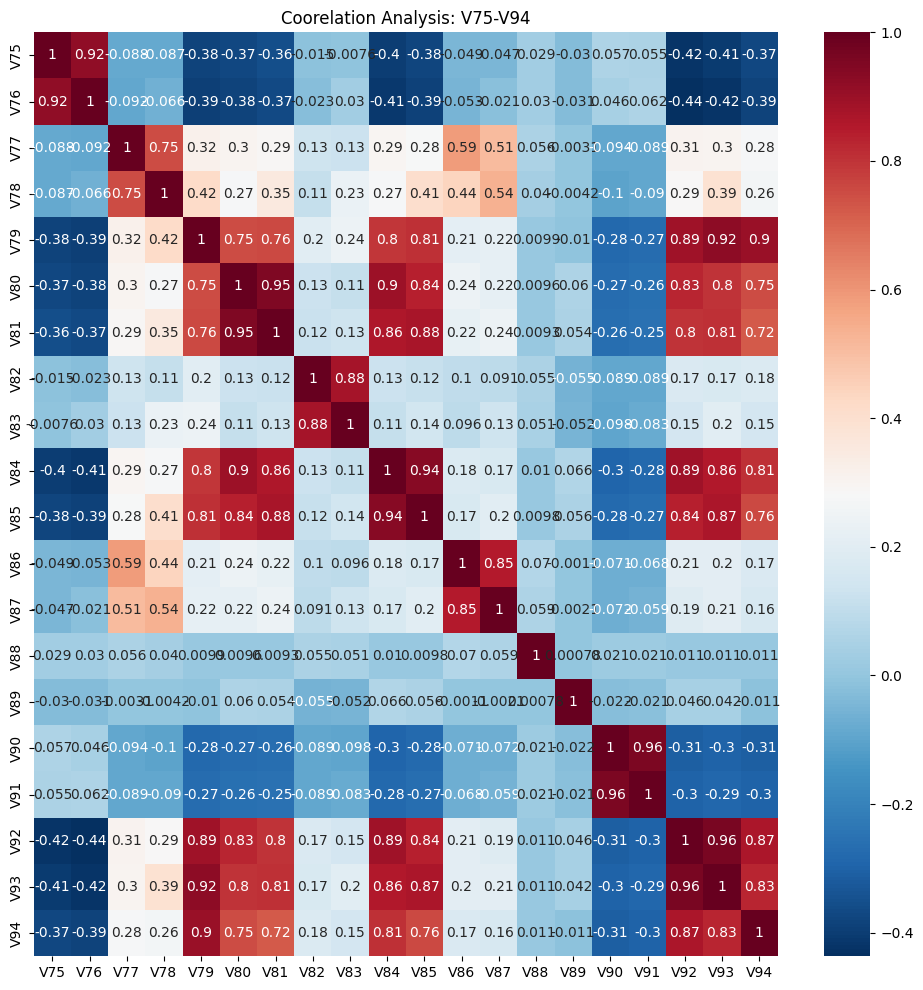

In [17]:
group5 = nan_df.iloc[4]['Column']
print(group5)
coorelation_analysis(group5,title='Coorelation Analysis: V75-V94',size=(12,12))

In [18]:
pairs = [['V75','V76'],['V77','V78'],['V79','V80','V81','V84','V85','V92','V93','V94'],['V82','V83'],['V86','V87'],
         ['V88'],['V89'],['V90','V91']]

group5_after_reduce = reduce_cols(pairs)
group5_after_reduce


['V76', 'V78', 'V80', 'V82', 'V86', 'V88', 'V89', 'V91']

['V95', 'V96', 'V97', 'V98', 'V99', 'V100', 'V101', 'V102', 'V103', 'V104', 'V105', 'V106', 'V107', 'V108', 'V109', 'V110', 'V111', 'V112', 'V113', 'V114', 'V115', 'V116', 'V117', 'V118', 'V119', 'V120', 'V121', 'V122', 'V123', 'V124', 'V125', 'V126', 'V127', 'V128', 'V129', 'V130', 'V131', 'V132', 'V133', 'V134', 'V135', 'V136', 'V137']


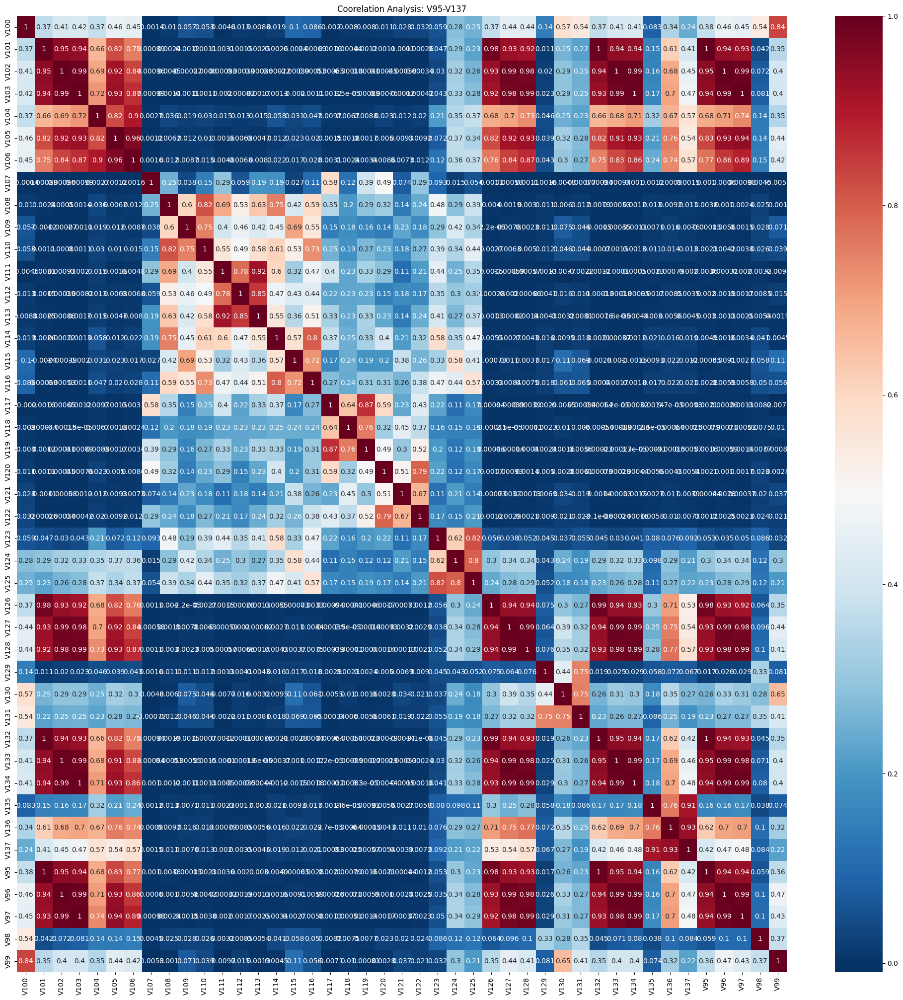

In [19]:
group6 = nan_df.iloc[5]['Column']
print(group6)
coorelation_analysis(group6,title='Coorelation Analysis: V95-V137',size=(25,25))

Text(0.5, 1.0, 'Coorelation Analysis: V124-V137')

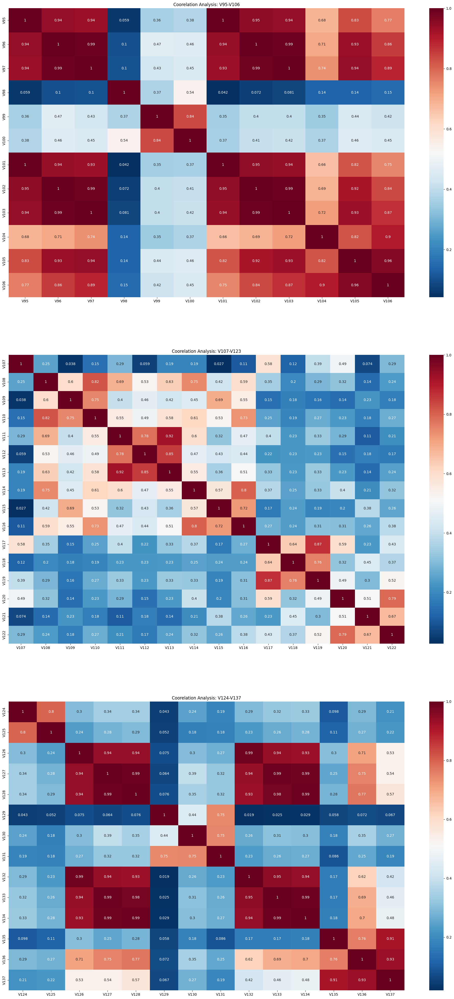

In [20]:
fig,axes = plt.subplots(3,1,figsize=(25,50))
cols1 = ['V'+str(x) for x in range(95,107)]
cols2 = ['V'+str(x) for x in range(107,123)]
cols3 = ['V'+str(x) for x in range(124,138)]

sns.heatmap(df_train[cols1].corr(),annot=True,cmap='RdBu_r',ax=axes[0])
axes[0].set_title('Coorelation Analysis: V95-V106')
sns.heatmap(df_train[cols2].corr(),annot=True,cmap='RdBu_r',ax=axes[1])
axes[1].set_title('Coorelation Analysis: V107-V123')
sns.heatmap(df_train[cols3].corr(),annot=True,cmap='RdBu_r',ax=axes[2])
axes[2].set_title('Coorelation Analysis: V124-V137')

In [21]:
pairs1 = [['V99','V100'],['V98'],['V104'],['V95','V96','V97','V101','V102','V103','V105','V106']]
pairs2 = [['V107'],['V108','V109','V110','V114'],['V111','V112','V113'],['V115','V116'],['V117','V118','V119'],['V120','V122'],['V121'],['V123']]
pairs3 = [['V124','V125'],['V126','V127','V128','V132','V133','V134'],['V129'],['V130','V131'],['V135','V136','V137']]

group6_after_reduce = reduce_cols(pairs1) + reduce_cols(pairs2) + reduce_cols(pairs3)
group6_after_reduce

['V99',
 'V98',
 'V104',
 'V96',
 'V107',
 'V108',
 'V111',
 'V115',
 'V117',
 'V120',
 'V121',
 'V123',
 'V124',
 'V127',
 'V129',
 'V130',
 'V136']

['V138', 'V139', 'V140', 'V141', 'V142', 'V146', 'V147', 'V148', 'V149', 'V153', 'V154', 'V155', 'V156', 'V157', 'V158', 'V161', 'V162', 'V163']


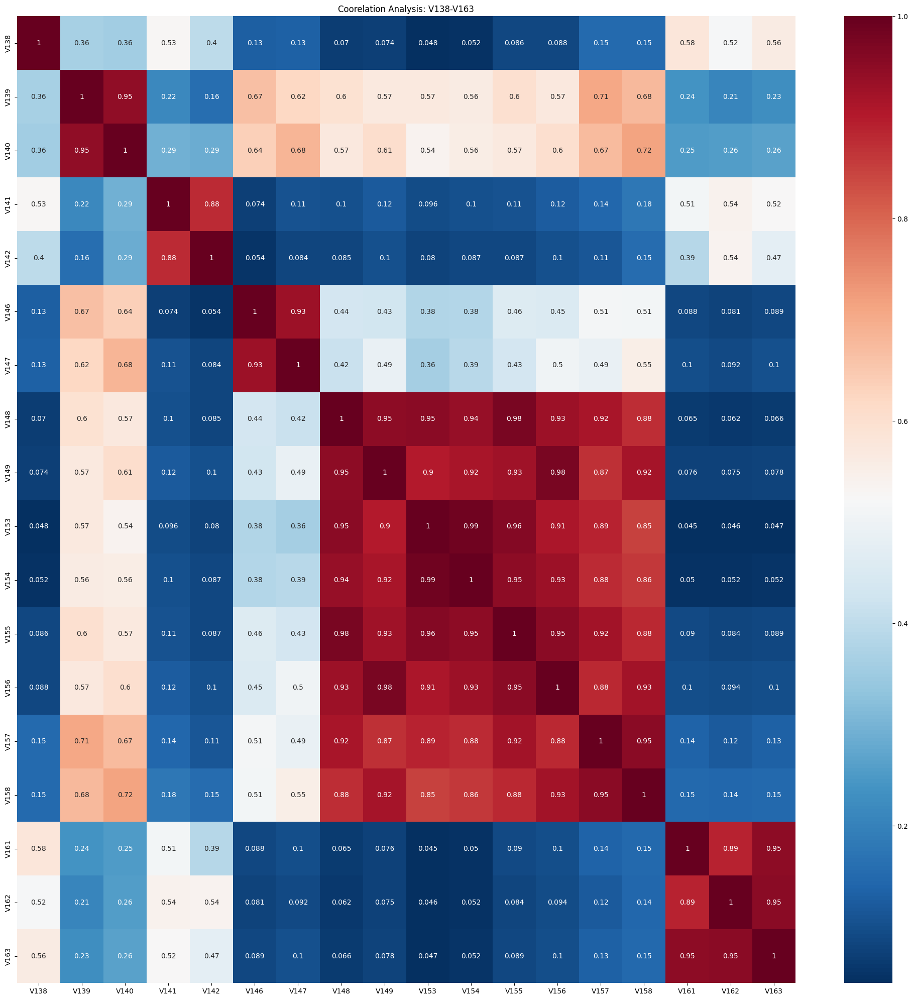

In [22]:
group7 = nan_df.iloc[6]['Column']
print(group7)
coorelation_analysis(group7,title='Coorelation Analysis: V138-V163',size=(25,25))

In [23]:
pairs = [['V138'],['V139','V140'],['V141','V142'],['V146','V147'],['V148','V149','V153','V154','V156','V157','V158'],['V161','V162','V163']]

group7_after_reduce = reduce_cols(pairs)
group7_after_reduce

['V138', 'V139', 'V142', 'V147', 'V156', 'V162']

['V143', 'V144', 'V145', 'V150', 'V151', 'V152', 'V159', 'V160', 'V164', 'V165', 'V166']


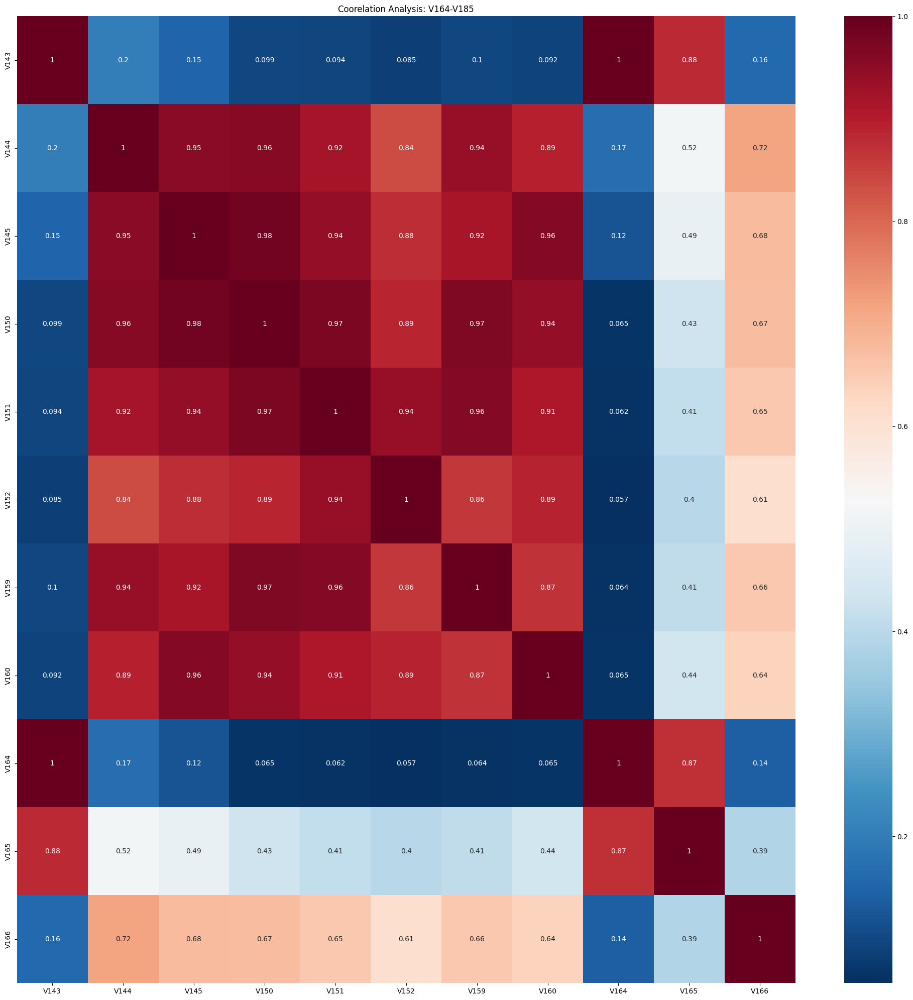

In [24]:
group8 = nan_df.iloc[7]['Column']
print(group8)
coorelation_analysis(group8,title='Coorelation Analysis: V164-V185',size=(25,25))

In [25]:
pairs = [['V143','V164','V165'],['V144','V145','V150','V151','V152','V159','V160'],['V166']]

group8_after_reduce = reduce_cols(pairs)
group8_after_reduce

['V165', 'V160', 'V166']

['V167', 'V168', 'V172', 'V173', 'V176', 'V177', 'V178', 'V179', 'V181', 'V182', 'V183', 'V186', 'V187', 'V190', 'V191', 'V192', 'V193', 'V196', 'V199', 'V202', 'V203', 'V204', 'V205', 'V206', 'V207', 'V211', 'V212', 'V213', 'V214', 'V215', 'V216']


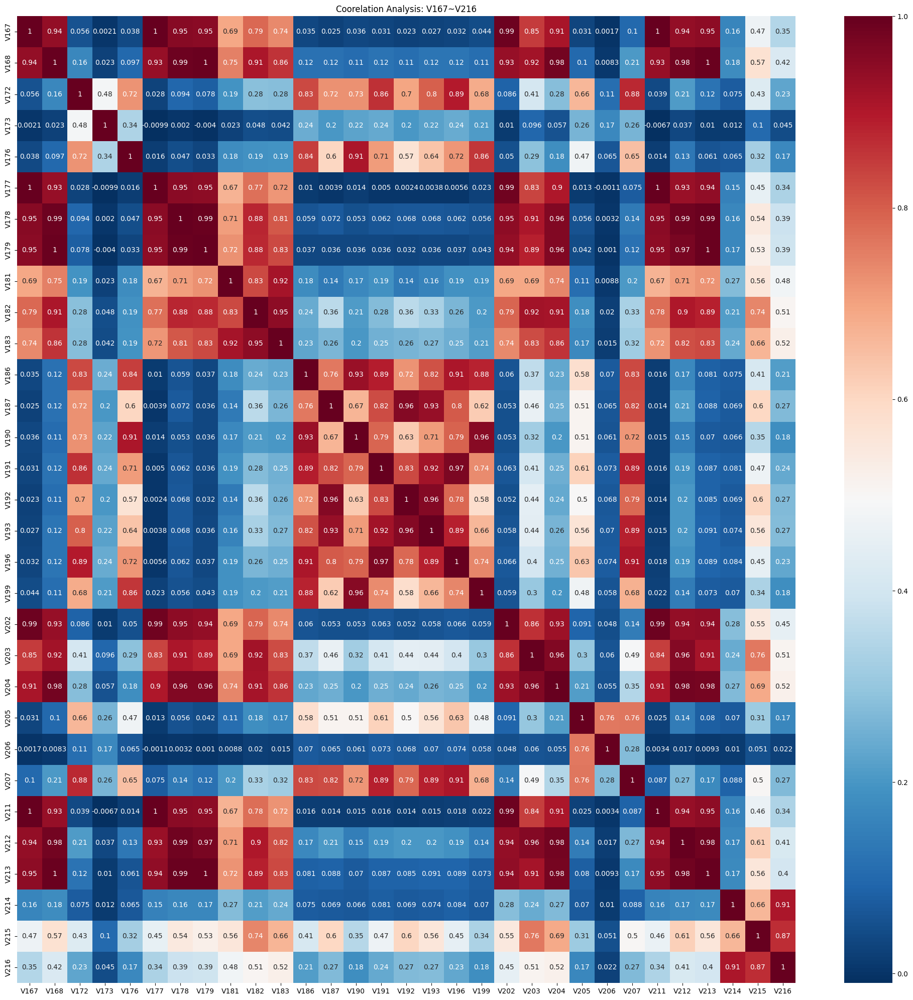

In [26]:
group9 = nan_df.iloc[8]['Column']
print(group9)
coorelation_analysis(group9,title='Coorelation Analysis: V167~V216',size=(25,25))

In [27]:
pairs = [['V167','V168','V177','V178','V179'],['V172','V176'],['V173'],['V181','V182','V183'],['V186','V187','V190','V191','V192','V193','V196','V199'],['V202','V203','V204','V211','V212','V213'],['V205','V206'],['V207'],['V214','V215','V216']]
group9_after_reduce = reduce_cols(pairs)
group9_after_reduce

['V178', 'V176', 'V173', 'V182', 'V187', 'V203', 'V205', 'V207', 'V215']

['V169', 'V170', 'V171', 'V174', 'V175', 'V180', 'V184', 'V185', 'V188', 'V189', 'V194', 'V195', 'V197', 'V198', 'V200', 'V201', 'V208', 'V209', 'V210']


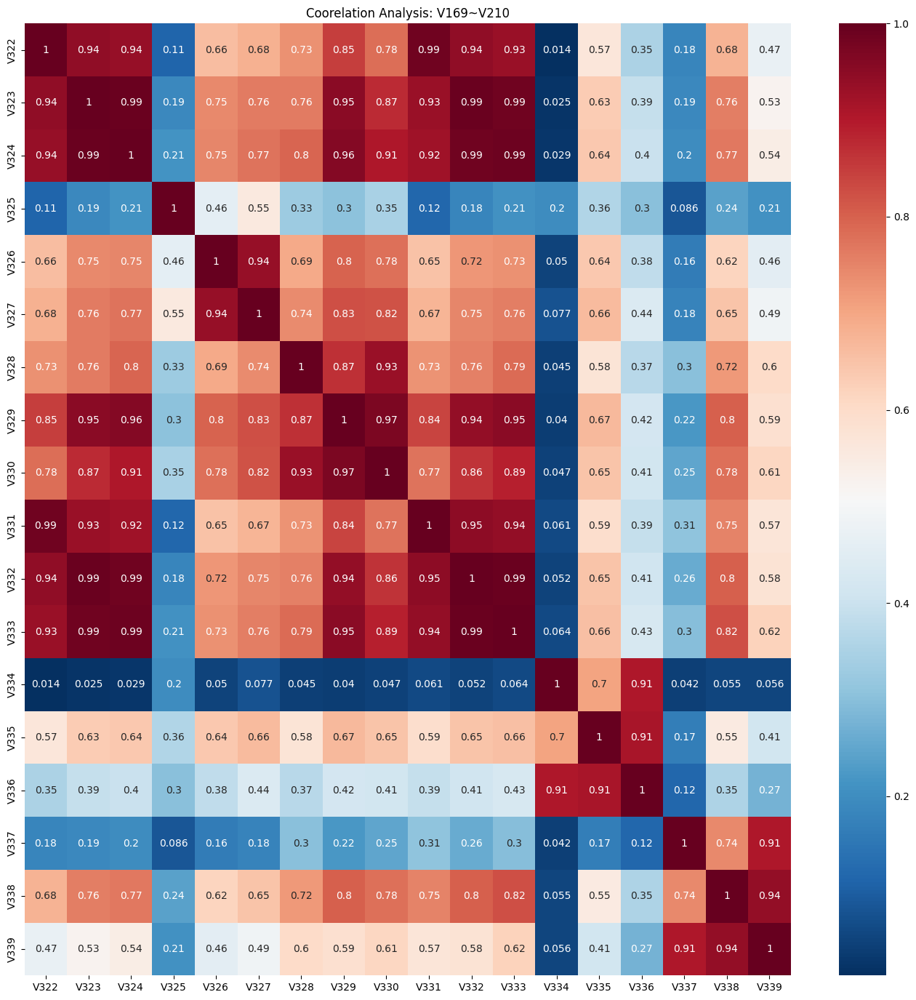

In [28]:
group10 = nan_df.iloc[9]['Column']
print(group10)
coorelation_analysis(cols,title='Coorelation Analysis: V169~V210',size=(17,17))

In [29]:
pairs = [['V169'],['V170','V171','V200','V201'],['V174','V175'],['V180'],['V184','V185'],['V188','V189'],['V194','V195','V197','V198'],['V208','V210'],
         ['V209']]
group10_after_reduce = reduce_cols(pairs)
group10_after_reduce

['V169', 'V171', 'V175', 'V180', 'V185', 'V188', 'V198', 'V210', 'V209']

['V217', 'V218', 'V219', 'V223', 'V224', 'V225', 'V226', 'V228', 'V229', 'V230', 'V231', 'V232', 'V233', 'V235', 'V236', 'V237', 'V240', 'V241', 'V242', 'V243', 'V244', 'V246', 'V247', 'V248', 'V249', 'V252', 'V253', 'V254', 'V257', 'V258', 'V260', 'V261', 'V262', 'V263', 'V264', 'V265', 'V266', 'V267', 'V268', 'V269', 'V273', 'V274', 'V275', 'V276', 'V277', 'V278']


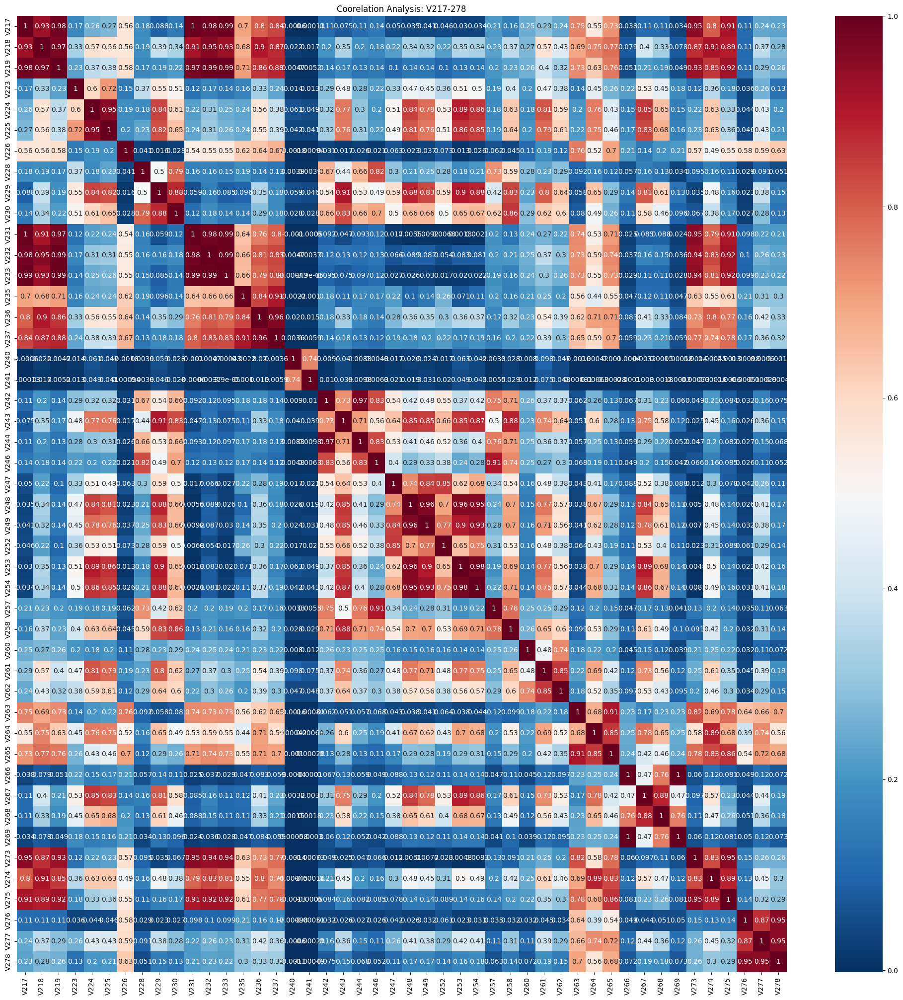

In [30]:
group11 = nan_df.iloc[10]['Column']
print(group11)
coorelation_analysis(group11,title='Coorelation Analysis: V217-278',size=(25,25))

In [31]:
pairs1 = [['V217','V218','V219','V231','V232','V233','V236','V237'],['V223'],['V224','V225'],['V226'],['V228'],['V229','V230'],['V235']]
pairs2 = [['V240','V241'],['V242','V243','V244','V258'],['V246','V257'],['V247','V248','V249','V253','V254'],['V252'],['V260'],['V261','V262']]
pairs3 = [['V263','V265','V264'],['V266','V269'],['V267','V268'],['V273','V274','V275'],['V276','V277','V278']]

group11_after_reduce = reduce_cols(pairs1) + reduce_cols(pairs2) + reduce_cols(pairs3)
group11_after_reduce

['V218',
 'V223',
 'V224',
 'V226',
 'V228',
 'V229',
 'V235',
 'V240',
 'V258',
 'V257',
 'V253',
 'V252',
 'V260',
 'V261',
 'V264',
 'V266',
 'V267',
 'V274',
 'V277']

['V220', 'V221', 'V222', 'V227', 'V234', 'V238', 'V239', 'V245', 'V250', 'V251', 'V255', 'V256', 'V259', 'V270', 'V271', 'V272']


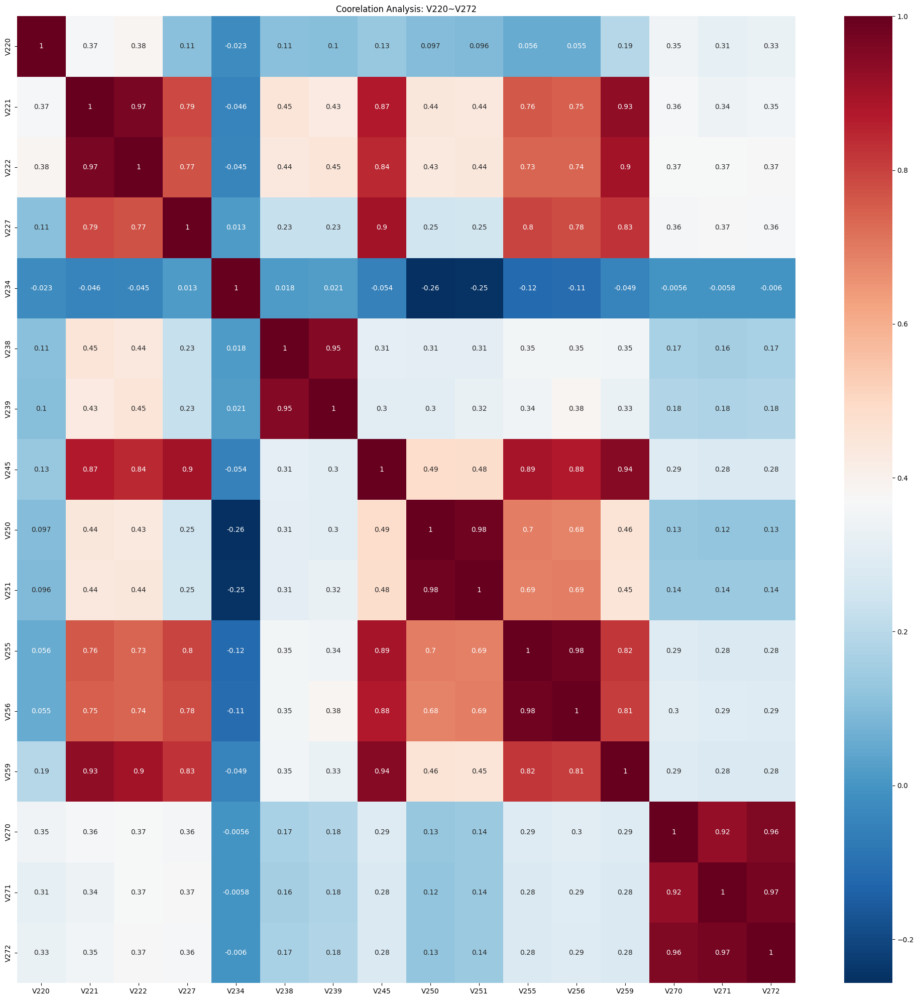

In [32]:
group12 = nan_df.iloc[11]['Column']
print(group12)
coorelation_analysis(group12,title='Coorelation Analysis: V220~V272',size=(25,25))

In [33]:
pairs = [['V220'],['V221','V222','V227','V245','V255','V256','V259'],['V234'],['V238','V239'],
         ['V250','V251'],['V270','V271','V272']]

group12_after_reduce = reduce_cols(pairs)
group12_after_reduce

['V220', 'V221', 'V234', 'V238', 'V250', 'V271']

['V279', 'V280', 'V284', 'V285', 'V286', 'V287', 'V290', 'V291', 'V292', 'V293', 'V294', 'V295', 'V297', 'V298', 'V299', 'V302', 'V303', 'V304', 'V305', 'V306', 'V307', 'V308', 'V309', 'V310', 'V311', 'V312', 'V316', 'V317', 'V318', 'V319', 'V320', 'V321']


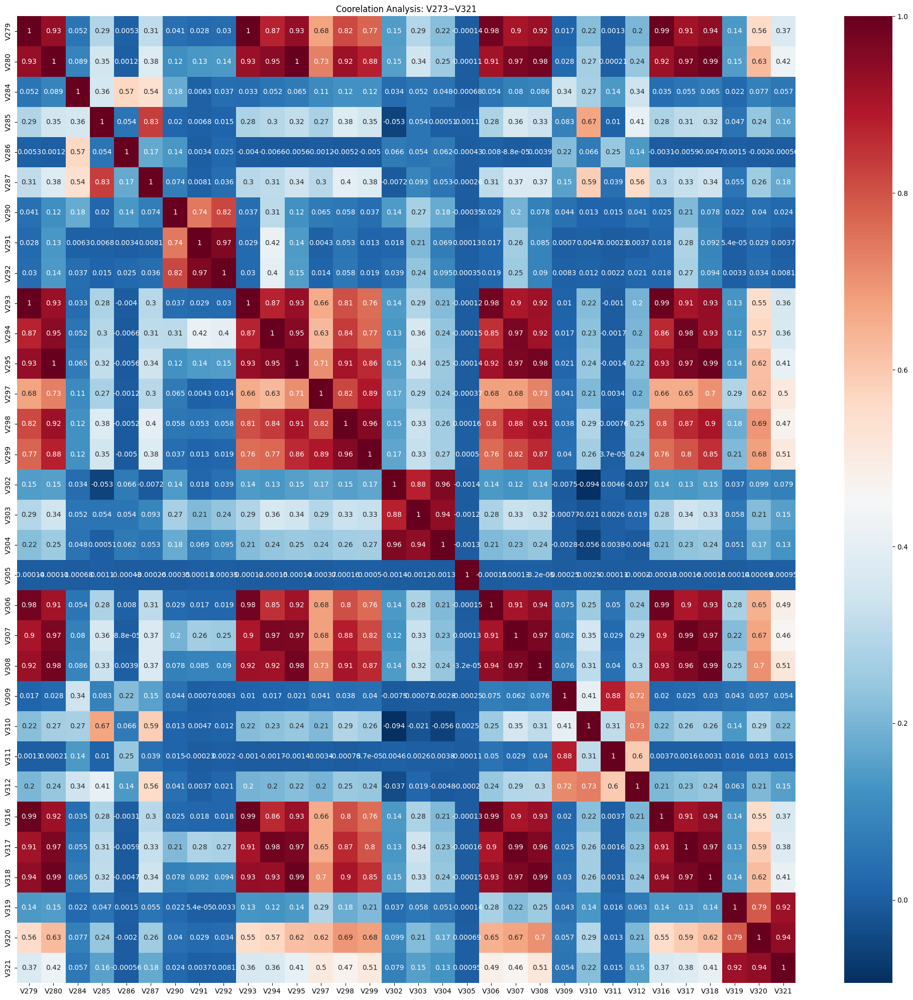

In [34]:
group13 = nan_df.iloc[12]['Column']
print(group13)
coorelation_analysis(group13,title='Coorelation Analysis: V273~V321',size=(25,25))

In [35]:
pairs1 = [['V279','V280','V293','V294','V295','V298','V299'],['V284'],['V285','V287'],['V286'],['V290','V291','V292'],['V297']]
pairs2 = [['V302','V303','V304'],['V305'],['V306','V307','V308','V316','V317','V318'],['V309','V311'],['V310','V312'],['V319','V320','V321']]

group13_after_reduce = reduce_cols(pairs1) + reduce_cols(pairs2)
group13_after_reduce

['V294',
 'V284',
 'V285',
 'V286',
 'V291',
 'V297',
 'V303',
 'V305',
 'V307',
 'V309',
 'V310',
 'V320']

['V281', 'V282', 'V283', 'V288', 'V289', 'V296', 'V300', 'V301', 'V313', 'V314', 'V315']


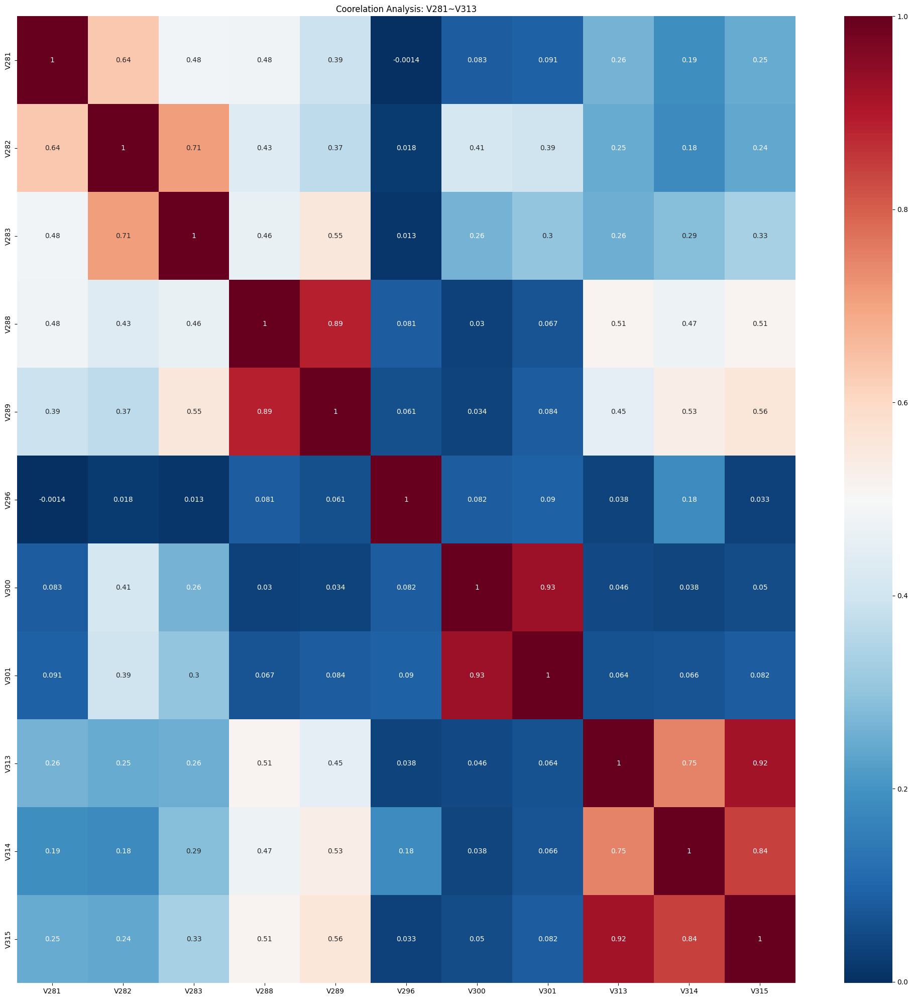

In [36]:
group14 = nan_df.iloc[13]['Column']
print(group14)
coorelation_analysis(group14,title='Coorelation Analysis: V281~V313',size=(25,25))

In [37]:
pairs = [['V281'],['V282','V283'],['V288','V289'],['V296'],['V300','V301'],['V313','V314','V315']]

group14_after_reduce = reduce_cols(pairs)
group14_after_reduce

['V281', 'V283', 'V289', 'V296', 'V301', 'V314']

['V322', 'V323', 'V324', 'V325', 'V326', 'V327', 'V328', 'V329', 'V330', 'V331', 'V332', 'V333', 'V334', 'V335', 'V336', 'V337', 'V338', 'V339']


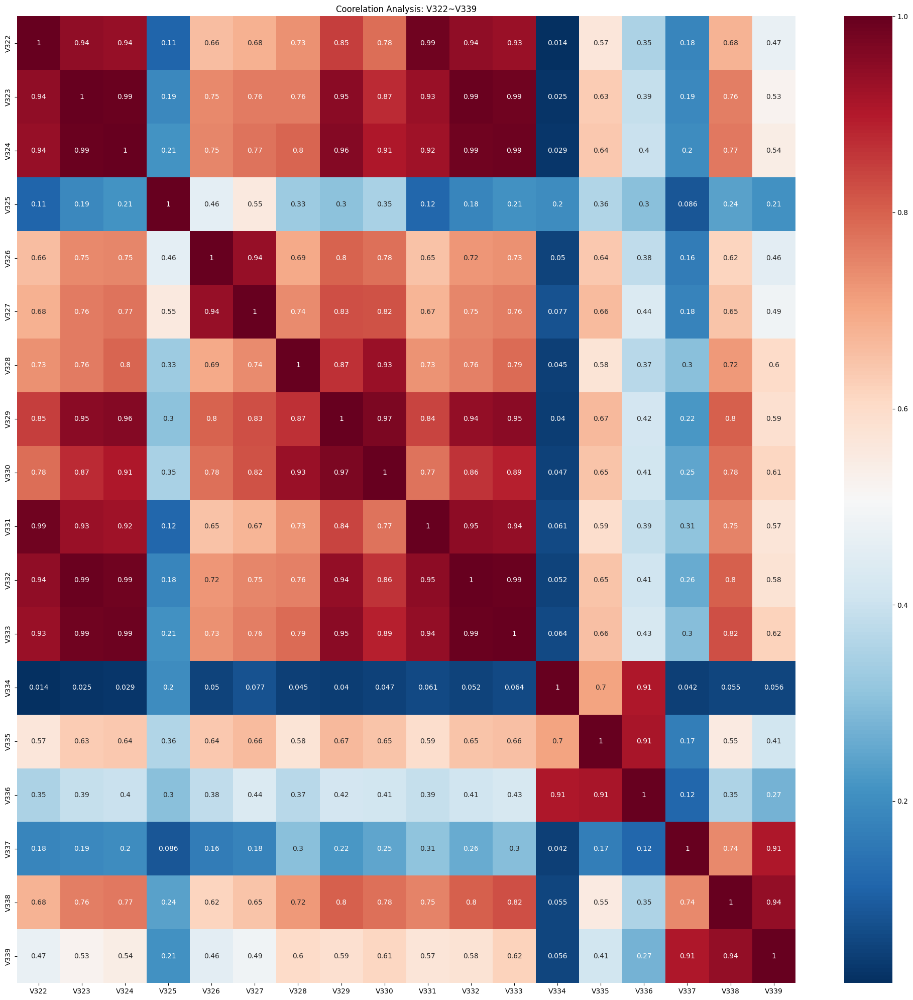

In [38]:
group15 = nan_df.iloc[14]['Column']
print(group15)
coorelation_analysis(group15,title='Coorelation Analysis: V322~V339',size=(25,25))

In [39]:
pairs = [['V322','V323','V324','V326','V327','V328','V329','V330','V331','V332','V333'],['V325'],
         ['V334','V335','V336'],['V337','V338','V339']]

group15_after_reduce = reduce_cols(pairs)
group15_after_reduce

['V332', 'V325', 'V335', 'V338']

129


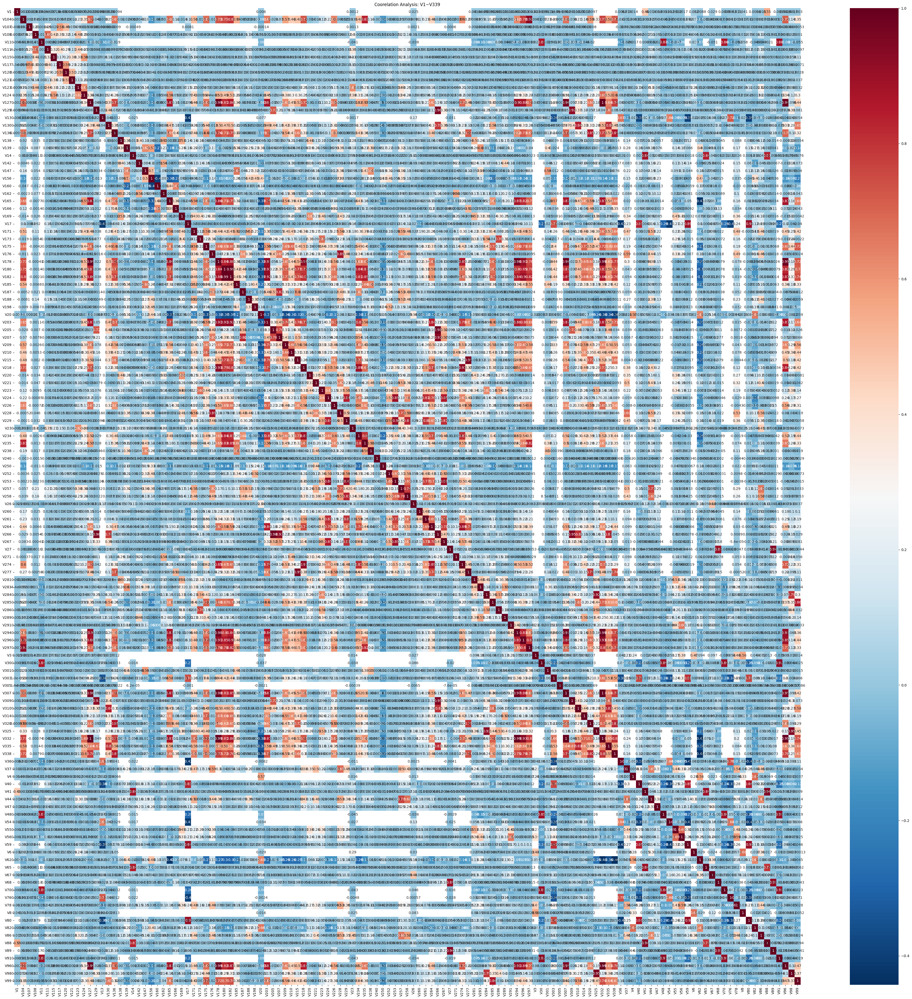

210


In [40]:
reduced_v_cols = group1_after_reduce + group2_after_reduce + group3_after_reduce + group4_after_reduce + group5_after_reduce + group6_after_reduce + group7_after_reduce + group8_after_reduce + group9_after_reduce + group10_after_reduce + group11_after_reduce + group12_after_reduce + group13_after_reduce + group14_after_reduce + group15_after_reduce
print(len(reduced_v_cols))
coorelation_analysis(reduced_v_cols,title='Coorelation Analysis: V1~V339',size=(50,50))
drop_v_cols = [col for col in df_train.columns if col[0] == 'V' and col not in reduced_v_cols]
print(len(drop_v_cols))

# 4. Split Dataset

In [44]:
X_train = df_train.sort_values('TransactionDT').drop(['isFraud', 'TransactionDT', 'TransactionID'], axis=1)
y_train = df_train.sort_values('TransactionDT')['isFraud']
X_test = df_test.sort_values('TransactionDT').drop(['TransactionDT', 'TransactionID'], axis=1)

print(X_train.shape)
print(X_test.shape)

(590540, 431)
(506691, 431)


In [45]:
def clean_inf_nan(df):
    return df.replace([np.inf, -np.inf], np.nan)   

# Cleaning infinite values to NaN
X_train = clean_inf_nan(X_train)
X_test = clean_inf_nan(X_test)

print(X_train.shape)
print(X_test.shape)

(590540, 431)
(506691, 431)


In [43]:
 # Numeric + categorical columns (as before)
num_cols = X_train.select_dtypes(exclude=object).columns.tolist()
cat_cols = ['ProductCD','card1','card2','card3','card4','card5','card6','P_emaildomain','R_emaildomain','M1',
'M2','M3','M4','M5','M6','M7','M8','M9','id_12', 'id_13', 'id_14', 'id_15', 'id_16', 'id_17', 'id_18', 'id_19',
'id_20', 'id_21', 'id_22', 'id_23', 'id_24', 'id_25', 'id_26', 'id_27', 'id_28', 'id_29','addr1','addr2',
'id_30', 'id_31', 'id_32', 'id_33', 'id_34', 'id_35', 'id_36', 'id_37', 'id_38', 'DeviceType', 'DeviceInfo'] 

# Replace OneHotEncoder with OrdinalEncoder (basically LabelEncoding per column)
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median")),
    ("scaler", MinMaxScaler()),
])

# categorical pipeline (ordinal encoding)
categorical_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),
    ("ordinal", OrdinalEncoder(
        handle_unknown="use_encoded_value", 
        unknown_value=-1,
    ))
])

preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, num_cols),
        ("cat", categorical_transformer, cat_cols)
    ]
)

preprocessor

ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('scaler', MinMaxScaler())]),
                                 ['TransactionAmt', 'card1', 'card2', 'card3',
                                  'card5', 'addr1', 'addr2', 'dist1', 'dist2',
                                  'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7',
                                  'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14',
                                  'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', ...]),
                                ('cat',
                                 Pipeline(steps=[(...
                                                  SimpleImputer(strategy='most_frequent')),
                                                 ('ordinal',
                                                  OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                 unknown_value=-1))]),
                                 ['ProductCD', 'card1', 'card2', 'card3',
                                  'card4', 'card5', 'card6', 'P_emaildomain',
                                  'R_emaildomain', 'M1', 'M2', 'M3', 'M4', 'M5',
                                  'M6', 'M7', 'M8', 'M9', 'id_12', 'id_13',
                                  'id_14', 'id_15', 'id_16', 'id_17', 'id_18',
                                  'id_19', 'id_20', 'id_21', 'id_22', 'id_23', ...])])

#### Train 75% in the Past and Predict 25% 

In [54]:
idx_train = X_train.index[:int(X_train.shape[0]*0.75)]  
idx_validation = X_train.index[int(X_train.shape[0]*0.75):]

x_train1,y_train1 = X_train.iloc[idx_train],y_train.iloc[idx_train]
x_cv1,y_cv1 = X_train.iloc[idx_validation],y_train.iloc[idx_validation]

In [55]:
# Fit the preprocessor on the training data
preprocessor.fit(x_train1)

# chi transform tren test
X_train1 = preprocessor.transform(x_train1)
X_cv1 = preprocessor.transform(x_cv1)
X_test1= preprocessor.transform(X_test)

#### 4.1 mRMR

In [ ]:
 # Numeric + categorical columns (as before)
num_cols = X_train.select_dtypes(exclude=object).columns.tolist()
cat_cols = ['ProductCD','card1','card2','card3','card4','card5','card6','P_emaildomain','R_emaildomain','M1',
'M2','M3','M4','M5','M6','M7','M8','M9','id_12', 'id_13', 'id_14', 'id_15', 'id_16', 'id_17', 'id_18', 'id_19',
'id_20', 'id_21', 'id_22', 'id_23', 'id_24', 'id_25', 'id_26', 'id_27', 'id_28', 'id_29','addr1','addr2',
'id_30', 'id_31', 'id_32', 'id_33', 'id_34', 'id_35', 'id_36', 'id_37', 'id_38', 'DeviceType', 'DeviceInfo'] 

# Replace OneHotEncoder with OrdinalEncoder (basically LabelEncoding per column)
preprocessor_fs = ColumnTransformer(
    transformers=[
        ('num', Pipeline([
            ('imputer', SimpleImputer(strategy='median')),
            ('scaler', StandardScaler())
        ]), num_cols),
        ('cat', Pipeline([
            ('imputer', SimpleImputer(strategy='most_frequent')),
            ('ordinal', OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1))
        ]), cat_cols)
    ]
)

# Output as pandas DataFrame for easier feature names
preprocessor_fs.set_output(transform='pandas')

X_train_fs = preprocessor_fs.fit_transform(X_train_)
X_cv_fs    = preprocessor_fs.transform(X_cv_)

print(X_train_fs.shape, X_cv_fs.shape)
print(X_train_fs.head())

# Run mRMR
y_train_series = pd.Series(y_train_, index=X_train_fs.index, name='target')
selected_features = mrmr_classif(X=X_train_fs, y=y_train_series, K=50)
print("Selected features:", selected_features)


(413378, 449) (177162, 449)
        num__TransactionAmt  num__card1  num__card2  num__card3  num__card5  \
335947            -0.262959   -1.625017   -0.016271   -0.282189   -0.814841   
334070            -0.416275    1.486089   -0.265278   -0.282189    0.644195   
551523            -0.266266   -0.834846    0.290200    2.803256    0.595560   
159780            -0.360543   -1.448743   -1.676320   -0.282189    0.644195   
270154            -0.397628    1.596464   -0.399359   -0.282189   -0.814841   

        num__addr1  num__addr2  num__dist1  num__dist2   num__C1  ...  \
335947   -0.206220    0.070027   -0.187772    -0.08652 -0.098986  ...   
334070    0.074929    0.070027   -0.183648    -0.08652 -0.098986  ...   
551523    0.074929    0.070027   -0.183648    -0.08652 -0.098986  ...   
159780    1.553565    0.070027   -0.183648    -0.08652 -0.060818  ...   
270154    0.345665    0.070027    2.653712    -0.08652 -0.098986  ...   

        cat__id_31  cat__id_32  cat__id_33  cat__id_34  ca

100%|██████████| 50/50 [02:00<00:00,  2.40s/it]

Selected features: ['num__V257', 'num__V281', 'num__id_22', 'cat__DeviceType', 'num__V189', 'num__V87', 'num__V242', 'num__V52', 'num__V246', 'num__V45', 'num__V244', 'num__V201', 'num__V283', 'cat__card6', 'num__V86', 'num__V200', 'num__card3', 'num__V158', 'num__id_04', 'num__V258', 'num__V188', 'num__V40', 'num__V44', 'num__V111', 'num__V51', 'num__V239', 'num__V47', 'num__V199', 'num__V228', 'num__V123', 'num__id_01', 'num__id_17', 'num__V170', 'num__V247', 'num__V29', 'num__V171', 'num__V23', 'cat__card3', 'num__V190', 'num__V39', 'num__V156', 'num__V230', 'num__V113', 'num__V38', 'num__V79', 'num__V243', 'num__V147', 'cat__id_17', 'num__V222', 'cat__id_35']


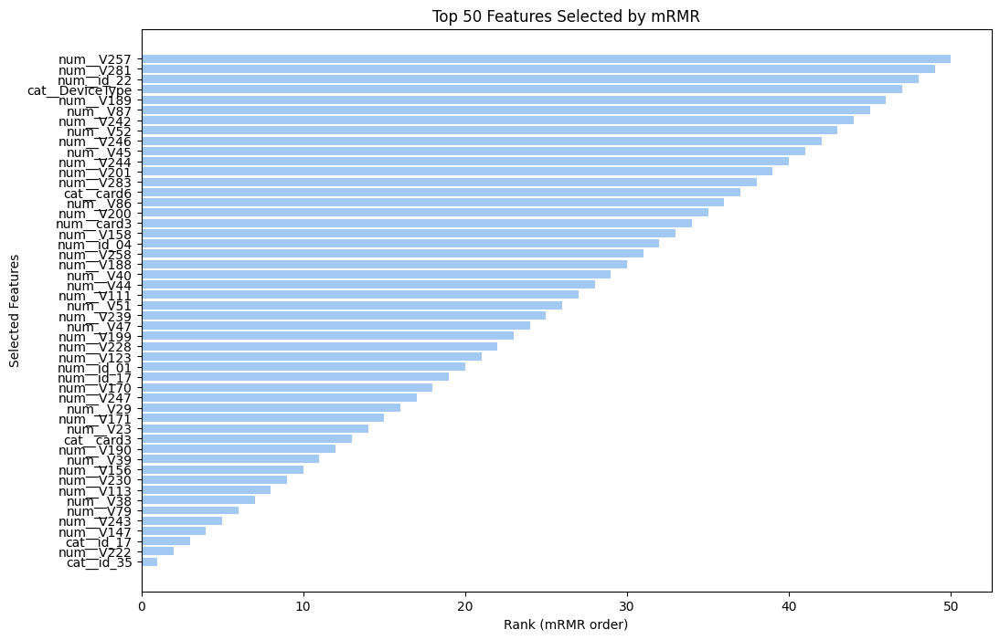

In [13]:
plt.figure(figsize=(12, 8))
plt.barh(range(len(selected_features)), list(range(len(selected_features), 0, -1)))
plt.yticks(range(len(selected_features)), selected_features)
plt.xlabel("Rank (mRMR order)")
plt.ylabel("Selected Features")
plt.title("Top 50 Features Selected by mRMR")
plt.gca().invert_yaxis()  # so best feature is on top
plt.show()

#### 4.2 Unvariate Filter Methods

In [14]:
from sklearn.feature_selection import SelectKBest, f_classif, chi2, mutual_info_classif
from sklearn.preprocessing import MinMaxScaler

# Make sure categorical encodings are numeric & positive for chi2
X_train_fs_chi2 = MinMaxScaler().fit_transform(X_train_fs)  

# --- ANOVA F-test (for continuous numerical features) ---
f_test = SelectKBest(score_func=f_classif, k=50)
f_test.fit(X_train_fs, y_train_series)
anova_scores = pd.Series(f_test.scores_, index=X_train_fs.columns).sort_values(ascending=False)
print("Top features (ANOVA F-test):")
print(anova_scores.head(10))

# --- Chi-Square (for categorical features, needs non-negative input) ---
chi2_test = SelectKBest(score_func=chi2, k=50)
chi2_test.fit(X_train_fs_chi2, y_train_series)
chi2_scores = pd.Series(chi2_test.scores_, index=X_train_fs.columns).sort_values(ascending=False)
print("Top features (Chi2):")
print(chi2_scores.head(10))

# --- Mutual Information (non-linear relationships) ---
mi_test = SelectKBest(score_func=mutual_info_classif, k=50)
mi_test.fit(X_train_fs, y_train_series)
mi_scores = pd.Series(mi_test.scores_, index=X_train_fs.columns).sort_values(ascending=False)
print("Top features (Mutual Info):")
print(mi_scores.head(10))


Top features (ANOVA F-test):
num__V257    35531.503088
num__V246    32841.356002
num__V244    31496.847606
num__V242    30874.736707
num__V201    26830.685843
num__V200    24954.372878
num__V45     24496.679297
num__V189    22414.650117
num__V86     21497.931535
num__V188    21151.178376
dtype: float64
Top features (Chi2):
cat__DeviceType    5004.091773
cat__M4            4862.722486
num__V94           4725.860670
num__V51           2300.836399
num__V79           1776.926983
cat__ProductCD     1593.711103
num__V92           1585.664172
num__V43           1577.749754
num__V50           1577.217128
num__V21           1527.900351
dtype: float64
Top features (Mutual Info):
cat__addr2    0.123662
cat__M9       0.117641
cat__id_34    0.115855
cat__M1       0.114300
cat__M2       0.111080
cat__id_37    0.107827
cat__id_26    0.105860
cat__id_22    0.104250
cat__card3    0.099486
cat__id_17    0.096591
dtype: float64


# 5. Experiment 

In [41]:
def save_submission(X_test, model,name):
    y_pred_test = model.predict_proba(X_test)[:,1]
    submission = pd.read_csv('datasets/sample_submission.csv')
    submission['isFraud'] = y_pred_test
    submission.to_csv(f'submissions/submission_{name}.csv',index=False)

In [42]:
def plot_train_test_roc_and_score(
    y_true_train, y_pred_proba_train,
    y_true_test,  y_pred_proba_test,
    model_name="Model", threshold=0.5
):
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))

    # --- 1) ROC: train vs test on same axes ---
    fpr_tr, tpr_tr, _ = roc_curve(y_true_train, y_pred_proba_train)
    auc_tr = roc_auc_score(y_true_train, y_pred_proba_train)

    fpr_te, tpr_te, _ = roc_curve(y_true_test, y_pred_proba_test)
    auc_te = roc_auc_score(y_true_test, y_pred_proba_test)

    axes[0].plot(fpr_tr, tpr_tr, label=f"Train AUC = {auc_tr:.4f}")
    axes[0].plot(fpr_te, tpr_te, label=f"Test AUC = {auc_te:.4f}")
    axes[0].plot([0, 1], [0, 1], "k--", label="Random")
    axes[0].set_xlabel("False Positive Rate")
    axes[0].set_ylabel("True Positive Rate")
    axes[0].set_title(f"ROC Curve — {model_name}")
    axes[0].legend(loc="lower right")

    # --- 2) Probability score distribution (test) ---
    df_rank = pd.DataFrame({"label": y_true_test, "score": y_pred_proba_test})
    sns.kdeplot(data=df_rank, x="score", hue="label", common_norm=True,
                multiple="fill", ax=axes[1])
    axes[1].set_xlim(0, 1)
    axes[1].set_ylim(0, 1)
    axes[1].set_title("Test Probability Score Distribution by True Label")

    # --- 3) Confusion matrix (test, at threshold) ---
    y_pred_test = (y_pred_proba_test >= threshold).astype(int)
    cm = confusion_matrix(y_true_test, y_pred_test)
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False,
                xticklabels=["Pred 0", "Pred 1"],
                yticklabels=["True 0", "True 1"],
                ax=axes[2])
    axes[2].set_title(f"Test Confusion Matrix (threshold={threshold:.2f})")
    axes[2].set_xlabel("Predicted Label")
    axes[2].set_ylabel("True Label")

    plt.tight_layout()
    plt.show()


## Experiment 1 : BaseLine Model

### Logistic Regression

AUC of Logistic Regression: 0.819380449383949


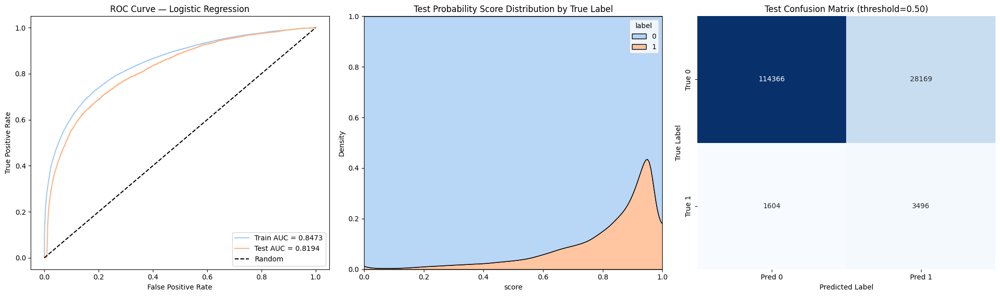

In [59]:
model_lr = LogisticRegression(solver='liblinear',class_weight='balanced')
model_lr.fit(X_train1,y_train1)
y_pred_proba_lr = model_lr.predict_proba(X_cv1)[:,1]
auc_lr = roc_auc_score(y_cv1,y_pred_proba_lr)
print(f"AUC of Logistic Regression: {auc_lr}")

plot_train_test_roc_and_score(y_train1,model_lr.predict_proba(X_train1)[:,1],y_cv1,model_lr.predict_proba(X_cv1)[:,1],model_name="Logistic Regression")

### XGBoost

In [62]:
params = {'n_estimators':[1000,2000],'max_depth':[3,6,12],'subsample':[0.4,0.8]}

clf = XGBClassifier( 
        missing=-1, learning_rate=0.02,
        eval_metric='auc', tree_method='hist',colsample_bytree=0.4)

model = RandomizedSearchCV(estimator=clf, param_distributions=params, scoring='roc_auc', verbose=1, cv=5, n_iter=6)
model.fit(X_train1,y_train1)

Fitting 5 folds for each of 6 candidates, totalling 30 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=0.4, device=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric='auc',
                                           feature_types=None,
                                           feature_weights=None, gamma=None,
                                           grow_policy=None,
                                           importance_type=None,
                                           interaction_constrain...
                                           max_cat_threshold=None,
                                           max_cat_to_onehot=None,
                                           max_delta_step=None, max_depth=None,
                                           max_leaves=None,
                                           min_child_weight=None, missing=-1,
                                           monotone_constraints=None,
                                           multi_strategy=None,
                                           n_estimators=None, n_jobs=None,
                                           num_parallel_tree=None, ...),
                   n_iter=6,
                   param_distributions={'max_depth': [3, 6, 12],
                                        'n_estimators': [1000, 2000],
                                        'subsample': [0.4, 0.8]},
                   scoring='roc_auc', verbose=1)

In [63]:
model.best_params_

{'subsample': 0.4, 'n_estimators': 1000, 'max_depth': 12}

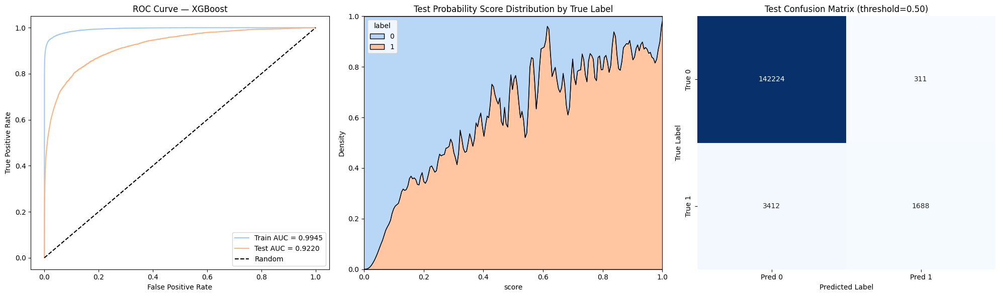

In [64]:
model = XGBClassifier( 
        missing=-1, learning_rate=0.02,
        eval_metric='auc', tree_method='hist',colsample_bytree=0.4,max_depth=12,n_estimators=1000,subsample=0.4)
model.fit(X_train1,y_train1)
y_train_pred = model.predict(X_train1)
y_test_pred = model.predict(X_cv1)

plot_train_test_roc_and_score(y_train1,model.predict_proba(X_train1)[:,1],y_cv1,model.predict_proba(X_cv1)[:,1],model_name="XGBoost")

### RandomForest

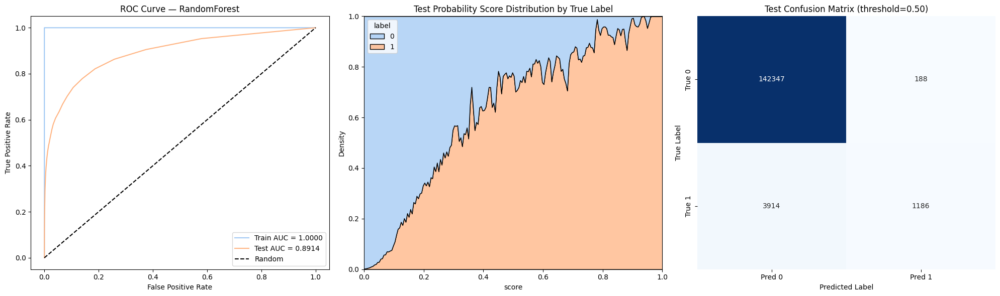

In [70]:
model_rf =  RandomForestClassifier(n_jobs = -1, class_weight = 'balanced')
model_rf.fit(X_train1, y_train1)

plot_train_test_roc_and_score(y_train1,model_rf.predict_proba(X_train1)[:,1],y_cv1,model_rf.predict_proba(X_cv1)[:,1],model_name="RandomForest")

### LightXGM

[LightGBM] [Info] Number of positive: 15563, number of negative: 427342
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.120506 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 35400
[LightGBM] [Info] Number of data points in the train set: 442905, number of used features: 444
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035138 -> initscore=-3.312688
[LightGBM] [Info] Start training from score -3.312688


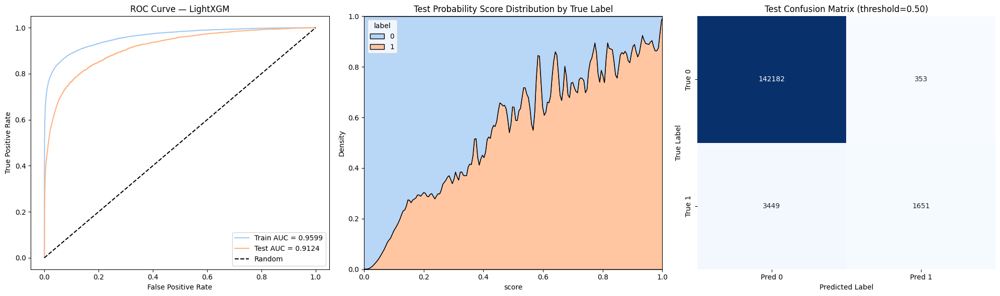

In [72]:
model_lgb = LGBMClassifier(
    n_estimators=1000,
    learning_rate=0.02,
    max_depth=12,
    subsample=0.8,
    colsample_bytree=0.4,
)
model_lgb.fit(X_train1,y_train1)

plot_train_test_roc_and_score(y_train1,model_lgb.predict_proba(X_train1)[:,1],y_cv1,model_lgb.predict_proba(X_cv1)[:,1],model_name="LightXGM")

Overall `XGBoost`, `LightXGM` and `CatBoost` performs well so we can stick to these model 

## Experiment 2 : Featured Data Scientist

### V-cols 

#### Drop V-Cols 

In [46]:
X_train_drop_v = X_train.drop(drop_v_cols,axis=1)
X_test_drop_v = X_test.drop(drop_v_cols,axis=1)

X_train_drop_v.head()

,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,68.5,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,29.0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,59.0,W,4663,490.0,150.0,visa,166.0,debit,330.0,87.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,50.0,W,18132,567.0,150.0,mastercard,117.0,debit,476.0,87.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,50.0,H,4497,514.0,150.0,mastercard,102.0,credit,420.0,87.0,...,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M


In [47]:
print(X_train_drop_v.shape)
print(X_test_drop_v.shape)

(590540, 221)
(506691, 221)


In [48]:
num_cols = X_train_drop_v.select_dtypes(exclude=object).columns.tolist()
cat_cols = ['ProductCD','card1','card2','card3','card4','card5','card6','P_emaildomain','R_emaildomain','M1',
'M2','M3','M4','M5','M6','M7','M8','M9','id_12', 'id_13', 'id_14', 'id_15', 'id_16', 'id_17', 'id_18', 'id_19',
'id_20', 'id_21', 'id_22', 'id_23', 'id_24', 'id_25', 'id_26', 'id_27', 'id_28', 'id_29','addr1','addr2',
'id_30', 'id_31', 'id_32', 'id_33', 'id_34', 'id_35', 'id_36', 'id_37', 'id_38', 'DeviceType', 'DeviceInfo'] 

# Replace OneHotEncoder with OrdinalEncoder (basically LabelEncoding per column)
numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median")),
    ("scaler", MinMaxScaler()),
])

# categorical pipeline (ordinal encoding)
categorical_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),
    ("ordinal", OrdinalEncoder(
        handle_unknown="use_encoded_value", 
        unknown_value=-1,
    ))
])

preprocessor2 = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, num_cols),
        ("cat", categorical_transformer, cat_cols)
    ]
)

preprocessor2

ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('scaler', MinMaxScaler())]),
                                 ['TransactionAmt', 'card1', 'card2', 'card3',
                                  'card5', 'addr1', 'addr2', 'dist1', 'dist2',
                                  'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7',
                                  'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14',
                                  'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', ...]),
                                ('cat',
                                 Pipeline(steps=[(...
                                                  SimpleImputer(strategy='most_frequent')),
                                                 ('ordinal',
                                                  OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                 unknown_value=-1))]),
                                 ['ProductCD', 'card1', 'card2', 'card3',
                                  'card4', 'card5', 'card6', 'P_emaildomain',
                                  'R_emaildomain', 'M1', 'M2', 'M3', 'M4', 'M5',
                                  'M6', 'M7', 'M8', 'M9', 'id_12', 'id_13',
                                  'id_14', 'id_15', 'id_16', 'id_17', 'id_18',
                                  'id_19', 'id_20', 'id_21', 'id_22', 'id_23', ...])])

In [47]:
idx_train_drop_v = X_train_drop_v.index[:int(X_train_drop_v.shape[0]*0.75)]  
idx_validation_drop_v = X_train_drop_v.index[int(X_train_drop_v.shape[0]*0.75):]

x_train_drop_v,y_train_drop_v = X_train_drop_v.iloc[idx_train_drop_v],y_train.iloc[idx_train_drop_v]
x_cv_drop_v,y_cv_drop_v = X_train_drop_v.iloc[idx_validation_drop_v],y_train.iloc[idx_validation_drop_v]

In [48]:
preprocessor2.fit(x_train_drop_v)
X_train_drop_v_ = preprocessor2.transform(x_train_drop_v)
X_cv_drop_v_ = preprocessor2.transform(x_cv_drop_v)
X_test_drop_v_ = preprocessor2.transform(X_test_drop_v)

print(X_train_drop_v_.shape)
print(X_test_drop_v_.shape)


(442905, 239)
(506691, 239)


In [49]:
clf = XGBClassifier(
    n_estimators=650,
    max_depth=12, 
    learning_rate=0.02, 
    subsample=0.8,
    colsample_bytree=0.4, 
    missing=-1, 
    eval_metric='auc',
    tree_method='hist',
)

model_xgb = clf.fit(
    X_train_drop_v_, y_train_drop_v,
    eval_set=[(X_cv_drop_v_, y_cv_drop_v)],
    verbose=50,
)

[0]	validation_0-auc:0.78649
[50]	validation_0-auc:0.89042
[100]	validation_0-auc:0.90258
[150]	validation_0-auc:0.90983
[200]	validation_0-auc:0.91580
[250]	validation_0-auc:0.91888
[300]	validation_0-auc:0.92106
[350]	validation_0-auc:0.92261
[400]	validation_0-auc:0.92340
[450]	validation_0-auc:0.92448
[500]	validation_0-auc:0.92508
[550]	validation_0-auc:0.92543
[600]	validation_0-auc:0.92543
[649]	validation_0-auc:0.92564


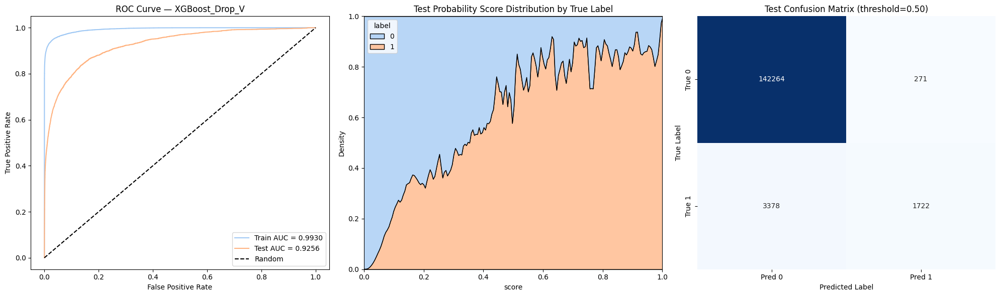

In [53]:
plot_train_test_roc_and_score(y_train_drop_v,model_xgb.predict_proba(X_train_drop_v_)[:,1],y_cv_drop_v,model_xgb.predict_proba(X_cv_drop_v_)[:,1],model_name="XGBoost_Drop_V")

In [ ]:
save_submission(X_test_drop_v_,model_xgb, 'XGBoost_Reduced_V')

[LightGBM] [Info] Number of positive: 15563, number of negative: 427342
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.061718 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 21074
[LightGBM] [Info] Number of data points in the train set: 442905, number of used features: 234
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035138 -> initscore=-3.312688
[LightGBM] [Info] Start training from score -3.312688


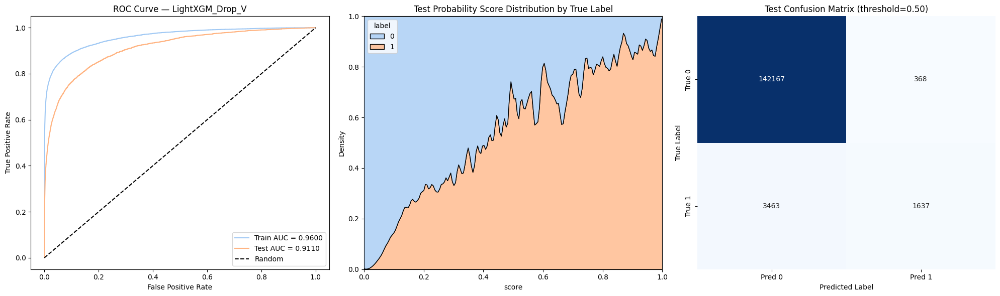

In [54]:
model_lgb = LGBMClassifier(
    n_estimators=1000,
    learning_rate=0.02,
    max_depth=12,
    subsample=0.8,
    colsample_bytree=0.4,
)
model_lgb.fit(X_train_drop_v_,y_train_drop_v)

plot_train_test_roc_and_score(y_train_drop_v,model_lgb.predict_proba(X_train_drop_v_)[:,1],y_cv_drop_v,model_lgb.predict_proba(X_cv_drop_v_)[:,1],model_name="LightXGM_Drop_V")

#### PCA 

In [ ]:
from sklearn.decomposition import PCA

# Impute missing values for V columns
v_imputer = SimpleImputer(strategy='median')
X_train_v_imputed = v_imputer.fit_transform(x_train1[v_cols])
X_cv_v_imputed = v_imputer.transform(x_cv1[v_cols])
X_test_v_imputed = v_imputer.transform(X_test[v_cols])

# Apply PCA
pca = PCA(n_components=10, random_state=42)  # Adjust n_components
X_train_pca = pca.fit_transform(X_train_v_imputed)
X_cv_pca = pca.transform(X_cv_v_imputed)
X_test_pca = pca.transform(X_test_v_imputed)

# Add PCA components to datasets
for i in range(10):
    x_train1[f'V_pca_{i}'] = X_train_pca[:, i]
    x_cv1[f'V_pca_{i}'] = X_cv_pca[:, i]
    X_test[f'V_pca_{i}'] = X_test_pca[:, i]

# Optionally drop original V columns
X_train_after_pca = x_train1.drop(columns=v_cols)
X_cv_after_pca = x_cv1.drop(columns=v_cols)
X_test_after_pca = X_test.drop(columns=v_cols)

print(f"Explained variance ratio: {pca.explained_variance_ratio_.sum():.4f}")

Explained variance ratio: 0.9998


In [ ]:
pca_cols = [f'V_pca_{i}' for i in range(10)]  # Adjust based on your PCA components
other_num_cols = [col for col in X_train_after_pca.columns if col not in pca_cols and col.startswith('V') == False and X_train_after_pca[col].dtype in ['float64', 'int64']]
cat_cols = X_train_after_pca.select_dtypes(include=['object']).columns

# Define preprocessor for non-PCA columns
preprocessor_pca = ColumnTransformer(
    transformers=[
        ('num', Pipeline([
            ('imputer', SimpleImputer(strategy='median')),
            ('scaler', StandardScaler())
        ]), other_num_cols),
        ('cat', Pipeline([
            ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
            ('encoder', OneHotEncoder(handle_unknown='ignore', sparse_output=False))
        ]), cat_cols)
    ],
    remainder='passthrough'  # Keep PCA columns (V_pca_0 to V_pca_9) as is
)

In [ ]:
preprocessor_pca.fit(X_train_after_pca)
X_train_pca_ = preprocessor_pca.transform(X_train_after_pca)
X_cv_pca_ = preprocessor_pca.transform(X_cv_after_pca)
X_test_pca_ = preprocessor_pca.transform(X_test_after_pca)

In [ ]:
clf = XGBClassifier(
    n_estimators=800,
    max_depth=12, 
    learning_rate=0.02, 
    subsample=0.8,
    colsample_bytree=0.4, 
    missing=-1, 
    eval_metric='auc',
    tree_method='hist',
)

model_xgb = clf.fit(
    X_train_pca_, y_train1,
    eval_set=[(X_cv_pca_, y_cv1)],
    verbose=50,
)


[0]	validation_0-auc:0.81484
[50]	validation_0-auc:0.89333
[100]	validation_0-auc:0.90287
[150]	validation_0-auc:0.90997
[200]	validation_0-auc:0.91484
[250]	validation_0-auc:0.91763
[300]	validation_0-auc:0.91938
[350]	validation_0-auc:0.92081
[400]	validation_0-auc:0.92166
[450]	validation_0-auc:0.92253
[500]	validation_0-auc:0.92312
[550]	validation_0-auc:0.92363
[600]	validation_0-auc:0.92415
[650]	validation_0-auc:0.92478
[700]	validation_0-auc:0.92502
[750]	validation_0-auc:0.92520
[799]	validation_0-auc:0.92546


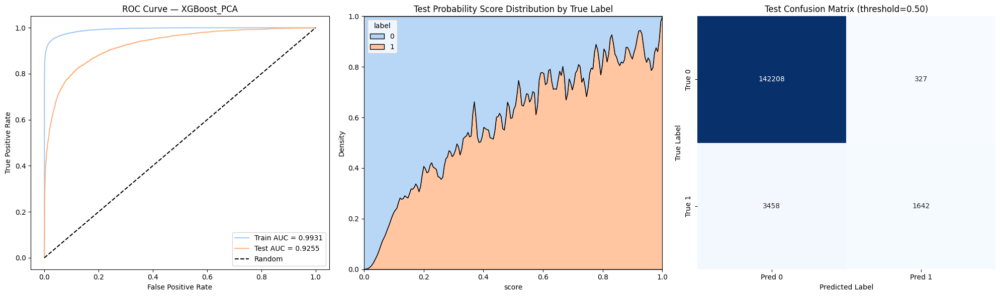

In [ ]:
plot_train_test_roc_and_score(y_train1,model_xgb.predict_proba(X_train_pca_)[:,1],y_cv1,model_xgb.predict_proba(X_cv_pca_)[:,1],model_name="XGBoost_PCA")

In [ ]:
save_submission(X_test_pca_,model_xgb, 'XGBoost_PCA')

**Comment:**
- Both methods (Dropping based on NaN and Correlation and PCA) have the same score so I choose the first one to preserve the original feature meanings.
- By keeping only the meaningful, non-redundant original features, we retain interpretability and can better explain the model’s results and feature importance.

In [49]:
df_train = df_train.drop(drop_v_cols,axis = 1)
df_test = df_test.drop(drop_v_cols,axis = 1) 

### TransactionDay

In [50]:
df_train['Day'] = df_train['TransactionDT']//(60*60*24)
df_test['Day'] = df_test['TransactionDT']//(60*60*24)

df_train['Day'] = df_train['Day'].astype(int)
df_test['Day'] = df_test['Day'].astype(int)
df_train['Day']


0           1
1           1
2           1
3           1
4           1
         ... 
590535    182
590536    182
590537    182
590538    182
590539    182
Name: Day, Length: 590540, dtype: int64

### Transaction Months

In [53]:
df_train['TransactionMonth'] = (df_train['TransactionDT']//(60*60*24*30))%12
df_test['TransactionMonth'] = (df_test['TransactionDT']//(60*60*24*30))%12

df_train['TransactionMonth'] = df_train['TransactionMonth'].astype(int)
df_test['TransactionMonth'] = df_test['TransactionMonth'].astype(int)


In [54]:
percentage_fraud_by_month = df_train[['TransactionMonth','isFraud']].groupby('TransactionMonth').mean().reset_index().rename(columns={'isFraud':'Percentage fraud transactions'})
count_transactions_by_month = df_train[['TransactionMonth','TransactionID']].groupby('TransactionMonth').count().reset_index().rename(columns={'TransactionID':'Number of transactions'})
percentage_fraud_by_month = percentage_fraud_by_month.merge(count_transactions_by_month,on='TransactionMonth')

percentage_fraud_by_month.head()

,TransactionMonth,Percentage fraud transactions,Number of transactions
0,0,0.024762,130968
1,1,0.040373,89838
2,2,0.040319,91768
3,3,0.039265,98027
4,4,0.034723,85303


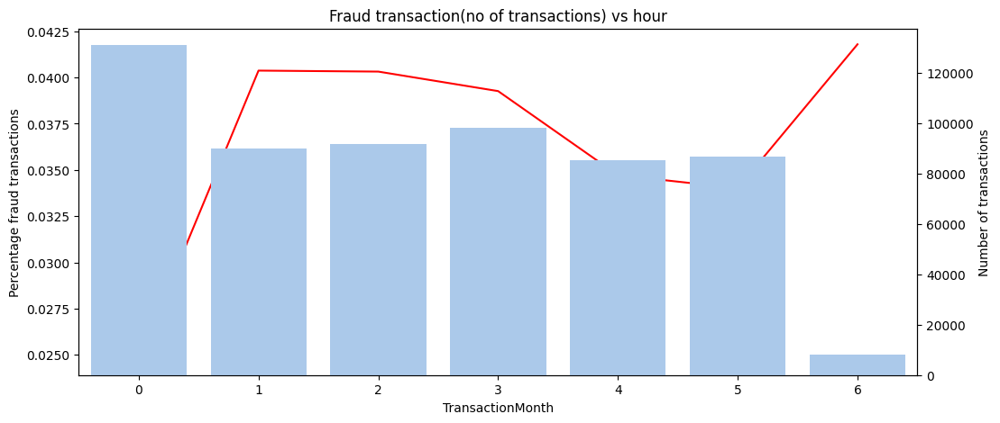

In [55]:
fig, axes = plt.subplots(figsize=(12,5))
axes = sns.lineplot(x=percentage_fraud_by_month['TransactionMonth'],y=percentage_fraud_by_month['Percentage fraud transactions'],color='r')
axes2 = axes.twinx()
axes2 = sns.barplot(x=percentage_fraud_by_month['TransactionMonth'],y=percentage_fraud_by_month['Number of transactions'])
axes.set_title('Fraud transaction(no of transactions) vs hour')
plt.show() 

### Transaction Hours

In [51]:
df_train['TransactionHours'] = (df_train['TransactionDT']//(60*60))%24
df_test['TransactionHours'] = (df_test['TransactionDT']//(60*60))%24

df_train['TransactionHours'] = df_train['TransactionHours'].astype(int)
df_test['TransactionHours'] = df_test['TransactionHours'].astype(int)

In [52]:
percentage_fraud_by_hour = df_train[['TransactionHours','isFraud']].groupby('TransactionHours').mean().reset_index().rename(columns={'isFraud':'Percentage fraud transactions'})
count_transactions_by_hour = df_train[['TransactionHours','TransactionID']].groupby('TransactionHours').count().reset_index().rename(columns={'TransactionID':'Number of transactions'})
percentage_fraud_by_hour = percentage_fraud_by_hour.merge(count_transactions_by_hour,on='TransactionHours')

percentage_fraud_by_hour.head()

,TransactionHours,Percentage fraud transactions,Number of transactions
0,0,0.031380,37795
1,1,0.031314,32797
2,2,0.037483,26732
3,3,0.038314,20802
4,4,0.051890,14839


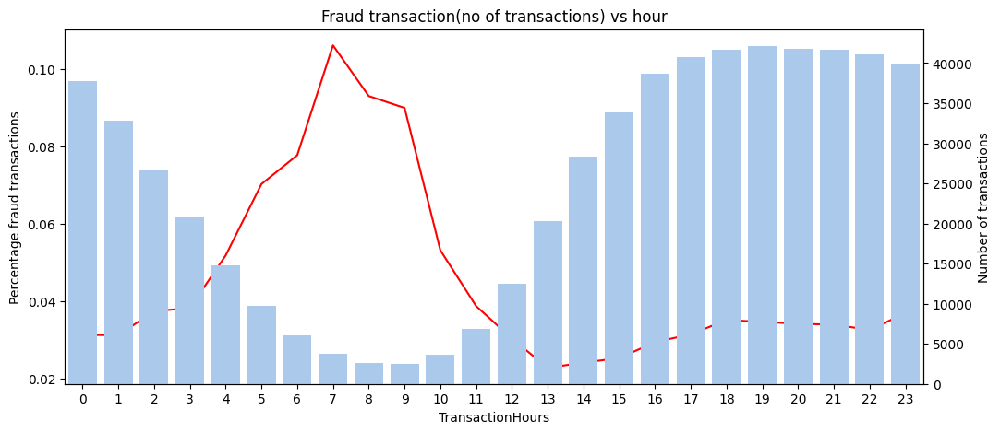

In [59]:
fig, axes = plt.subplots(figsize=(12,5))
axes = sns.lineplot(x=percentage_fraud_by_hour['TransactionHours'],y=percentage_fraud_by_hour['Percentage fraud transactions'],color='r')
axes2 = axes.twinx()
axes2 = sns.barplot(x=percentage_fraud_by_hour['TransactionHours'],y=percentage_fraud_by_hour['Number of transactions'])
axes.set_title('Fraud transaction(no of transactions) vs hour')
plt.show() 

**Comment:**
* The relationship between the hour with total number of transactions and the percentage of fraudulent transactions is exactly inverse. The larger the number of transactions in an hour the lesser is the fraud percentage of that hour and the lesser the total number of transactions the higher is the fraud percentage.
* Hour 7 have the highest fraud percentage 

### Transaction DaysOfWeek

In [56]:
df_train['DayofWeek'] = (df_train['TransactionDT']//(60*60*24)-1)%7
df_test['DayofWeek'] = (df_test['TransactionDT']//(60*60*24)-1)%7

day_percentage_fraud = df_train[['isFraud','DayofWeek']].groupby(by=['DayofWeek']).mean().reset_index() \
            .rename(columns={'isFraud':'Percentage fraud transactions'})
day_count_fraud = df_train[['TransactionID','DayofWeek']].groupby(by=['DayofWeek']).count().reset_index() \
            .rename(columns={'TransactionID':'Number of transactions'})
day_fraud = day_percentage_fraud.merge(day_count_fraud,on=['DayofWeek'])

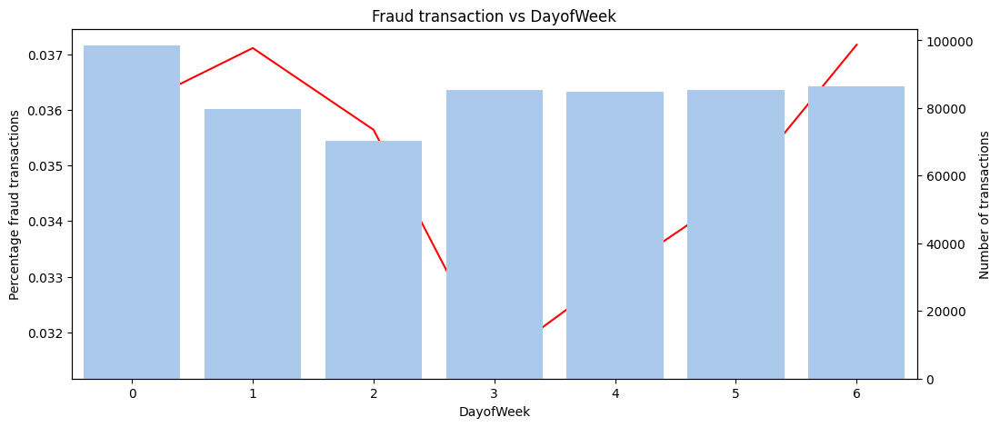

In [57]:
fig, axes = plt.subplots(figsize=(12,5))
axes = sns.lineplot(x=day_fraud['DayofWeek'],y=day_fraud['Percentage fraud transactions'],color='r')
axes2 = axes.twinx()
axes2 = sns.barplot(x=day_fraud['DayofWeek'],y=day_fraud['Number of transactions'])
axes.set_title('Fraud transaction vs DayofWeek')
plt.show()

**Comment:**
* WeekofDay feature does not seem to be very useful in deciding the Transaction Status since the percentage of fraudulent and non-fraudulent transactions for each of the 60 minutes is almost same. 
* Day 3 of Week has the lowest percentage fraud detections. 

### Dollars and Cents Feature

In [58]:
train_amt_whole = [int(str(a).split('.')[0]) for a in df_train['TransactionAmt'].values]
train_amt_decimal = [int(str(a).split('.')[1]) for a in df_train['TransactionAmt'].values]

test_amt_whole = [int(str(a).split('.')[0]) for a in df_test['TransactionAmt'].values]
test_amt_decimal = [int(str(a).split('.')[1]) for a in df_test['TransactionAmt'].values]

df_train['dollars'] = train_amt_whole
df_train['cents'] = train_amt_decimal

df_test['dollars'] = test_amt_whole
df_test['cents'] = test_amt_decimal

### AmountLog

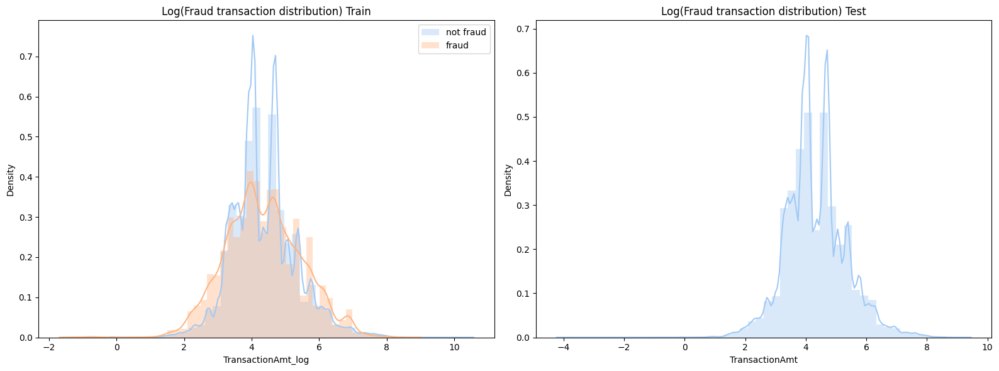

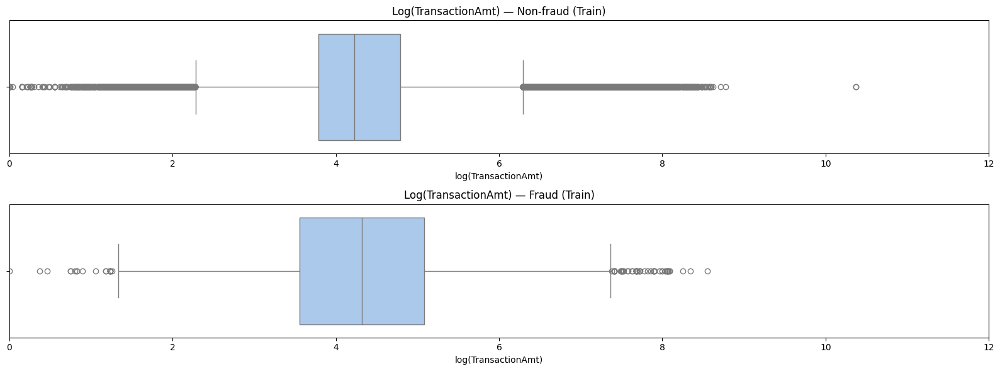

Mean transaction amt for fraud is 4.3506 ie, 77.5264 dollars
Mean transaction amt for non-fraud is 4.3643 ie, 78.5978 dollars
Median transaction amt for fraud is 4.3175  ie, 75.0000 dollars
Median transaction amt for non-fraud is 4.2268  ie, 68.5000 dollars


In [59]:
train_fraud = df_train[df_train['isFraud'] == 1].copy()
train_nonfraud = df_train[df_train['isFraud'] == 0].copy()

# Log-transform using clip to avoid log(0) or negatives; adjust threshold if needed
EPS = 1e-6
train_fraud['TransactionAmt_log'] = np.log(train_fraud['TransactionAmt'].clip(lower=EPS))
train_nonfraud['TransactionAmt_log'] = np.log(train_nonfraud['TransactionAmt'].clip(lower=EPS))
test_amt_log = np.log(df_test['TransactionAmt'].clip(lower=EPS))

# Optionally drop any remaining non-finite values
train_fraud = train_fraud[np.isfinite(train_fraud['TransactionAmt_log'])]
train_nonfraud = train_nonfraud[np.isfinite(train_nonfraud['TransactionAmt_log'])]
test_amt_log = test_amt_log[np.isfinite(test_amt_log)]

# --- Distribution plots (Train vs Test) ---
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Train distributions
sns.distplot(train_nonfraud['TransactionAmt_log'],ax=axes[0],label='not fraud')
sns.distplot(train_fraud['TransactionAmt_log'],ax=axes[0],label='fraud')
axes[0].title.set_text('Log(Fraud transaction distribution) Train')
axes[0].legend()

sns.distplot(test_amt_log,ax=axes[1])
axes[1].title.set_text('Log(Fraud transaction distribution) Test')

plt.tight_layout()
plt.show()

# --- Boxplots (Train) ---
fig1, axes1 = plt.subplots(2, 1, figsize=(16, 6))

sns.boxplot(x=train_nonfraud['TransactionAmt_log'], ax=axes1[0])
axes1[0].set_title('Log(TransactionAmt) — Non-fraud (Train)')
axes1[0].set_xlim(0, 12)
axes1[0].set_xlabel('log(TransactionAmt)')

sns.boxplot(x=train_fraud['TransactionAmt_log'], ax=axes1[1])
axes1[1].set_title('Log(TransactionAmt) — Fraud (Train)')
axes1[1].set_xlim(0, 12)
axes1[1].set_xlabel('log(TransactionAmt)')

plt.tight_layout()
plt.show()


print('Mean transaction amt for fraud is {:.4f} ie, {:.4f} dollars'.format(train_fraud['TransactionAmt_log'].mean(),np.exp(train_fraud['TransactionAmt_log'].mean())))
print('Mean transaction amt for non-fraud is {:.4f} ie, {:.4f} dollars'.format(train_nonfraud['TransactionAmt_log'].mean(),np.exp(train_nonfraud['TransactionAmt_log'].mean())))

print('Median transaction amt for fraud is {:.4f}  ie, {:.4f} dollars'.format(train_fraud['TransactionAmt_log'].median(),np.exp(train_fraud['TransactionAmt_log'].median())))
print('Median transaction amt for non-fraud is {:.4f}  ie, {:.4f} dollars'.format(train_nonfraud['TransactionAmt_log'].median(),np.exp(train_nonfraud['TransactionAmt_log'].median())))


In [60]:
df_train['TransactionAmt_log'] = np.log(df_train['TransactionAmt'].clip(lower=EPS))
df_test['TransactionAmt_log'] = np.log(df_test['TransactionAmt'].clip(lower=EPS)) 

### P_email and R_email Parent Domain 

In [61]:
parent_domain = {'gmail.com':'gmail', 'outlook.com':'microsoft', 
                 'yahoo.com':'yahoo', 'mail.com':'mail', 'anonymous.com':'anonymous', 
                 'hotmail.com':'microsoft', 'verizon.net':'verizon', 'aol.com':'aol', 
                 'me.com':'apple', 'comcast.net':'comcast', 'optonline.net':'optimum', 
                 'cox.net':'cox', 'charter.net':'spectrum', 'rocketmail.com':'yahoo', 
                 'prodigy.net.mx':'AT&T', 'embarqmail.com':'century_link', 'icloud.com':'apple', 
                 'live.com.mx':'microsoft', 'gmail':'gmail', 'live.com':'microsoft', 
                 'att.net':'AT&T', 'juno.com':'juno', 'ymail.com':'yahoo', 
                 'sbcglobal.net':'sbcglobal', 'bellsouth.net':'AT&T', 'msn.com':'microsoft', 
                 'q.com':'century_link','yahoo.com.mx':'yahoo', 'centurylink.net':'century_link',  
                 'servicios-ta.com':'asur','earthlink.net':'earthlink', 'hotmail.es':'microsoft', 
                 'cfl.rr.com':'spectrum', 'roadrunner.com':'spectrum','netzero.net':'netzero', 
                 'gmx.de':'gmx','suddenlink.net':'suddenlink','frontiernet.net':'frontier', 
                 'windstream.net':'windstream','frontier.com':'frontier','outlook.es':'microsoft', 
                 'mac.com':'apple','netzero.com':'netzero','aim.com':'aol', 
                 'web.de':'web_de','twc.com':'whois','cableone.net':'sparklight', 
                 'yahoo.fr':'yahoo','yahoo.de':'yahoo','yahoo.es':'yahoo', 'scranton.edu':'scranton', 
                 'sc.rr.com':'sc_rr','ptd.net':'ptd','live.fr':'microsoft', 
                 'yahoo.co.uk':'yahoo','hotmail.fr':'microsoft','hotmail.de':'microsoft', 
                 'hotmail.co.uk':'microsoft','protonmail.com':'protonmail','yahoo.co.jp':'yahoo'}

In [62]:
df_train['P_parent_domain'] = [np.nan if pd.isna(domain) else parent_domain[domain] for domain in df_train['P_emaildomain']] 
df_test['P_parent_domain'] = [np.nan if pd.isna(domain) else parent_domain[domain] for domain in df_test['P_emaildomain']]

In [63]:
df_train['P_parent_domain']

0               NaN
1             gmail
2         microsoft
3             yahoo
4             gmail
            ...    
590535          NaN
590536        gmail
590537        gmail
590538          aol
590539        gmail
Name: P_parent_domain, Length: 590540, dtype: object

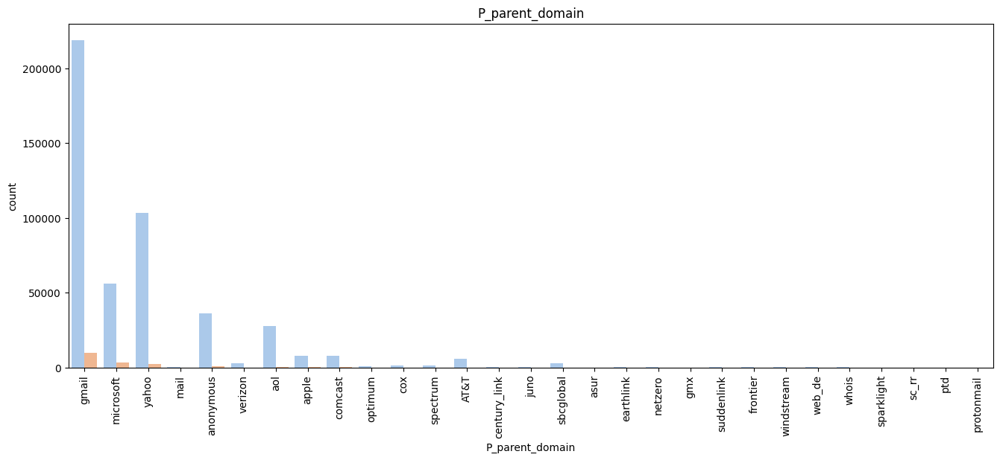

In [76]:
# P_parent_domain
fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(16,6))
sns.countplot(data=df_train, x='P_parent_domain',hue='isFraud', ax=axes)
axes.title.set_text('P_parent_domain')
axes.legend([],[], frameon=False) 
axes.set_xticklabels(axes.get_xticklabels(),rotation=90)
plt.show()

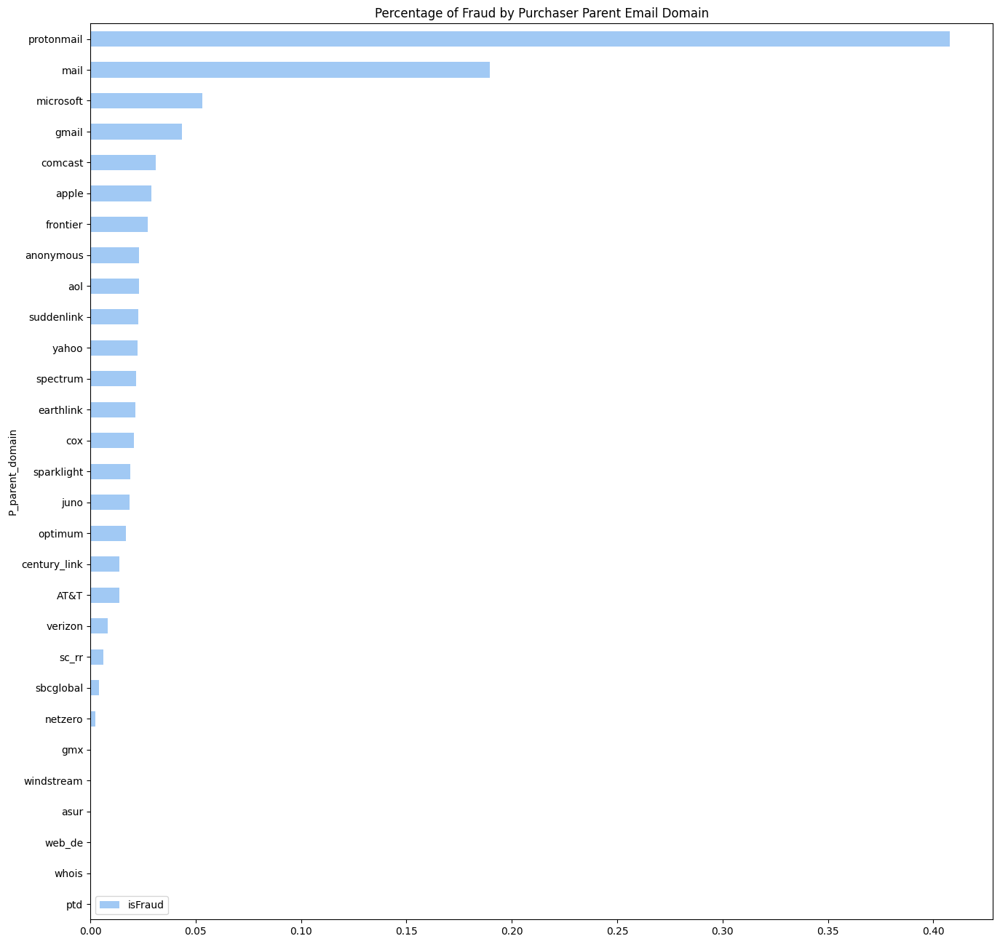

In [77]:
df_train[['P_parent_domain','isFraud']].groupby(by=['P_parent_domain'])  \
    .mean() \
    .sort_values(by=['isFraud']).plot(kind='barh',
            figsize=(16, 16),
            title='Percentage of Fraud by Purchaser Parent Email Domain') 
plt.show()

In [64]:
df_train['R_parent_domain'] = [np.nan if pd.isna(domain) else parent_domain[domain] for domain in df_train['R_emaildomain']] 
df_test['R_parent_domain'] = [np.nan if pd.isna(domain) else parent_domain[domain] for domain in df_test['R_emaildomain']]

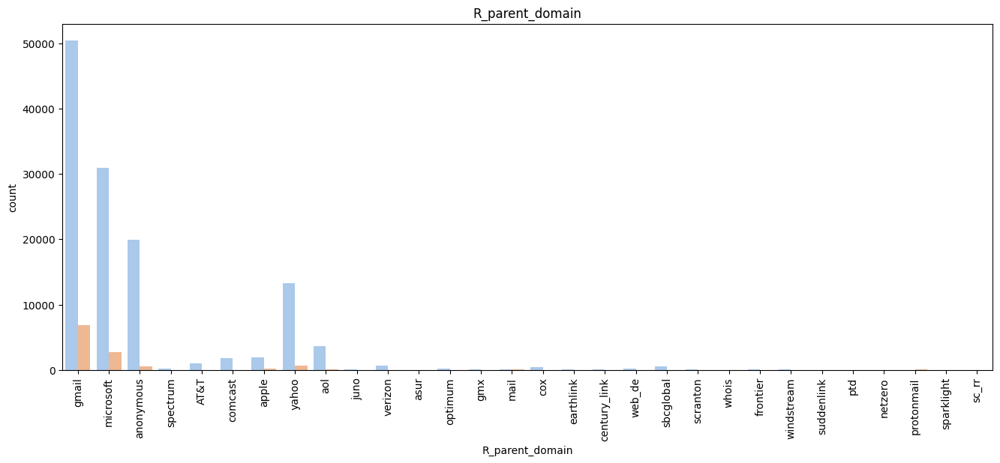

In [79]:
# P_parent_domain
fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(16,6))
sns.countplot(data=df_train, x='R_parent_domain',hue='isFraud', ax=axes)
axes.title.set_text('R_parent_domain')
axes.legend([],[], frameon=False) 
axes.set_xticklabels(axes.get_xticklabels(),rotation=90)
plt.show()

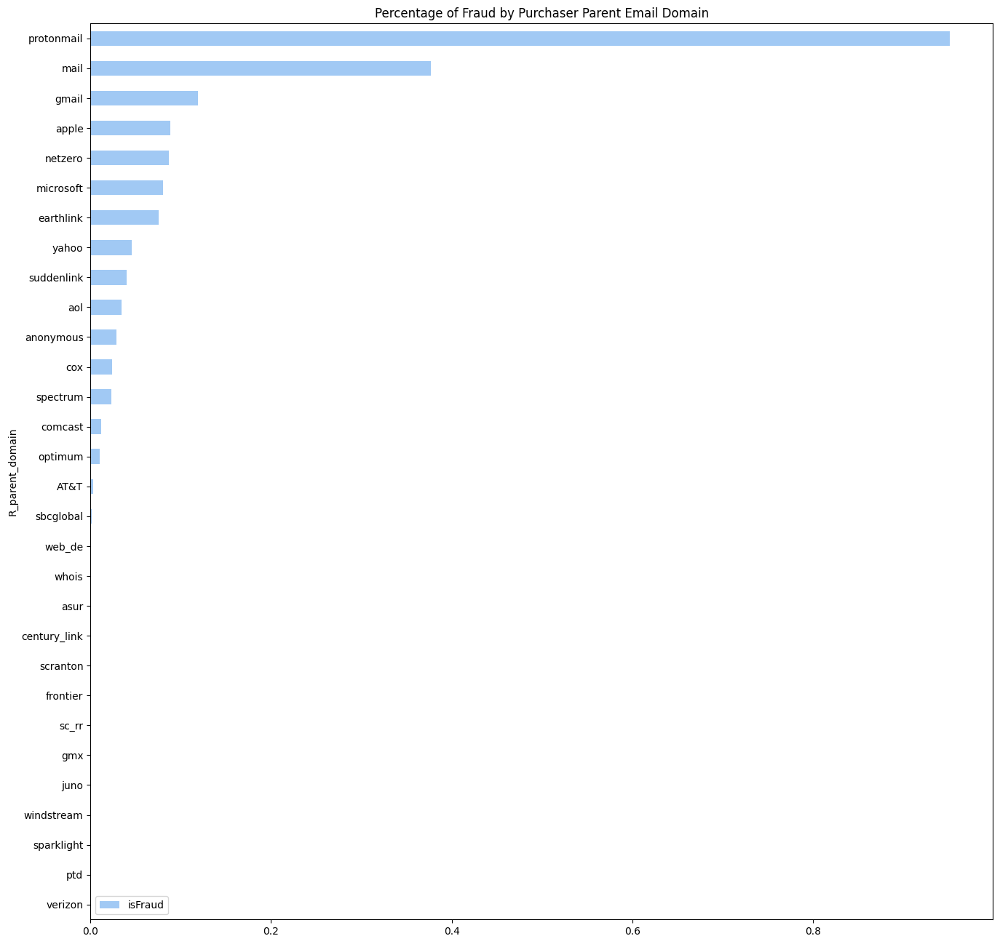

In [80]:
df_train[['R_parent_domain','isFraud']].groupby(by=['R_parent_domain'])  \
    .mean() \
    .sort_values(by=['isFraud']).plot(kind='barh',
            figsize=(16, 16),
            title='Percentage of Fraud by Purchaser Parent Email Domain') 
plt.show()

### Device Parent Company 

In [65]:
def parent_device_name(df):

  if(df['device_name'].isna().all()):
        return df
    
  df.loc[df['device_name'].str.contains('SM', na=False), 'device_name'] = 'Samsung'
  df.loc[df['device_name'].str.contains('SAMSUNG', na=False), 'device_name'] = 'Samsung'
  df.loc[df['device_name'].str.contains('GT-', na=False), 'device_name'] = 'Samsung'
  df.loc[df['device_name'].str.contains('Moto G', na=False), 'device_name'] = 'Motorola'
  df.loc[df['device_name'].str.contains('Moto', na=False), 'device_name'] = 'Motorola'
  df.loc[df['device_name'].str.contains('moto', na=False), 'device_name'] = 'Motorola'
  df.loc[df['device_name'].str.contains('LG-', na=False), 'device_name'] = 'LG'
  df.loc[df['device_name'].str.contains('rv:', na=False), 'device_name'] = 'RV'
  df.loc[df['device_name'].str.contains('HUAWEI', na=False), 'device_name'] = 'Huawei'
  df.loc[df['device_name'].str.contains('ALE-', na=False), 'device_name'] = 'Huawei'
  df.loc[df['device_name'].str.contains('-L', na=False), 'device_name'] = 'Huawei'
  df.loc[df['device_name'].str.contains('Blade', na=False), 'device_name'] = 'ZTE'
  df.loc[df['device_name'].str.contains('BLADE', na=False), 'device_name'] = 'ZTE'
  df.loc[df['device_name'].str.contains('Linux', na=False), 'device_name'] = 'Linux'
  df.loc[df['device_name'].str.contains('XT', na=False), 'device_name'] = 'Sony'
  df.loc[df['device_name'].str.contains('HTC', na=False), 'device_name'] = 'HTC'
  df.loc[df['device_name'].str.contains('ASUS', na=False), 'device_name'] = 'Asus'
  df.loc[df.device_name.isin(df.device_name.value_counts()[df.device_name.value_counts() < 200].index), 'device_name'] = "Others"

  return df

In [66]:
df_train['device_name'] = [np.nan if pd.isna(v) else v.split('/')[0] for v in df_train['DeviceInfo'].values]
df_test['device_name'] = [np.nan if pd.isna(v) else v.split('/')[0] for v in df_test['DeviceInfo'].values]


df_train = parent_device_name(df_train)
df_test = parent_device_name(df_test) 

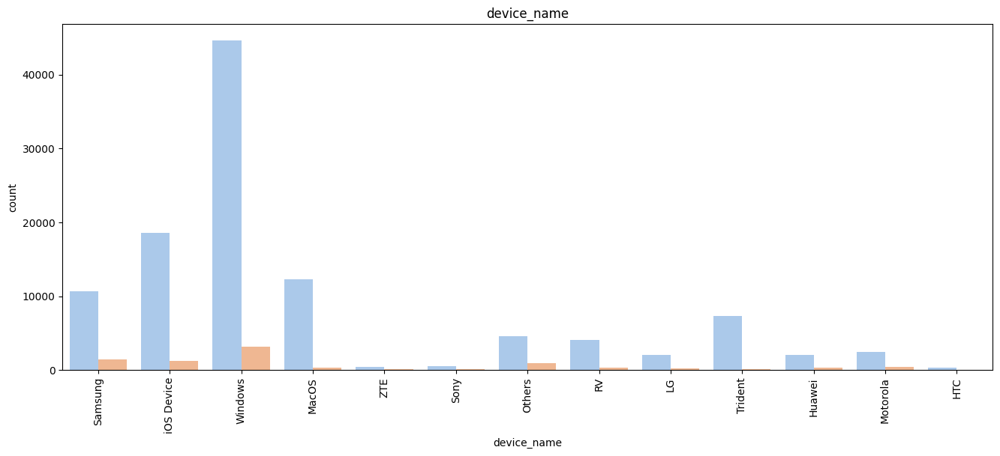

In [83]:
# P_parent_domain
fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(16,6))
sns.countplot(data=df_train, x='device_name',hue='isFraud', ax=axes)
axes.title.set_text('device_name')
axes.legend([],[], frameon=False) 
axes.set_xticklabels(axes.get_xticklabels(),rotation=90)
plt.show()

### OSName and OS Version Features

In [67]:
df_train['os_name'] = [info if (pd.isna(info)) or (len(info.split())<=1) else ' '.join(info.split()[:-1]) for info in df_train['id_30']]
df_test['os_name'] = [info if (pd.isna(info)) or (len(info.split())<=1) else ' '.join(info.split()[:-1]) for info in df_test['id_30']]

df_train['os_version'] = [np.nan if (pd.isna(info)) or (len(info.split())<=1) else info.split()[-1] for info in df_train['id_30']]
df_test['os_version'] = [np.nan if (pd.isna(info)) or (len(info.split())<=1) else info.split()[-1] for info in df_test['id_30']]

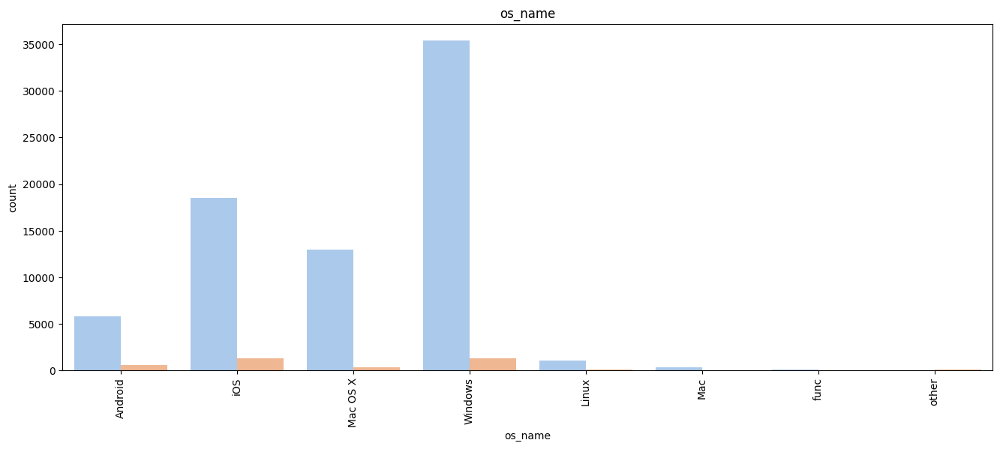

In [85]:
fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(16,6))
sns.countplot(data=df_train, x='os_name',hue='isFraud', ax=axes)
axes.title.set_text('os_name')
axes.legend([],[], frameon=False) 
axes.set_xticklabels(axes.get_xticklabels(),rotation=90)
plt.show()

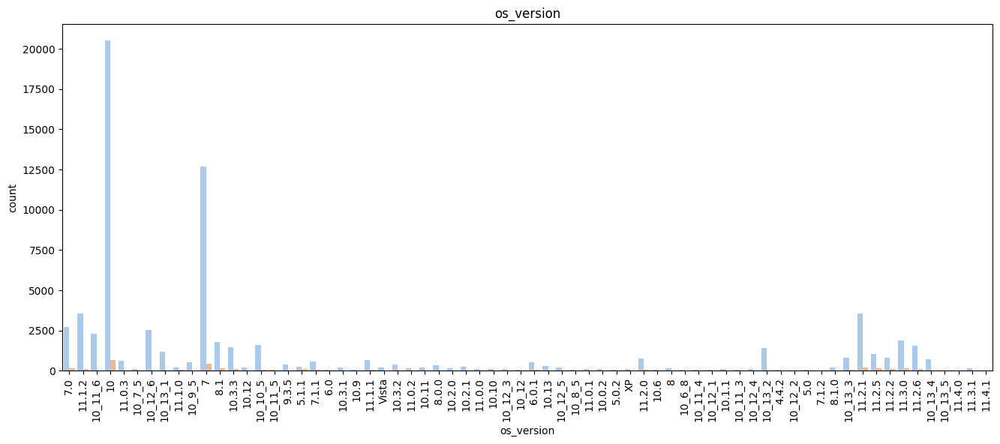

In [86]:
fig, axes = plt.subplots(nrows=1, ncols=1,figsize=(16,6))
sns.countplot(data=df_train, x='os_version',hue='isFraud', ax=axes)
axes.title.set_text('os_version')
axes.legend([],[], frameon=False) 
axes.set_xticklabels(axes.get_xticklabels(),rotation=90)
plt.show()

### D_cols Normalization 
- D_features corresponds to timedeltas like the number of days elapsed since the card began or the number of days since the first transaction etc.

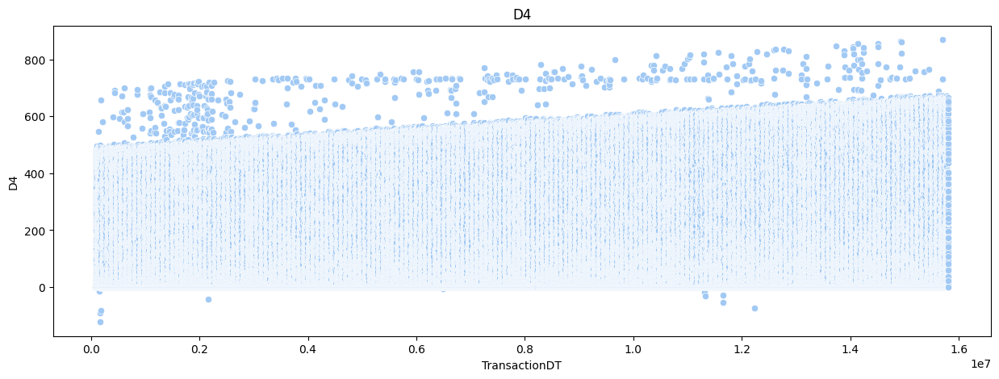

In [87]:
plt.figure(figsize=(15,5))
sns.scatterplot(x='TransactionDT', y='D4', data=df_train)
plt.title('D4')
plt.show()



**Comment: **
1. D_features are increasing with time and it is quite obvious since each of the feature is timdelta which will definitly increase with time.
2. It would be much better if we have exact day instead of number of days elapsed and to get this info we can simply subtract TransactionDay from each of the D_features.

In [68]:
d_features = ["D"+str(i) for i in range(1,16) if "D"+str(i) in df_train.columns]

for f in d_features:
    df_train[f] =  df_train[f] - df_train.TransactionDT/np.float32(24*60*60)
    df_test[f] = df_test[f] - df_test.TransactionDT/np.float32(24*60*60)

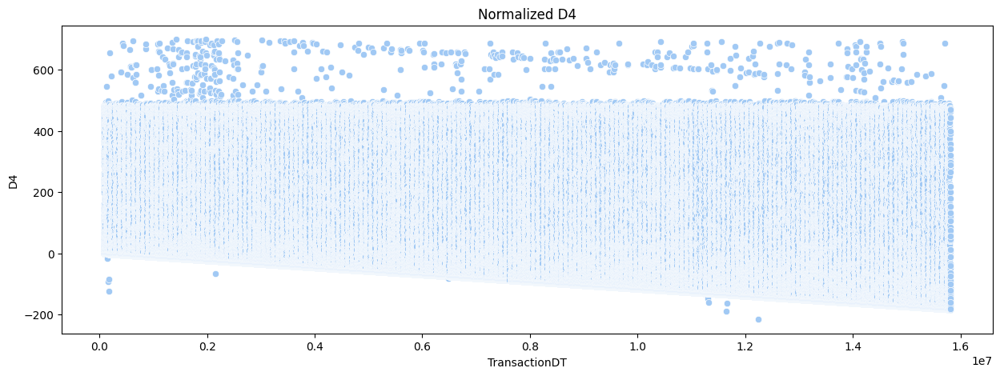

In [89]:
plt.figure(figsize=(15,5))
sns.scatterplot(x='TransactionDT', y='D4', data=df_train)
plt.title('Normalized D4')
plt.show()

### Identifying User (UID)

Based on the information given by the competition host, once a credit card is marked as fraud, it is not used again and hence we can say it in other words that once a Card Holder is marked as Fraud, it is no longer allowed to make any transactions using the same card. Hence, our actual objective is not to predict the Fraudulent Transactions instead our task is to predict the Fraudulent Clients.

In [69]:
df_train['uid1'] = df_train['card1'].astype(str)+df_train['card2'].astype(str)+\
                     df_train['card3'].astype(str)+df_train['card5'].astype(str)+\
                     df_train['card6'].astype(str)+df_train['addr1'].astype(str)+\
                     df_train['P_emaildomain'].astype(str)
df_train['uid2'] = df_train['card1'].astype(str)+df_train['addr1'].astype(str)+\
                     df_train['P_emaildomain'].astype(str)

df_train['uid3'] = df_train['card1'].astype(str)+ df_train['addr1'].astype(str) + np.floor(df_train['Day'] - df_train['D1']).astype(str)


df_test['uid1'] = df_test['card1'].astype(str)+df_test['card2'].astype(str)+\
                     df_test['card3'].astype(str)+df_test['card5'].astype(str)+\
                     df_test['card6'].astype(str)+df_test['addr1'].astype(str)+\
                     df_test['P_emaildomain'].astype(str)
df_test['uid2'] = df_test['card1'].astype(str)+df_test['addr1'].astype(str)+\
                     df_test['P_emaildomain'].astype(str)

df_test['uid3'] = df_test['card1'].astype(str)+ df_test['addr1'].astype(str) + np.floor(df_test['Day'] - df_test['D1']).astype(str)
                     

### Evaluation 

In [70]:
df_train.shape, df_test.shape

((590540, 239), (506691, 238))

In [71]:
X_train_fe = df_train.sort_values('TransactionDT').drop(['isFraud', 'TransactionDT', 'TransactionID'], axis=1)
y_train_fe = df_train.sort_values('TransactionDT')['isFraud']
X_test_fe = df_test.sort_values('TransactionDT').drop(['TransactionDT', 'TransactionID'], axis=1)

print(X_train_fe.shape)
print(X_test_fe.shape)

(590540, 236)
(506691, 236)


In [72]:
X_train_fe = clean_inf_nan(X_train_fe)
X_test_fe = clean_inf_nan(X_test_fe)

print(X_train_fe.shape)
print(X_test_fe.shape)

(590540, 236)
(506691, 236)


In [73]:
idx_train = X_train_fe.index[:int(X_train_fe.shape[0]*0.75)]  
idx_validation = X_train_fe.index[int(X_train_fe.shape[0]*0.75):]

x_train2,y_train2 = X_train_fe.iloc[idx_train],y_train_fe.iloc[idx_train]
x_cv2,y_cv2 = X_train_fe.iloc[idx_validation],y_train_fe.iloc[idx_validation]

In [74]:
num_cols = X_train_fe.select_dtypes(exclude=object).columns.tolist()
cat_cols = X_train_fe.select_dtypes(include=object).columns.tolist()

# Replace OneHotEncoder with OrdinalEncoder (basically LabelEncoding per column)
numeric_transformer_fe = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median")),
    ("scaler", MinMaxScaler()),
])

# categorical pipeline (ordinal encoding)
categorical_transformer_fe = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),
    ("ordinal", OrdinalEncoder(
        handle_unknown="use_encoded_value", 
        unknown_value=-1,
    ))
])

preprocessor_fe = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, num_cols),
        ("cat", categorical_transformer, cat_cols)
    ]
)

In [96]:
print(num_cols)
print(cat_cols)

['TransactionAmt', 'card1', 'card2', 'card3', 'card5', 'addr1', 'addr2', 'dist1', 'dist2', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15', 'V1', 'V3', 'V4', 'V6', 'V8', 'V11', 'V13', 'V14', 'V17', 'V20', 'V23', 'V26', 'V27', 'V30', 'V36', 'V37', 'V40', 'V41', 'V44', 'V47', 'V48', 'V54', 'V55', 'V56', 'V59', 'V62', 'V65', 'V67', 'V68', 'V70', 'V76', 'V78', 'V80', 'V82', 'V86', 'V88', 'V89', 'V91', 'V96', 'V98', 'V99', 'V104', 'V107', 'V108', 'V111', 'V115', 'V117', 'V120', 'V121', 'V123', 'V124', 'V127', 'V129', 'V130', 'V136', 'V138', 'V139', 'V142', 'V147', 'V156', 'V160', 'V162', 'V165', 'V166', 'V169', 'V171', 'V173', 'V175', 'V176', 'V178', 'V180', 'V182', 'V185', 'V187', 'V188', 'V198', 'V203', 'V205', 'V207', 'V209', 'V210', 'V215', 'V218', 'V220', 'V221', 'V223', 'V224', 'V226', 'V228', 'V229', 'V234', 'V235', 'V238', 'V240', 'V250', 'V252', 'V

In [75]:
preprocessor_fe

preprocessor_fe.fit(x_train2)

x_train2 = preprocessor_fe.transform(x_train2)
x_cv2 = preprocessor_fe.transform(x_cv2)
X_test_fe= preprocessor_fe.transform(X_test_fe)

In [76]:
clf = XGBClassifier(
    n_estimators=700,
    max_depth=12, 
    learning_rate=0.02, 
    subsample=0.8,
    colsample_bytree=0.4, 
    missing=-1, 
    eval_metric='auc',
    tree_method='hist',
)

model_xgb = clf.fit(
    x_train2, y_train2,
    eval_set=[(x_cv2, y_cv2)],
    verbose=50,
)

[0]	validation_0-auc:0.82251
[50]	validation_0-auc:0.89249
[100]	validation_0-auc:0.90584
[150]	validation_0-auc:0.91358
[200]	validation_0-auc:0.91900
[250]	validation_0-auc:0.92319
[300]	validation_0-auc:0.92526
[350]	validation_0-auc:0.92660
[400]	validation_0-auc:0.92807
[450]	validation_0-auc:0.92943
[500]	validation_0-auc:0.92984
[550]	validation_0-auc:0.93025
[600]	validation_0-auc:0.93064
[650]	validation_0-auc:0.93064
[699]	validation_0-auc:0.93081


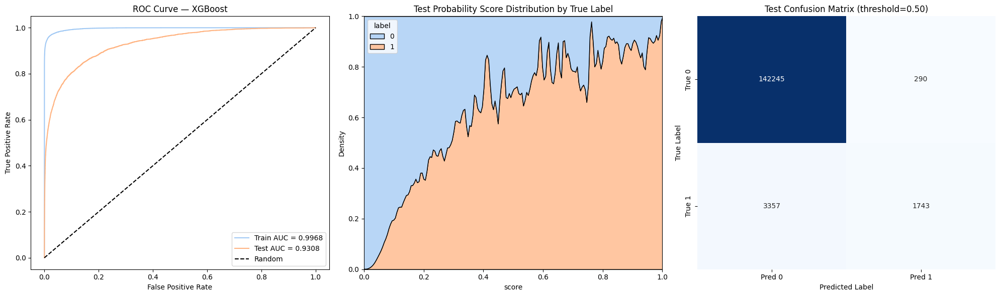

In [99]:
plot_train_test_roc_and_score(y_train2,model_xgb.predict_proba(x_train2)[:,1],y_cv2,model_xgb.predict_proba(x_cv2)[:,1],model_name="XGBoost")

In [100]:
save_submission(X_test_fe,model_xgb, 'XGBoost_FE')

In [101]:
model_lgb = LGBMClassifier(
    n_estimators=1000,
    learning_rate=0.02,
    max_depth=12,
    subsample=0.8,
    colsample_bytree=0.4,
)
model_lgb.fit(x_train2,y_train2)

[LightGBM] [Info] Number of positive: 15563, number of negative: 427342
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.059844 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 21568
[LightGBM] [Info] Number of data points in the train set: 442905, number of used features: 230
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035138 -> initscore=-3.312688
[LightGBM] [Info] Start training from score -3.312688


LGBMClassifier(colsample_bytree=0.4, learning_rate=0.02, max_depth=12,
               n_estimators=1000, subsample=0.8)

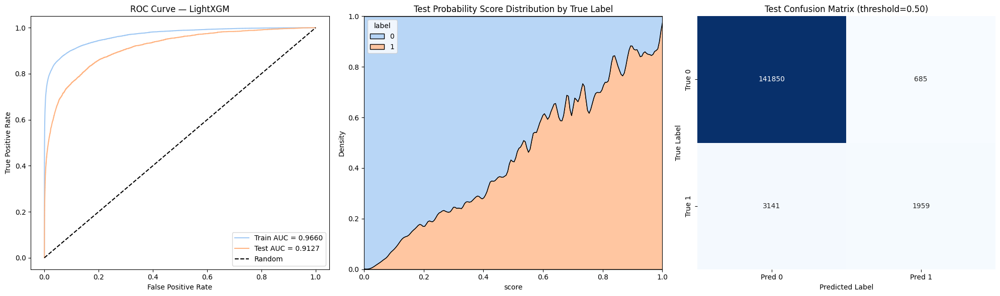

In [102]:
plot_train_test_roc_and_score(y_train2,model_lgb.predict_proba(x_train2)[:,1],y_cv2,model_lgb.predict_proba(x_cv2)[:,1],model_name="LightXGM")

In [183]:
save_submission(X_test_fe,model_lgb, 'LightXGM_FE')

## Experiemnt 3 SMOTE 

In [103]:
x_train3,y_train3 = x_train2,y_train2 
x_cv3,y_cv3 = x_cv2,y_cv2

In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.metrics import roc_auc_score, classification_report


# 1. Apply SMOTE only on training set
smote = SMOTE(sampling_strategy=0.3, random_state=42)
x_train3, y_train3 = smote.fit_resample(x_train3, y_train3)

print("After SMOTE:", y_train3.value_counts())


Before SMOTE: isFraud
0    427342
1    128202
Name: count, dtype: int64
After SMOTE: isFraud
0    427342
1    128202
Name: count, dtype: int64


In [ ]:
xgb_model = XGBClassifier(
    n_estimators=500,
    learning_rate=0.02,
    max_depth=6,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    n_jobs=-1,
    use_label_encoder=False,
    eval_metric="auc"   
)

xgb_model.fit(x_train3, y_train3, eval_set=[(x_cv3, y_cv3)], verbose=50)

[0]	validation_0-auc:0.78381
[50]	validation_0-auc:0.83033
[100]	validation_0-auc:0.84064
[150]	validation_0-auc:0.85319
[200]	validation_0-auc:0.85922
[250]	validation_0-auc:0.86361
[300]	validation_0-auc:0.86737
[350]	validation_0-auc:0.87047
[400]	validation_0-auc:0.87307
[450]	validation_0-auc:0.87517
[499]	validation_0-auc:0.87731


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='auc', feature_types=None,
              feature_weights=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.02, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=6,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=500,
              n_jobs=-1, num_parallel_tree=None, ...)

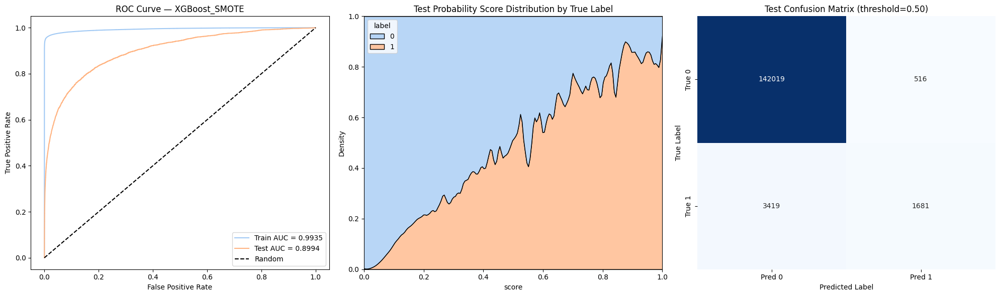

In [109]:
plot_train_test_roc_and_score(y_train3,xgb_model.predict_proba(x_train3)[:,1],y_cv3,xgb_model.predict_proba(x_cv3)[:,1],model_name="XGBoost_SMOTE")

**Comment : OverSampling dont help improve the model**

## Experiment 4 : Cross Validation on Months

In [77]:
X_train = df_train.sort_values('TransactionDT').drop(['isFraud', 'TransactionDT', 'TransactionID'], axis=1)
y_train = df_train.sort_values('TransactionDT')['isFraud']
X_test = df_test.sort_values('TransactionDT').drop(['TransactionDT', 'TransactionID'], axis=1)

print(X_train.shape)
print(X_test.shape) 

(590540, 236)
(506691, 236)


In [78]:
X_train['TransactionMonth'] 

0         0
1         0
2         0
3         0
4         0
         ..
590535    6
590536    6
590537    6
590538    6
590539    6
Name: TransactionMonth, Length: 590540, dtype: int64

In [79]:
feature_cols = [c for c in X_train.columns if c != 'TransactionMonth']
num_cols = [c for c in feature_cols if X_train[c].dtype != 'object']
cat_cols = [c for c in feature_cols if X_train[c].dtype == 'object']

numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median")),
    ("scaler", MinMaxScaler()),
])

# categorical pipeline (ordinal encoding)
categorical_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),
    ("ordinal", OrdinalEncoder(
        handle_unknown="use_encoded_value", 
        unknown_value=-1,
    ))
])

preprocessor= ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, num_cols),
        ("cat", categorical_transformer, cat_cols)
    ]
)

preprocessor


ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('scaler', MinMaxScaler())]),
                                 ['TransactionAmt', 'card1', 'card2', 'card3',
                                  'card5', 'addr1', 'addr2', 'dist1', 'dist2',
                                  'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7',
                                  'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14',
                                  'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', ...]),
                                ('cat',
                                 Pipeline(steps=[(...
                                                  SimpleImputer(strategy='most_frequent')),
                                                 ('ordinal',
                                                  OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                 unknown_value=-1))]),
                                 ['ProductCD', 'card4', 'card6',
                                  'P_emaildomain', 'R_emaildomain', 'M1', 'M2',
                                  'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9',
                                  'id_12', 'id_15', 'id_16', 'id_23', 'id_27',
                                  'id_28', 'id_29', 'id_30', 'id_31', 'id_33',
                                  'id_34', 'id_35', 'id_36', 'id_37', 'id_38',
                                  'DeviceType', ...])])

In [81]:
from sklearn.model_selection import GroupKFold
import gc
groups = X_train['TransactionMonth'].to_numpy()            # 1-D groups
n_splits = min(6, np.unique(groups).size)
gkf = GroupKFold(n_splits=n_splits)


oof = np.zeros(len(X_train)) 
tpred = np.zeros(len(X_test)) 
fold_aucs = []

best_auc = -1.0
best_fold = None
best_idx_tr = None
best_idx_va = None
best_val_months = None

for fold, (idx_tr, idx_va) in enumerate(gkf.split(X_train, y_train, groups), 1):
    val_months = np.unique(groups[idx_va])
    print(f"\n===== Fold {fold} | Val months {val_months.tolist()} =====")

    X_tr = X_train.iloc[idx_tr][feature_cols].copy()
    y_tr = y_train.iloc[idx_tr].copy()
    X_va = X_train.iloc[idx_va][feature_cols].copy()
    y_va = y_train.iloc[idx_va].copy()
    X_te = X_test[feature_cols].copy()

    # fit preprocessor on TRAIN fold only
    preprocessor.fit(X_tr)
    X_tr_p = preprocessor.transform(X_tr)
    X_va_p = preprocessor.transform(X_va)
    X_te_p = preprocessor.transform(X_te)


    clf = XGBClassifier(
        n_estimators=5000,
        learning_rate=0.02,      # rely on early stopping instead of lr=0.002
        max_depth=8,
        min_child_weight=5,
        subsample=0.8,
        colsample_bytree=0.6,
        reg_lambda=2.0,
        tree_method='hist',  # 'hist' if CPU
        eval_metric=['auc','auc'],
        random_state=42,
    )

    clf.fit(
        X_tr_p, y_tr,
        eval_set=[(X_va_p, y_va)],
        verbose=250
    )

    oof[idx_va] = clf.predict_proba(X_va_p)[:, 1] 
    tpred += clf.predict_proba(X_te_p)[:, 1] / n_splits 
    auc = roc_auc_score(y_va, oof[idx_va]) 
    fold_aucs.append(auc) 
    print(f"Fold AUC: {auc:.4f}")

    if auc > best_auc:
        best_auc = auc
        best_fold = fold
        best_idx_tr = idx_tr
        best_idx_va = idx_va
        best_val_months = val_months.tolist()

    del clf, X_tr_p, X_va_p, X_te_p 
    gc.collect()

print("\n############################")
print("OOF ROC-AUC:", roc_auc_score(y_train, oof))
print("Fold AUCs:  ", [f"{a:.4f}" for a in fold_aucs])
print(f"Best fold: {best_fold} | Val months: {best_val_months} | AUC: {best_auc:.4f}")



===== Fold 1 | Val months [0] =====
[0]	validation_0-auc:0.79290
[250]	validation_0-auc:0.87833
[500]	validation_0-auc:0.89358
[750]	validation_0-auc:0.90033
[1000]	validation_0-auc:0.90408
[1250]	validation_0-auc:0.90702
[1500]	validation_0-auc:0.90916
[1750]	validation_0-auc:0.91124
[2000]	validation_0-auc:0.91245
[2250]	validation_0-auc:0.91382
[2500]	validation_0-auc:0.91397
[2750]	validation_0-auc:0.91385
[3000]	validation_0-auc:0.91371
[3250]	validation_0-auc:0.91373
[3500]	validation_0-auc:0.91317
[3750]	validation_0-auc:0.91237
[4000]	validation_0-auc:0.91194
[4250]	validation_0-auc:0.91181
[4500]	validation_0-auc:0.91144
[4750]	validation_0-auc:0.91120
[4999]	validation_0-auc:0.91087
Fold AUC: 0.9109

===== Fold 2 | Val months [3] =====
[0]	validation_0-auc:0.79935
[250]	validation_0-auc:0.90821
[500]	validation_0-auc:0.91846
[750]	validation_0-auc:0.92432
[1000]	validation_0-auc:0.92801
[1250]	validation_0-auc:0.93046
[1500]	validation_0-auc:0.93210
[1750]	validation_0-auc:0

In [82]:
sample_submission = pd.read_csv('datasets/sample_submission.csv')
sample_submission.isFraud = tpred
sample_submission.to_csv('submissions/submission_group_kfold.csv',index=False)

# 6. Hypermeter Tunning

In [83]:
import optuna
from optuna import Trial
from optuna.samplers import TPESampler
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.metrics import make_scorer, roc_auc_score

In [84]:
TIMEOUT_S  = 7200  # 2 hour
N_TRIALS   = 10_000  # timeout will stop earlier

def objective(trial):


    params = {
        "n_estimators": 5000,
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.12, log=True),
        "max_depth": trial.suggest_int("max_depth", 5, 15),
        "min_child_weight": trial.suggest_float("min_child_weight", 2.0, 16.0),
        "subsample": trial.suggest_float("subsample", 0.4, 0.99),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.4, 0.99),
        "gamma": trial.suggest_float("gamma", 0.0, 1.0),
        "reg_lambda": trial.suggest_float("reg_lambda", 0.5, 8.0, log=True),
        "reg_alpha": trial.suggest_float("reg_alpha", 0.0, 1.0),
        "tree_method": "hist",   # stay cool on CPU; switch later if you want
        "eval_metric": "auc",
        "n_jobs": 5,           # keep it light; raise if you want
    }

    gkf = GroupKFold(n_splits=n_splits)
    oof = np.zeros(len(X_train), dtype=float)

    for idx_tr, idx_va in gkf.split(X_train, y_train, groups):
        # leak-safe preprocessing

        X_tr = X_train.iloc[idx_tr][feature_cols].copy()
        y_tr = y_train.iloc[idx_tr].copy()
        X_va = X_train.iloc[idx_va][feature_cols].copy()
        y_va = y_train.iloc[idx_va].copy()
        X_te = X_test[feature_cols].copy()

    # fit preprocessor on TRAIN fold only
        preprocessor.fit(X_tr)
        X_tr_p = preprocessor.transform(X_tr)
        X_va_p = preprocessor.transform(X_va)
        X_te_p = preprocessor.transform(X_te)

        clf = XGBClassifier(**params)
        clf.fit(X_tr_p, y_tr,eval_set=[(X_va_p, y_va)], verbose=250)   #

        oof[idx_va] = clf.predict_proba(X_va_p)[:, 1]

        del clf, X_tr_p, X_va_p
        gc.collect()

    return roc_auc_score(y_train, oof)


In [85]:
study = optuna.create_study(direction="maximize", sampler=TPESampler(seed=42))
study.optimize(objective, timeout=TIMEOUT_S, n_trials=N_TRIALS, gc_after_trial=True)

print("Best OOF AUC:", study.best_value)
print("Best params:", study.best_params)

[I 2025-09-08 22:26:57,651] A new study created in memory with name: no-name-90276408-cf22-499a-881b-ead5e6f0fa46


[0]	validation_0-auc:0.78336
[250]	validation_0-auc:0.89944
[500]	validation_0-auc:0.90994
[750]	validation_0-auc:0.91391
[1000]	validation_0-auc:0.91491
[1250]	validation_0-auc:0.91508
[1500]	validation_0-auc:0.91566
[1750]	validation_0-auc:0.91529
[2000]	validation_0-auc:0.91463
[2250]	validation_0-auc:0.91439
[2500]	validation_0-auc:0.91398
[2750]	validation_0-auc:0.91349
[3000]	validation_0-auc:0.91281
[3250]	validation_0-auc:0.91236
[3500]	validation_0-auc:0.91193
[3750]	validation_0-auc:0.91195
[4000]	validation_0-auc:0.91182
[4250]	validation_0-auc:0.91153
[4500]	validation_0-auc:0.91141
[4750]	validation_0-auc:0.91126
[4999]	validation_0-auc:0.91106
[0]	validation_0-auc:0.84118
[250]	validation_0-auc:0.92557
[500]	validation_0-auc:0.93184
[750]	validation_0-auc:0.93527
[1000]	validation_0-auc:0.93597
[1250]	validation_0-auc:0.93634
[1500]	validation_0-auc:0.93622
[1750]	validation_0-auc:0.93644
[2000]	validation_0-auc:0.93621
[2250]	validation_0-auc:0.93599
[2500]	validation_0-

[I 2025-09-08 23:03:34,707] Trial 0 finished with value: 0.9372839697481157 and parameters: {'learning_rate': 0.02536276934555763, 'max_depth': 15, 'min_child_weight': 12.247915185359671, 'subsample': 0.7532085056762516, 'colsample_bytree': 0.49205099786103756, 'gamma': 0.15599452033620265, 'reg_lambda': 0.5873671345397129, 'reg_alpha': 0.8661761457749352}. Best is trial 0 with value: 0.9372839697481157.


[0]	validation_0-auc:0.82205
[250]	validation_0-auc:0.90584
[500]	validation_0-auc:0.91138
[750]	validation_0-auc:0.90892
[1000]	validation_0-auc:0.90828
[1250]	validation_0-auc:0.90902
[1500]	validation_0-auc:0.90935
[1750]	validation_0-auc:0.90944
[2000]	validation_0-auc:0.90938
[2250]	validation_0-auc:0.90920
[2500]	validation_0-auc:0.90922
[2750]	validation_0-auc:0.90920
[3000]	validation_0-auc:0.90903
[3250]	validation_0-auc:0.90934
[3500]	validation_0-auc:0.90938
[3750]	validation_0-auc:0.90940
[4000]	validation_0-auc:0.90947
[4250]	validation_0-auc:0.90954
[4500]	validation_0-auc:0.90948
[4750]	validation_0-auc:0.90945
[4999]	validation_0-auc:0.90945
[0]	validation_0-auc:0.83794
[250]	validation_0-auc:0.93382
[500]	validation_0-auc:0.93569
[750]	validation_0-auc:0.93486
[1000]	validation_0-auc:0.93425
[1250]	validation_0-auc:0.93394
[1500]	validation_0-auc:0.93394
[1750]	validation_0-auc:0.93412
[2000]	validation_0-auc:0.93413
[2250]	validation_0-auc:0.93403
[2500]	validation_0-

[I 2025-09-08 23:24:49,908] Trial 1 finished with value: 0.937648057336359 and parameters: {'learning_rate': 0.04453608604723946, 'max_depth': 12, 'min_child_weight': 2.2881829201412343, 'subsample': 0.9722468127755767, 'colsample_bytree': 0.8911411580722488, 'gamma': 0.21233911067827616, 'reg_lambda': 0.8277688526305597, 'reg_alpha': 0.18340450985343382}. Best is trial 1 with value: 0.937648057336359.


[0]	validation_0-auc:0.81135
[250]	validation_0-auc:0.88534
[500]	validation_0-auc:0.89925
[750]	validation_0-auc:0.90488
[1000]	validation_0-auc:0.90879
[1250]	validation_0-auc:0.90945
[1500]	validation_0-auc:0.91053
[1750]	validation_0-auc:0.91119
[2000]	validation_0-auc:0.91118
[2250]	validation_0-auc:0.91134
[2500]	validation_0-auc:0.91044
[2750]	validation_0-auc:0.91056
[3000]	validation_0-auc:0.91003
[3250]	validation_0-auc:0.91007
[3500]	validation_0-auc:0.90976
[3750]	validation_0-auc:0.90944
[4000]	validation_0-auc:0.90974
[4250]	validation_0-auc:0.90978
[4500]	validation_0-auc:0.90977
[4750]	validation_0-auc:0.90904
[4999]	validation_0-auc:0.90860
[0]	validation_0-auc:0.83416
[250]	validation_0-auc:0.91584
[500]	validation_0-auc:0.92487
[750]	validation_0-auc:0.92917
[1000]	validation_0-auc:0.93175
[1250]	validation_0-auc:0.93327
[1500]	validation_0-auc:0.93393
[1750]	validation_0-auc:0.93407
[2000]	validation_0-auc:0.93418
[2250]	validation_0-auc:0.93396
[2500]	validation_0-

[I 2025-09-08 23:54:51,691] Trial 2 finished with value: 0.9348113188394702 and parameters: {'learning_rate': 0.021297691055101788, 'max_depth': 10, 'min_child_weight': 8.04723026098962, 'subsample': 0.5718251927168447, 'colsample_bytree': 0.7609932078862038, 'gamma': 0.13949386065204183, 'reg_lambda': 1.123950574040989, 'reg_alpha': 0.3663618432936917}. Best is trial 1 with value: 0.937648057336359.


[0]	validation_0-auc:0.81321
[250]	validation_0-auc:0.90290
[500]	validation_0-auc:0.91096
[750]	validation_0-auc:0.91146
[1000]	validation_0-auc:0.91171
[1250]	validation_0-auc:0.91067
[1500]	validation_0-auc:0.91104
[1750]	validation_0-auc:0.91088
[2000]	validation_0-auc:0.91115
[2250]	validation_0-auc:0.91123
[2500]	validation_0-auc:0.91143
[2750]	validation_0-auc:0.91128
[3000]	validation_0-auc:0.91080
[3250]	validation_0-auc:0.91101
[3500]	validation_0-auc:0.91079
[3750]	validation_0-auc:0.91039
[4000]	validation_0-auc:0.91025
[4250]	validation_0-auc:0.91014
[4500]	validation_0-auc:0.90984
[4750]	validation_0-auc:0.90969
[4999]	validation_0-auc:0.90971
[0]	validation_0-auc:0.84570
[250]	validation_0-auc:0.92913
[500]	validation_0-auc:0.93333
[750]	validation_0-auc:0.93507
[1000]	validation_0-auc:0.93545
[1250]	validation_0-auc:0.93479
[1500]	validation_0-auc:0.93431
[1750]	validation_0-auc:0.93444
[2000]	validation_0-auc:0.93390
[2250]	validation_0-auc:0.93346
[2500]	validation_0-

[I 2025-09-09 00:35:38,914] Trial 3 finished with value: 0.9360036936732961 and parameters: {'learning_rate': 0.03105862133382476, 'max_depth': 13, 'min_child_weight': 4.7954329502170365, 'subsample': 0.7033983186640309, 'colsample_bytree': 0.7495245956286051, 'gamma': 0.046450412719997725, 'reg_lambda': 2.6948022473899034, 'reg_alpha': 0.17052412368729153}. Best is trial 1 with value: 0.937648057336359.


Best OOF AUC: 0.937648057336359
Best params: {'learning_rate': 0.04453608604723946, 'max_depth': 12, 'min_child_weight': 2.2881829201412343, 'subsample': 0.9722468127755767, 'colsample_bytree': 0.8911411580722488, 'gamma': 0.21233911067827616, 'reg_lambda': 0.8277688526305597, 'reg_alpha': 0.18340450985343382}


In [86]:
best_xgb_params = study.best_params

In [88]:
groups = X_train['TransactionMonth'].to_numpy()            # 1-D groups
n_splits = min(6, np.unique(groups).size)
gkf = GroupKFold(n_splits=n_splits)


oof = np.zeros(len(X_train)) 
tpred = np.zeros(len(X_test)) 
fold_aucs = []

best_auc = -1.0
best_fold = None
best_idx_tr = None
best_idx_va = None
best_val_months = None

for fold, (idx_tr, idx_va) in enumerate(gkf.split(X_train, y_train, groups), 1):
    val_months = np.unique(groups[idx_va])
    print(f"\n===== Fold {fold} | Val months {val_months.tolist()} =====")

    X_tr = X_train.iloc[idx_tr][feature_cols].copy()
    y_tr = y_train.iloc[idx_tr].copy()
    X_va = X_train.iloc[idx_va][feature_cols].copy()
    y_va = y_train.iloc[idx_va].copy()
    X_te = X_test[feature_cols].copy()

    # fit preprocessor on TRAIN fold only
    preprocessor.fit(X_tr)
    X_tr_p = preprocessor.transform(X_tr)
    X_va_p = preprocessor.transform(X_va)
    X_te_p = preprocessor.transform(X_te)


    clf = XGBClassifier(**best_xgb_params, eval_metric='auc', tree_method='hist',n_estimators=5000)

    clf.fit(
        X_tr_p, y_tr,
        eval_set=[(X_va_p, y_va)],
        verbose=250
    )

    oof[idx_va] = clf.predict_proba(X_va_p)[:, 1] 
    tpred += clf.predict_proba(X_te_p)[:, 1] / n_splits 
    auc = roc_auc_score(y_va, oof[idx_va]) 
    fold_aucs.append(auc) 
    print(f"Fold AUC: {auc:.4f}")

    if auc > best_auc:
        best_auc = auc
        best_fold = fold
        best_idx_tr = idx_tr
        best_idx_va = idx_va
        best_val_months = val_months.tolist()

    del clf, X_tr_p, X_va_p, X_te_p 
    gc.collect()

print("\n############################")
print("OOF ROC-AUC:", roc_auc_score(y_train, oof))
print("Fold AUCs:  ", [f"{a:.4f}" for a in fold_aucs])
print(f"Best fold: {best_fold} | Val months: {best_val_months} | AUC: {best_auc:.4f}")


===== Fold 1 | Val months [0] =====
[0]	validation_0-auc:0.82205
[250]	validation_0-auc:0.90584
[500]	validation_0-auc:0.91138
[750]	validation_0-auc:0.90892
[1000]	validation_0-auc:0.90828
[1250]	validation_0-auc:0.90902
[1500]	validation_0-auc:0.90935
[1750]	validation_0-auc:0.90944
[2000]	validation_0-auc:0.90938
[2250]	validation_0-auc:0.90920
[2500]	validation_0-auc:0.90922
[2750]	validation_0-auc:0.90920
[3000]	validation_0-auc:0.90903
[3250]	validation_0-auc:0.90934
[3500]	validation_0-auc:0.90938
[3750]	validation_0-auc:0.90940
[4000]	validation_0-auc:0.90947
[4250]	validation_0-auc:0.90954
[4500]	validation_0-auc:0.90948
[4750]	validation_0-auc:0.90945
[4999]	validation_0-auc:0.90945
Fold AUC: 0.9094

===== Fold 2 | Val months [3] =====
[0]	validation_0-auc:0.83794
[250]	validation_0-auc:0.93382
[500]	validation_0-auc:0.93569
[750]	validation_0-auc:0.93486
[1000]	validation_0-auc:0.93425
[1250]	validation_0-auc:0.93394
[1500]	validation_0-auc:0.93394
[1750]	validation_0-auc:0

In [89]:
sample_submission = pd.read_csv('datasets/sample_submission.csv')
sample_submission.isFraud = tpred
sample_submission.to_csv('submissions/submission_cv2.csv',index=False)

**Comment :**
- Public Score :  0.939674
- Private Score : 0.905536

In [92]:
# Extract best-fold splits
X_tr_best = X_train.iloc[best_idx_tr][feature_cols].copy()
y_tr_best = y_train.iloc[best_idx_tr].copy()
X_va_best = X_train.iloc[best_idx_va][feature_cols].copy()
y_va_best = y_train.iloc[best_idx_va].copy()
X_te_best = X_test[feature_cols].copy()

# Fit preprocessor on TRAIN of the best fold only
preprocessor.fit(X_tr_best)
X_trb_p = preprocessor.transform(X_tr_best)
X_vab_p = preprocessor.transform(X_va_best)
X_teb_p = preprocessor.transform(X_te_best)

# Train a fresh model on the best fold
clf_best = XGBClassifier(**best_xgb_params, eval_metric='auc', tree_method='hist', random_state=42, n_estimators=5000)
clf_best.fit(
    X_trb_p, y_tr_best,
    eval_set=[(X_vab_p, y_va_best)],
    verbose=250, # optional but recommended
)

# Validation performance on the best fold
va_pred_best = clf_best.predict_proba(X_vab_p)[:, 1]
best_fold_auc_check = roc_auc_score(y_va_best, va_pred_best)
print(f"\n[Best fold #{best_fold}] AUC (retrained): {best_fold_auc_check:.4f}")

# Test predictions using ONLY the best fold model
tpred_bestfold = clf_best.predict_proba(X_teb_p)[:, 1]

[0]	validation_0-auc:0.83727
[250]	validation_0-auc:0.95029
[500]	validation_0-auc:0.95460
[750]	validation_0-auc:0.95576
[1000]	validation_0-auc:0.95586
[1250]	validation_0-auc:0.95604
[1500]	validation_0-auc:0.95611
[1750]	validation_0-auc:0.95620
[2000]	validation_0-auc:0.95626
[2250]	validation_0-auc:0.95632
[2500]	validation_0-auc:0.95625
[2750]	validation_0-auc:0.95643
[3000]	validation_0-auc:0.95638
[3250]	validation_0-auc:0.95637
[3500]	validation_0-auc:0.95635
[3750]	validation_0-auc:0.95636
[4000]	validation_0-auc:0.95635
[4250]	validation_0-auc:0.95631
[4500]	validation_0-auc:0.95627
[4750]	validation_0-auc:0.95628
[4999]	validation_0-auc:0.95627

[Best fold #6] AUC (retrained): 0.9563


In [93]:
sample_submission = pd.read_csv('datasets/sample_submission.csv')
sample_submission.isFraud = tpred_bestfold
sample_submission.to_csv('submissions/submission_best_fold.csv',index=False)

**Comment :**
- Public Score :  0.934162
- Private Score : 0.900523

In [94]:
def make_expanding_folds(groups, min_train_groups=4, val_groups=1, gap_groups=0):
    """
    Build expanding-window folds aligned to group boundaries.
    Example with min_train_groups=4, val_groups=1, gap_groups=0:
      train: 0 1 2 3 | val: 4
      train: 0 1 2 3 4 | val: 5
      train: 0 1 2 3 4 5 | val: 6
    """
    months = np.array(sorted(np.unique(groups)))
    folds = []
    # start at index = min_train_groups (0-based), ensure room for val_groups
    for i in range(min_train_groups, len(months) - val_groups + 1):
        # optional gap (embargo) between train and val to avoid leakage
        train_end = i - gap_groups
        if train_end <= 0:
            continue
        train_months = months[:train_end]
        val_months = months[i:i + val_groups]

        idx_tr = np.flatnonzero(np.isin(groups, train_months))
        idx_va = np.flatnonzero(np.isin(groups, val_months))

        if len(idx_tr) == 0 or len(idx_va) == 0:
            continue
        folds.append((idx_tr, idx_va, train_months.tolist(), val_months.tolist()))
    return folds

In [ ]:
# --- Build folds like "0 1 2 3 | 4", "0..4 | 5", "0..5 | 6" ---
folds = make_expanding_folds(groups, min_train_groups=4, val_groups=1, gap_groups=0)
print("Folds:", [(tr[-1] if tr else None, va[0]) for *_ , tr, va in [(None, f[2], f[3]) for f in folds]])

# --- Run CV ---
oof = np.zeros(len(X_train))
tpred = np.zeros(len(X_test))
fold_aucs = []

best_auc = -1.0
best_fold = None
best_idx_tr = None
best_idx_va = None
best_val_months = None

n_splits = len(folds)
for fold, (idx_tr, idx_va, tr_months, va_months) in enumerate(folds, 1):
    print(f"\n===== Fold {fold} | Train months {tr_months} | Val months {va_months} =====")

    X_tr = X_train.iloc[idx_tr][feature_cols].copy()
    y_tr = y_train.iloc[idx_tr].copy()
    X_va = X_train.iloc[idx_va][feature_cols].copy()
    y_va = y_train.iloc[idx_va].copy()
    X_te = X_test[feature_cols].copy()

    # Fit preprocessor ONLY on the training side of this fold
    preprocessor.fit(X_tr)
    X_tr_p = preprocessor.transform(X_tr)
    X_va_p = preprocessor.transform(X_va)
    X_te_p = preprocessor.transform(X_te)

    clf = XGBClassifier(**best_xgb_params, eval_metric='auc', tree_method='hist', random_state=42, n_estimators=5000)
    clf.fit(
        X_tr_p, y_tr,
        eval_set=[(X_va_p, y_va)],
        verbose=250,
    )

    oof[idx_va] = clf.predict_proba(X_va_p)[:, 1]
    tpred += clf.predict_proba(X_te_p)[:, 1] / n_splits

    auc = roc_auc_score(y_va, oof[idx_va])
    fold_aucs.append(auc)
    print(f"Fold AUC: {auc:.4f}")

    if auc > best_auc:
        best_auc = auc
        best_fold = fold
        best_idx_tr = idx_tr
        best_idx_va = idx_va
        best_val_months = va_months

    del clf, X_tr_p, X_va_p, X_te_p
    gc.collect()

print("\n############################")
print("OOF ROC-AUC:", roc_auc_score(y_train, oof))
print("Fold AUCs:  ", [f"{a:.4f}" for a in fold_aucs])
print(f"Best fold: {best_fold} | Val months: {best_val_months} | AUC: {best_auc:.4f}")

Folds: [(3, 4), (4, 5), (5, 6)]

===== Fold 1 | Train months [0, 1, 2, 3] | Val months [4] =====
[0]	validation_0-auc:0.83446
[250]	validation_0-auc:0.93710
[500]	validation_0-auc:0.94088
[750]	validation_0-auc:0.94114
[1000]	validation_0-auc:0.94102
[1250]	validation_0-auc:0.94068
[1500]	validation_0-auc:0.94058
[1750]	validation_0-auc:0.94073
[2000]	validation_0-auc:0.94058
[2250]	validation_0-auc:0.94053
[2500]	validation_0-auc:0.94049
[2750]	validation_0-auc:0.94052
[3000]	validation_0-auc:0.94050
[3250]	validation_0-auc:0.94052
[3500]	validation_0-auc:0.94047
[3750]	validation_0-auc:0.94045
[4000]	validation_0-auc:0.94045
[4250]	validation_0-auc:0.94041
[4500]	validation_0-auc:0.94041
[4750]	validation_0-auc:0.94036
[4999]	validation_0-auc:0.94037
Fold AUC: 0.9404

===== Fold 2 | Train months [0, 1, 2, 3, 4] | Val months [5] =====
[0]	validation_0-auc:0.83864
[250]	validation_0-auc:0.93322
[500]	validation_0-auc:0.93314
[750]	validation_0-auc:0.93192
[1000]	validation_0-auc:0.9311

In [101]:
sample_submission = pd.read_csv('datasets/sample_submission.csv')
sample_submission.isFraud = tpred
sample_submission.to_csv('submissions/submission_final_fin.csv',index=False)

**Comment :**
- Public Score : 0.936434 
- Private Score : 0.907350 


In [99]:
# --- 1) Pick the validation month ---
val_month = 6
uniq_months = np.unique(groups)
assert val_month in uniq_months, f"val_month {val_month} not found in groups: {uniq_months}"

idx_va = np.flatnonzero(groups == val_month)
idx_tr = np.flatnonzero(groups != val_month)

print(f"Train months: {sorted(set(uniq_months) - {val_month})}")
print(f"Val month:    {val_month}")
print(f"Train size: {len(idx_tr):,} | Val size: {len(idx_va):,}")

# --- 2) Split data ---
X_tr = X_train.iloc[idx_tr][feature_cols].copy()
y_tr = y_train.iloc[idx_tr].copy()
X_va = X_train.iloc[idx_va][feature_cols].copy()
y_va = y_train.iloc[idx_va].copy()
X_te = X_test[feature_cols].copy()

# --- 3) Fit preprocessor ONLY on TRAIN (months != 6) ---
preprocessor.fit(X_tr)
X_tr_p = preprocessor.transform(X_tr)
X_va_p = preprocessor.transform(X_va)
X_te_p = preprocessor.transform(X_te)

# --- 4) Train with early stopping on month 6 as validation ---
clf = XGBClassifier(**best_xgb_params, eval_metric='auc', tree_method='hist', random_state=42, n_estimators=5000)
clf.fit(
    X_tr_p, y_tr,
    eval_set=[(X_va_p, y_va)],
    verbose=250,
)

# --- 5) Validation metric & predictions ---
va_pred = clf.predict_proba(X_va_p)[:, 1]
val_auc = roc_auc_score(y_va, va_pred)
print(f"\nHoldout (month {val_month}) AUC: {val_auc:.4f}")

# If you maintain an OOF vector:
oof = np.zeros(len(X_train))
oof[idx_va] = va_pred
print("OOF AUC (only month 6 filled):", roc_auc_score(y_train.iloc[idx_va], oof[idx_va]))

# --- 6) Test predictions from this single model ---
tpred_val6_model = clf.predict_proba(X_te_p)[:, 1]

Train months: [np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5)]
Val month:    6
Train size: 582,429 | Val size: 8,111
[0]	validation_0-auc:0.83978
[250]	validation_0-auc:0.96046
[500]	validation_0-auc:0.96575
[750]	validation_0-auc:0.96463
[1000]	validation_0-auc:0.96552
[1250]	validation_0-auc:0.96465
[1500]	validation_0-auc:0.96427
[1750]	validation_0-auc:0.96419
[2000]	validation_0-auc:0.96411
[2250]	validation_0-auc:0.96405
[2500]	validation_0-auc:0.96407
[2750]	validation_0-auc:0.96408
[3000]	validation_0-auc:0.96422
[3250]	validation_0-auc:0.96420
[3500]	validation_0-auc:0.96417
[3750]	validation_0-auc:0.96425
[4000]	validation_0-auc:0.96437
[4250]	validation_0-auc:0.96426
[4500]	validation_0-auc:0.96415
[4750]	validation_0-auc:0.96417
[4999]	validation_0-auc:0.96411

Holdout (month 6) AUC: 0.9641
OOF AUC (only month 6 filled): 0.9641075975022658


In [100]:
sample_submission = pd.read_csv('datasets/sample_submission.csv')
sample_submission.isFraud = tpred_val6_model
sample_submission.to_csv('submissions/submission_val6.csv',index=False)

**Comment :**
- Public Score : 0.934253
- Private Score :  0.902843

In [103]:
from joblib import dump
import os 

In [104]:
ARTIFACT_DIR = 'artifacts'
os.makedirs(ARTIFACT_DIR, exist_ok=True) 

preproc_path = f"{ARTIFACT_DIR}/preprocessor.joblib"
dump(preprocessor, preproc_path, compress=("xz", 3))
print("Saved preprocessor:", preproc_path)

Saved preprocessor: artifacts/preprocessor.joblib


In [105]:
model_joblib_path = f"{ARTIFACT_DIR}/model.joblib"
dump(clf, model_joblib_path, compress=("xz", 3))
print("Saved classifier (joblib):", model_joblib_path) 

Saved classifier (joblib): artifacts/model.joblib


In [14]:
df_train  

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.50,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.00,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.00,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.00,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.00,H,4497,514.0,150.0,mastercard,102.0,...,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590535,3577535,0,15811047,49.00,W,6550,NaN,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590536,3577536,0,15811049,39.50,W,10444,225.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590537,3577537,0,15811079,30.95,W,12037,595.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590538,3577538,0,15811088,117.00,W,7826,481.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [16]:
is_fraud_data = df_train[df_train['isFraud'] == 1]
is_fraud_data 

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
203,2987203,1,89760,445.000,W,18268,583.0,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
240,2987240,1,90193,37.098,C,13413,103.0,185.0,visa,137.0,...,chrome 54.0 for android,NaN,NaN,NaN,F,F,T,T,mobile,Redmi Note 4 Build/MMB29M
243,2987243,1,90246,37.098,C,13413,103.0,185.0,visa,137.0,...,chrome 54.0 for android,NaN,NaN,NaN,F,F,T,T,mobile,Redmi Note 4 Build/MMB29M
245,2987245,1,90295,37.098,C,13413,103.0,185.0,visa,137.0,...,chrome 54.0 for android,NaN,NaN,NaN,F,F,T,T,mobile,Redmi Note 4 Build/MMB29M
288,2987288,1,90986,155.521,C,16578,545.0,185.0,visa,226.0,...,chrome 62.0 for ios,NaN,NaN,NaN,F,F,F,F,mobile,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590361,3577361,1,15807368,1224.000,W,3278,453.0,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590364,3577364,1,15807516,69.964,C,5812,408.0,185.0,mastercard,224.0,...,samsung browser 6.4,NaN,NaN,NaN,F,F,T,F,mobile,SAMSUNG SM-J700M Build/MMB29K
590368,3577368,1,15807677,100.000,H,6758,399.0,150.0,american express,146.0,...,mobile safari 11.0,32.0,2208x1242,match_status:1,T,F,F,T,mobile,iOS Device
590372,3577372,1,15807758,117.000,W,14037,111.0,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
sample_applications = is_fraud_data.sample(n=3, random_state=42) 
sample_applications.drop(columns=['isFraud','TransactionID'], inplace=True)
sample_applications.to_csv('fraud_test_samples.csv', index=False)